---
pagetitle: "ML-4-proj | VG"
title: "Home Credit Default Risk Modeling"
subtitle:  "Data Analysis Project"
author:    "Vilmantas Gėgžna"
date: 2023-12-27
date-modified: today
date-format: iso
language:
  title-block-modified: "Updated"
fig-align: center
jupyter: python3
format:
  html:
    embed-resources: true
    crossrefs-hover: true
    toc: true
    toc_float: true
    toc-location: left
    toc-depth: 4
    number-sections: true
    number-depth: 3
    code-tools: true
    code-fold: show # possible options: false, true, show
    code-line-numbers: true
    html-math-method: mathjax
    link-external-icon: true
    link-external-newwindow: true
    link-external-filter: "(?ds-project|--proj)"
    page-layout: full
crossref:
  chapters: true
  fig-title: 'Fig.'    # (default is "Figure")
  tbl-title: Table     # (default is "Table")
  title-delim: .       # (default is ":")
editor: # VS Code
  render-on-save: false
---

::: {.content-hidden when-format="html"}

<br><br><br><br><br>

<center>

> **IMPORTANT**
>   
> This Jupyter notebook contains the `source code` of the analysis.  
> The analysis is intended to be studied from its rendered HTML document.   
> Please, **open the HTML** file, which is available at:  
>  
> ►►► <https://gegznav.github.io/ds-projects/home-credit> ◄◄◄
> &nbsp;  &nbsp;   
>
> ```
> •▲•  
> ```

</center>
<br><br><br><br><br><br><br>

:::

<style>
#title-block-header.quarto-title-block.default .quarto-title-meta {
  display: grid;
  grid-template-columns: repeat(3, 1fr);
}

div.sourceCode {
  margin: 0;
}

/* R code indicator */
pre.sourceCode .r {
  border-left: 5px solid #7b97ea;
  border-radius: 0
}
.r .fu {font-weight: bold;}

/* Python code indicator */
pre.sourceCode .python {
  border-left: 5px solid #CFB53B;
  border-radius: 0
}
.python .kw {font-style: italic;}

/* Bash code indicator */
pre.sourceCode .bash {
  border-left: 5px solid #bbb;
  border-radius: 0
}

/* Details sections */
details[open].with-border {
  padding: 1px 5px 1px 5px;
  border-style: solid;
  border-color: grey;
  border-width: 3px;
  border-radius: 5px;
}

/* Tables */
caption, .table-caption {
  text-align: left;
  color: #5a6570;
};

table .dataframe .table-striped thead th {
  text-align: left !important;
}


</style>

::: {.content-hidden when-format="html"}

This cell contains `CSS` code.   

:::

<center>

![Home Credit Default Risk project logo. Originally generated with [Leonardo.Ai](https://leonardo.ai/).](./img/logo%20(LeonardoAI).jpg){max-width=100%, width=400px}

</center>

***

# Annotation {.unnumbered}

In this project, an extensive analysis of credit data from **Home Credit Group** was undertaken. Two distinct models were developed to predict if a loan applicant repays the loan or faces financial difficulties: one model operates independently of credit history data and another one incorporates such information. After rigorous testing, the models were successfully deployed on the Google Cloud Platform and now are available via API. Surprisingly, the results indicate only marginal improvement in model performance when historical credit data is included.

The homepage of deployed models is currently available at:  
<https://home-credit-default-prediction-sarhiiybua-ew.a.run.app/>

The examples on how to use the API are available in this [README](https://github.com/GegznaV/ds-projects/blob/main/home-credit/app/README.md) file.

# Abbreaviations {.unnumbered}

- API: application programming interface;
- AUC: area under the ROC curve;
- BAcc_01: balanced accuracy score normalized to interval [0, 1];
- BAcc: balanced accuracy score;
- EDA: exploratory data analysis;
- F1_neg: F1 score for the negative class;
- F1: F1 score (usually for the positive class);
- K: thousand;
- M: million;
- ML: machine learning;
- NPV: negative predictive value;
- PPV: positive predictive value (precision);
- ROC: receiver operating characteristic;
- SHAP: SHapley Additive exPlanations;
- TNR: true negative rate;
- TPR: true positive rate (recall).

# Plan

In this project, a dataset from Home Credit Group will be analyzed. The main **purpose** of this analysis is to investigate if significantly increases the performance of models that predict if a client, who is going to take credit, will face financial difficulties or not. For this purpose, the following **plan** will be implemented:

1) EDA on data will be performed.
2) A predictive model based on data from the `application` table (no credit history data included) will be created (the first model);
    - *assumption:* this data is always available.
3) The first model will be deployed.
4) Data from the remaining tables will be pre-processed (extracted, aggregated) and merged with the `applications` dataset.
5) The model based on all currently available data (including credit and loan history) will be created (the second model).
    - *assumption:* the data in other tables than `application` might be updated rarely, to acquire it might cost or sometimes might even be unavailable for some people who want to take a credit.
6) The second model will be deployed.

# Setup

Some preparation steps are described in the `README.md` file of the project (e.g., [here](https://github.com/GegznaV/ds-projects/blob/main/home-credit/README.md)).
The Python code that imports the necessary tools:

In [1]:
# | code-summary: "Code: **The main Python setup**"
# | code-fold: false

# Automatically reload certain modules
%reload_ext autoreload
%autoreload 1

# Plotting
%matplotlib inline

# Packages and modules -------------------------------
# Utilities
import os
import warnings
import numpy as np
import joblib

# Data frames
import pandas as pd

# EDA and plotting
import seaborn as sns
import matplotlib.pyplot as plt

import sweetviz
import klib

# Data wrangling, maths, feature engineering
import numpy as np

# Patch sklearn with Intel's version
from sklearnex import patch_sklearn

patch_sklearn()  # Run this code before importing from sklearn

# Machine learning
import lightgbm as lgb
from sklearn import set_config

from sklearn.base import clone, BaseEstimator, TransformerMixin

from sklearn.pipeline import Pipeline
from sklearn.compose import (
    ColumnTransformer,
    make_column_selector,
)
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer

from sklearn.model_selection import (
    cross_val_score,
    train_test_split,
    StratifiedKFold,
)

# ML: classification models
from lightgbm import LGBMClassifier

# ML: feature engineering and selection
from feature_engine.selection import (
    DropDuplicateFeatures,
    SmartCorrelatedSelection,
)

# ML: hyperparameter tuning
import optuna

# ML: explainability
import shap

# Display
from IPython.display import display

# Custom functions
import functions.fun_utils as my
import functions.fun_analysis as an
import functions.fun_ml as ml
from functions.utils import (
    ColumnSelector,
    CleanColumnNames,
)

%aimport functions.fun_utils
%aimport functions.fun_analysis
%aimport functions.fun_ml
%aimport functions.utils

# Settings --------------------------------------------
# Default plot options
plt.rc("figure", titleweight="bold")
plt.rc("axes", labelweight="bold", titleweight="bold")
plt.rc("font", weight="normal", size=10)
plt.rc("figure", figsize=(10, 3))

# Pandas options
pd.set_option("display.max_rows", 1000)
pd.set_option("display.max_columns", 300)
pd.set_option("display.max_colwidth", 50)  # Possible option: None
pd.set_option("display.float_format", lambda x: f"{x:.2f}")
pd.set_option("styler.format.thousands", ",")

# Turn off the scientific notation for floating point numbers.
np.set_printoptions(suppress=True)

# Scikit-learn options
set_config(transform_output="pandas")

# Analysis parameters: use Sweetviz for eda?
do_eda = True

# For caching results ---------------------------------
dir_interim = "data/interim/"
os.mkdir(dir_interim) if not os.path.exists(dir_interim) else None

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


# Data

In this project, a [dataset](https://storage.googleapis.com/341-home-credit-default/home-credit-default-risk.zip) from Home Credit Group is investigated.

The target variable `TARGET` has 2 values:

- `1` - client *with payment difficulties*: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample,
- `0` - all other cases.

In most cases, the meaning of the following values are:

- `XNA`: unknown / not available
- `XAP`: not applicable

More information on the dataset:

- Anna Montoya, Kirill Odintsov, and Martin Kotek. Home credit default risk (2018). Kaggle.   
    - <https://kaggle.com/competitions/home-credit-default-risk>
    - <https://www.kaggle.com/c/home-credit-default-risk>

The dataset was downloaded as a zip file and extracted into the `data` folder (`data/raw/` and `data/info/`directories; more details in the next section).

## Explore Data Files

In this section, the data and metadata files are explored.

The files with metadata and descriptions are stored in `data/info` directory: the files are acquired from the main source as well as from elsewhere.

Details:

In [59]:
!echo Files with data description:
!ls data/info/

Files with data description:
HomeCredit_column_descriptions.xlsx
HomeCredit_columns_description.csv
description--Home Credit Default Risk.pdf


The files with datasets are stored in `data/raw` directory. 

In [60]:
!echo Data files:
!ls data/raw/

Data files:
POS_CASH_balance.csv
application_test.csv
application_train.csv
bureau.csv
bureau_balance.csv
credit_card_balance.csv
installments_payments.csv
previous_application.csv
sample_submission.csv


In [61]:
!echo File sizes:
!cd data/raw/ &&\
   du -m * | sed 's/\([0-9]\+\)/\1 MB /'

File sizes:
375 MB 	POS_CASH_balance.csv
26 MB 	application_test.csv
159 MB 	application_train.csv
163 MB 	bureau.csv
359 MB 	bureau_balance.csv
405 MB 	credit_card_balance.csv
690 MB 	installments_payments.csv
387 MB 	previous_application.csv
1 MB 	sample_submission.csv


In [62]:
# NOTE: header line is also included here
!echo Number of lines per file:
!cd data/raw/ &&\
    wc --lines *

Number of lines per file:
  10001359 POS_CASH_balance.csv
     48745 application_test.csv
    307512 application_train.csv
   1716429 bureau.csv
  27299926 bureau_balance.csv
   3840313 credit_card_balance.csv
  13605402 installments_payments.csv
   1670215 previous_application.csv
     48745 sample_submission.csv
  58538646 total


A few top rows (formatted as table) of each file:

In [63]:
!cd data/raw/ &&\
    head -n 5 application_train.csv

SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APART

In [64]:
!cd data/raw/ &&\
    head -n 5 application_train.csv | csvlook

| SK_ID_CURR | TARGET | NAME_CONTRACT_TYPE | CODE_GENDER | FLAG_OWN_CAR | FLAG_OWN_REALTY | CNT_CHILDREN | AMT_INCOME_TOTAL |  AMT_CREDIT | AMT_ANNUITY | AMT_GOODS_PRICE | NAME_TYPE_SUITE | NAME_INCOME_TYPE | NAME_EDUCATION_TYPE           | NAME_FAMILY_STATUS   | NAME_HOUSING_TYPE | REGION_POPULATION_RELATIVE | DAYS_BIRTH | DAYS_EMPLOYED | DAYS_REGISTRATION | DAYS_ID_PUBLISH | OWN_CAR_AGE | FLAG_MOBIL | FLAG_EMP_PHONE | FLAG_WORK_PHONE | FLAG_CONT_MOBILE | FLAG_PHONE | FLAG_EMAIL | OCCUPATION_TYPE | CNT_FAM_MEMBERS | REGION_RATING_CLIENT | REGION_RATING_CLIENT_W_CITY | WEEKDAY_APPR_PROCESS_START | HOUR_APPR_PROCESS_START | REG_REGION_NOT_LIVE_REGION | REG_REGION_NOT_WORK_REGION | LIVE_REGION_NOT_WORK_REGION | REG_CITY_NOT_LIVE_CITY | REG_CITY_NOT_WORK_CITY | LIVE_CITY_NOT_WORK_CITY | ORGANIZATION_TYPE      | EXT_SOURCE_1 | EXT_SOURCE_2 | EXT_SOURCE_3 | APARTMENTS_AVG | BASEMENTAREA_AVG | YEARS_BEGINEXPLUATATION_AVG | YEARS_BUILD_AVG | COMMONAREA_AVG | ELEVATORS_AVG | ENTRANCES_AVG | FL

## Read Data

Next, the data files are read into the Python environment.

Potentially useful files are:

- `application_train.csv`
- `bureau.csv`
- `bureau_balance.csv`
- `previous_application.csv`
- `POS_CASH_balance.csv`
- `credit_card_balance.csv`
- `installments_payments.csv`

Files to discard from the analysis:

- `application_test.csv`: no target variable.
- `sample_submission.csv`: just an example of a submission file, not relevant for the analysis.

In [66]:
if not os.path.exists("data/interim/raw--application.feather"):
    # Read CSV data, convert to smaller data types
    # and save as Feather files
    application = pd.read_csv("data/raw/application_train.csv").pipe(
        klib.convert_datatypes
    )
    bureau = pd.read_csv("data/raw/bureau.csv").pipe(klib.convert_datatypes)
    bureau_balance = pd.read_csv("data/raw/bureau_balance.csv").pipe(
        klib.convert_datatypes
    )
    previous_application = pd.read_csv("data/raw/previous_application.csv").pipe(
        klib.convert_datatypes
    )
    credit_card_balance = pd.read_csv("data/raw/credit_card_balance.csv").pipe(
        klib.convert_datatypes
    )
    installments_payments = pd.read_csv("data/raw/installments_payments.csv").pipe(
        klib.convert_datatypes
    )
    pos_cash_balance = pd.read_csv("data/raw/POS_CASH_balance.csv").pipe(
        klib.convert_datatypes
    )

    application_test = pd.read_csv("data/raw/application_test.csv").pipe(
        klib.convert_datatypes
    )
    sample_submission = pd.read_csv("data/raw/sample_submission.csv").pipe(
        klib.convert_datatypes
    )
    # Time to read CSV data: 2m 1.1s

    # Use Feather format for quicker loading of data
    application.to_feather("data/interim/raw--application.feather")
    bureau.to_feather("data/interim/raw--bureau.feather")
    bureau_balance.to_feather("data/interim/raw--bureau_balance.feather")
    previous_application.to_feather("data/interim/raw--previous_application.feather")
    credit_card_balance.to_feather("data/interim/raw--credit_card_balance.feather")
    installments_payments.to_feather("data/interim/raw--installments_payments.feather")
    pos_cash_balance.to_feather("data/interim/raw--pos_cash_balance.feather")

    application_test.to_feather("data/interim/raw--application_test.feather")
    sample_submission.to_feather("data/interim/raw--sample_submission.feather")

else:
    # Read cached data
    application = pd.read_feather("data/interim/raw--application.feather")
    bureau = pd.read_feather("data/interim/raw--bureau.feather")
    bureau_balance = pd.read_feather("data/interim/raw--bureau_balance.feather")
    previous_application = pd.read_feather(
        "data/interim/raw--previous_application.feather"
    )
    credit_card_balance = pd.read_feather(
        "data/interim/raw--credit_card_balance.feather"
    )
    installments_payments = pd.read_feather(
        "data/interim/raw--installments_payments.feather"
    )
    pos_cash_balance = pd.read_feather("data/interim/raw--pos_cash_balance.feather")

    application_test = pd.read_feather("data/interim/raw--application_test.feather")
    sample_submission = pd.read_feather("data/interim/raw--sample_submission.feather")

## Inspect Data

Next, the data files are inspected. The *purpose* of this step is to get a general idea of the data and to spot potential issues. More detailed data exploration (**EDA**) will be performed later on **training data only**.

Table `application_train` has the largest number of columns (122), and table `burau_balance` has the largest number of rows (27.3M). The next sub-sections explore each table in more detail.

### Table `application`

In [ ]:
application.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: category(16), float32(64), float64(1), int16(2), int32(2), int8(37)
memory usage: 96.5 MB


In [ ]:
application.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.02,-9461,-637,-3648.00,-2120,NaN,1,1,0,1,1,0,Laborers,1.00,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.08,0.26,0.14,0.02,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.63,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,reg oper account,block of flats,0.01,"Stone, brick",No,2.00,2.00,2.00,2.00,-1134.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,1.00
1,100003,0,Cash loans,F,N,N,0,270000.00,1293502.50,35698.50,1129500.00,Family,State servant,Higher education,Married,House / apartment,0.00,-16765,-1188,-1186.00,-291,NaN,1,1,0,1,1,0,Core staff,2.00,1,1,MONDAY,11,0,0,0,0,0,0,School,0.31,0.62,NaN,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.05,0.00,0.01,0.09,0.05,0.99,0.80,0.05,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.00,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.01,reg oper account,block of flats,0.07,Block,No,1.00,0.00,1.00,0.00,-828.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
2,100004,0,Revolving loans,M,Y,Y,0,67500.00,135000.00,6750.00,135000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.01,-19046,-225,-4260.00,-2531,26.00,1,1,1,1,1,0,Laborers,1.00,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.56,0.73,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-815.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.0

In [ ]:
an.col_info(application, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,1.2 MB,"307,511",100.0%,0,0%,1,<0.1%,<0.1%,100002
2,TARGET,int8,307.5 kB,2,<0.1%,0,0%,"282,686",91.9%,91.9%,0
3,NAME_CONTRACT_TYPE,category,307.8 kB,2,<0.1%,0,0%,"278,232",90.5%,90.5%,Cash loans
4,CODE_GENDER,category,307.8 kB,3,<0.1%,0,0%,"202,448",65.8%,65.8%,F
5,FLAG_OWN_CAR,category,307.7 kB,2,<0.1%,0,0%,"202,924",66.0%,66.0%,N
6,FLAG_OWN_REALTY,category,307.7 kB,2,<0.1%,0,0%,"213,312",69.4%,69.4%,Y
7,CNT_CHILDREN,int8,307.5 kB,15,<0.1%,0,0%,"215,371",70.0%,70.0%,0
8,AMT_INCOME_TOTAL,float64,2.5 MB,"2,548",0.8%,0,0%,"35,750",11.6%,11.6%,135000.0
9,AMT_CREDIT,float32,1.2 MB,"5,603",1.8%,0,0%,"9,709",3.2%,3.2%,450000.0
10,AMT_ANNUITY,float32,1.2 MB,"13,672",4.4%,12,<0.1%,"6,385",2.1%,2.1%,9000.0


                                             |          | [  0%]   00:00 -> (? left)


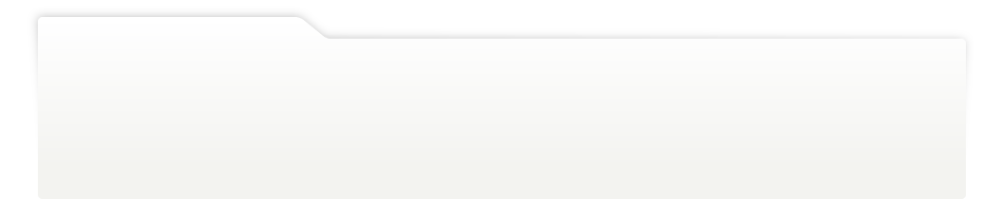
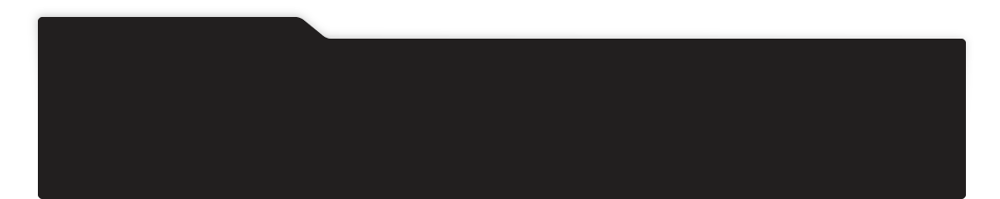
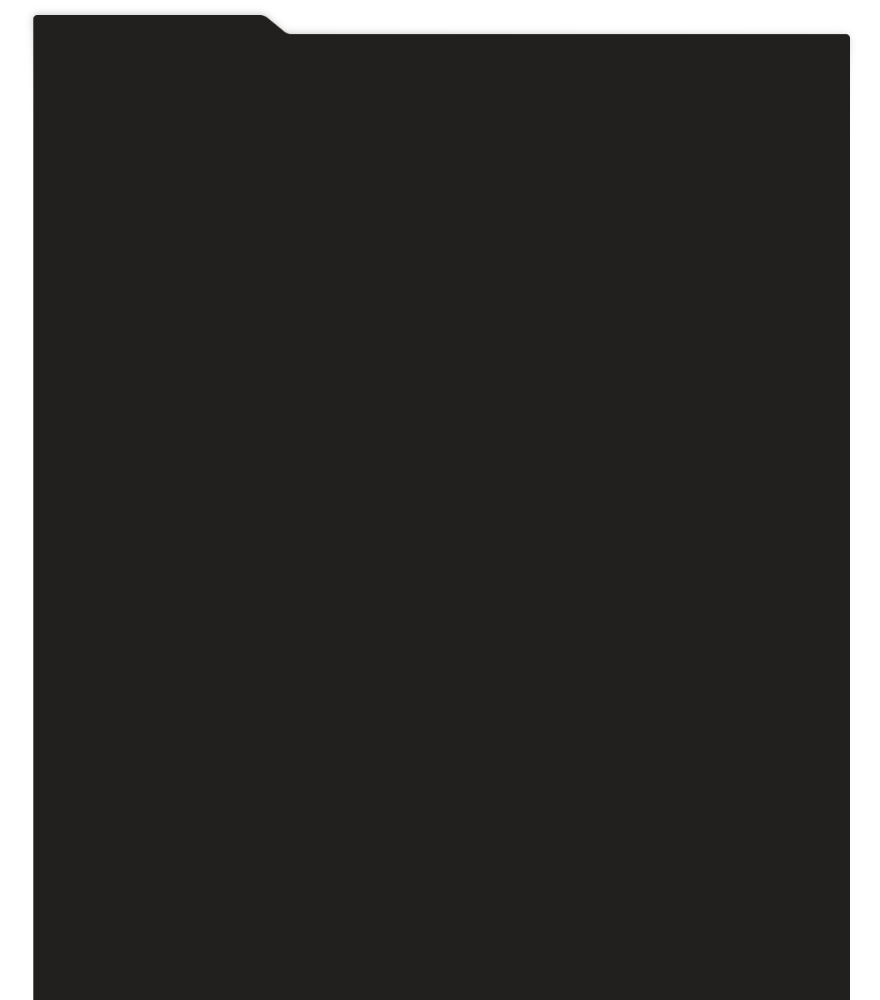
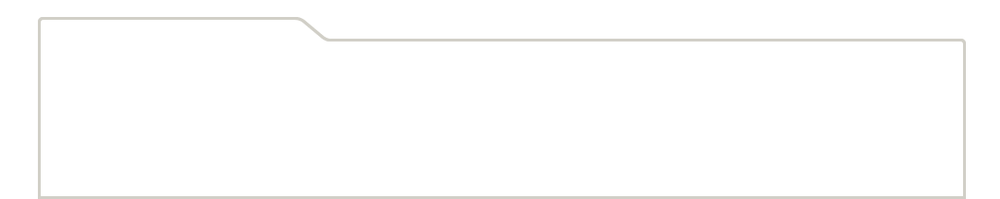
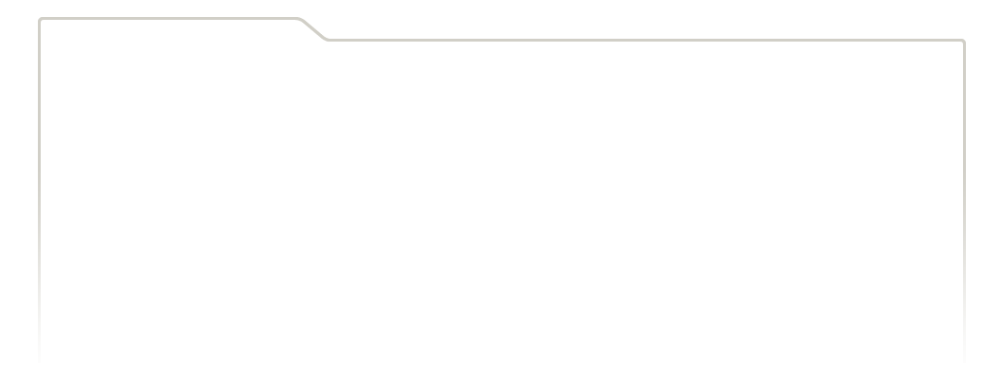
...
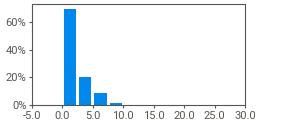
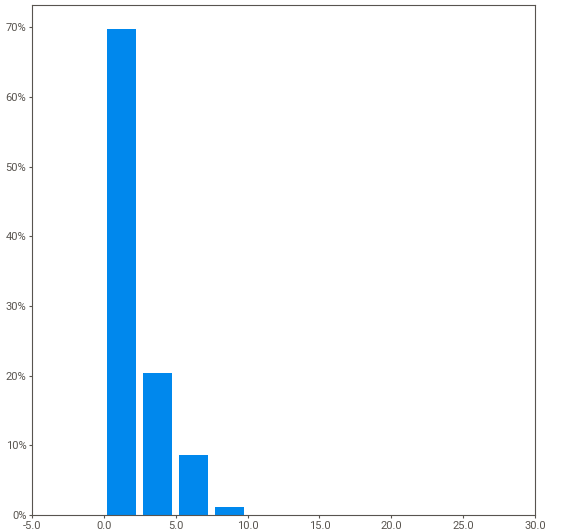
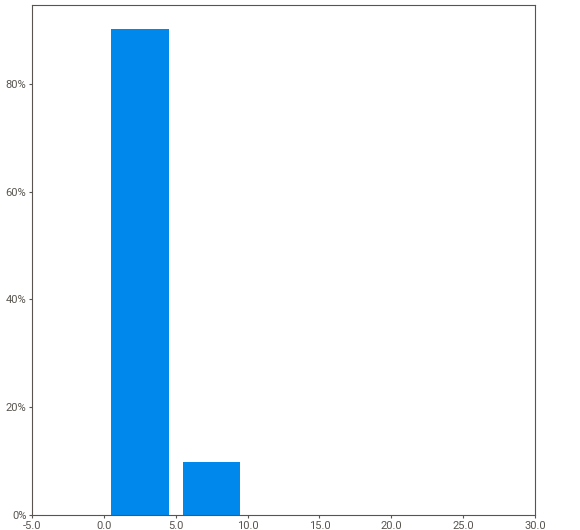
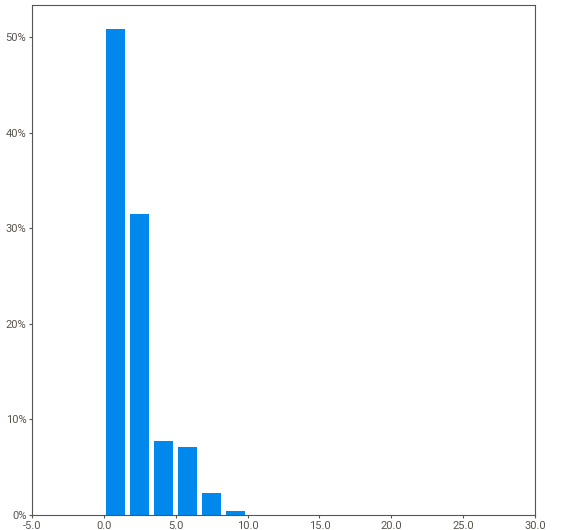
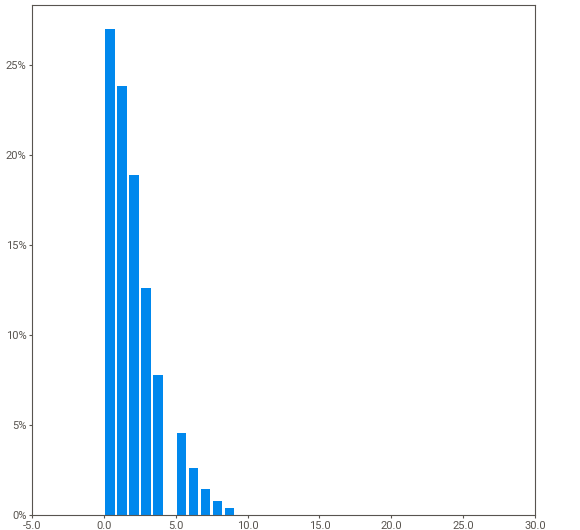

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_1 = sweetviz.analyze(
            [application, "application"],
            pairwise_analysis="off",
        )
        report_inspect_1.show_notebook()

Let's test the hypothesis that males (M) and females (F) have different repayment abilities.
For this purpose, the **chi-squared test** of independence will be used. The `CODE_GENDER` and `TARGET` columns are selected from the `application` table and treated as nominal variables. The **null hypothesis** is that the proportion of 0 (no financial difficulties) and 1 (have financial difficulties) in each group is the same. The **alternative hypothesis** is that the proportions are different.

The test results reveal that the differences are significant and the frequency table (see below) reveals that the size of the difference in males and females with financial difficulties is approximately 3 percent.

*Note.* 
As making financial decisions based on gender is illegal in many countries, this variable will be excluded from the analysis.

chi-square test, χ²(1, n = 307507) = 920.01, p < 0.001


TARGET,0,1
CODE_GENDER,,
F,93.0%,7.0%
M,89.9%,10.1%


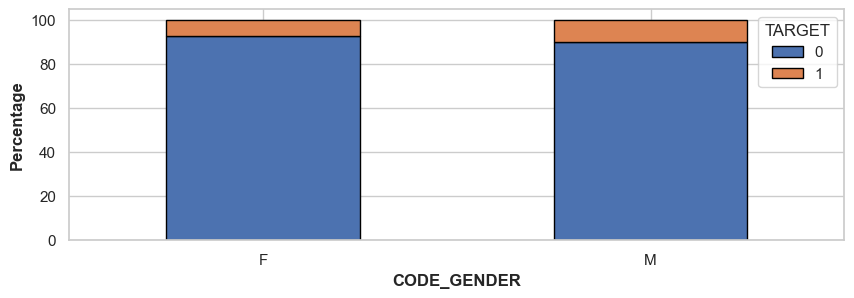

In [ ]:
sns.set_theme(style="whitegrid")
crosstab = an.CrossTab(
    "CODE_GENDER", "TARGET", application.query("CODE_GENDER != 'XNA'")
)
crosstab.barplot(normalize="rows", stacked=True)
print(crosstab.chisq_test())
# The percentages of each row add up to 100%
crosstab.row_percentage.style.format("{:.1f}%")

***

### Table `bureau`

In [ ]:
bureau.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Columns: 17 entries, SK_ID_CURR to AMT_ANNUITY
dtypes: category(3), float32(2), float64(6), int16(2), int32(3), int8(1)
memory usage: 124.4 MB


In [ ]:
bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN


In [ ]:
an.col_info(bureau, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,6.9 MB,"305,811",17.8%,0,0%,116,<0.1%,<0.1%,120860
2,SK_ID_BUREAU,int32,6.9 MB,"1,716,428",100.0%,0,0%,1,<0.1%,<0.1%,5714462
3,CREDIT_ACTIVE,category,1.7 MB,4,<0.1%,0,0%,"1,079,273",62.9%,62.9%,Closed
4,CREDIT_CURRENCY,category,1.7 MB,4,<0.1%,0,0%,"1,715,020",99.9%,99.9%,currency 1
5,DAYS_CREDIT,int16,3.4 MB,"2,923",0.2%,0,0%,"1,330",0.1%,0.1%,-364
6,CREDIT_DAY_OVERDUE,int16,3.4 MB,942,0.1%,0,0%,"1,712,211",99.8%,99.8%,0
7,DAYS_CREDIT_ENDDATE,float32,6.9 MB,"14,096",0.8%,"105,553",6.1%,883,0.1%,0.1%,0.0
8,DAYS_ENDDATE_FACT,float32,6.9 MB,"2,917",0.2%,"633,653",36.9%,811,<0.1%,0.1%,-329.0
9,AMT_CREDIT_MAX_OVERDUE,float64,13.7 MB,"68,251",4.0%,"1,124,488",65.5%,"470,650",27.4%,79.5%,0.0
10,CNT_CREDIT_PROLONG,int8,1.7 MB,10,<0.1%,0,0%,"1,707,314",99.5%,99.5%,0


                                             |          | [  0%]   00:00 -> (? left)


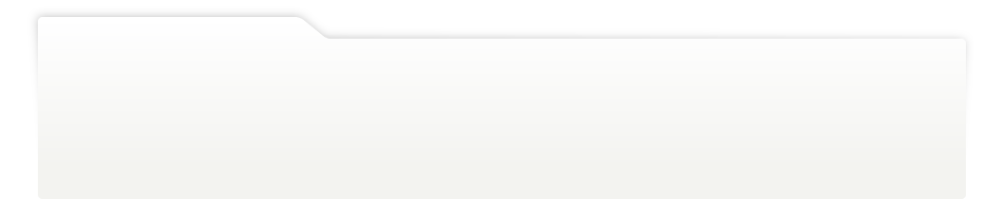
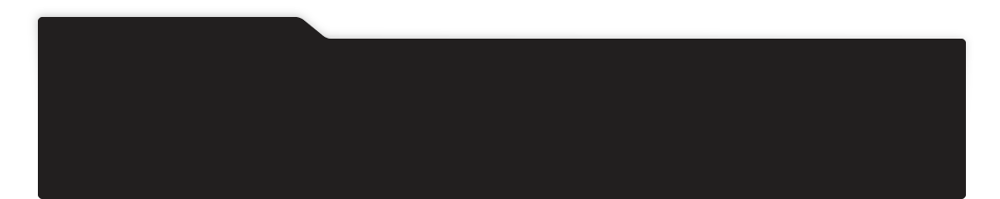
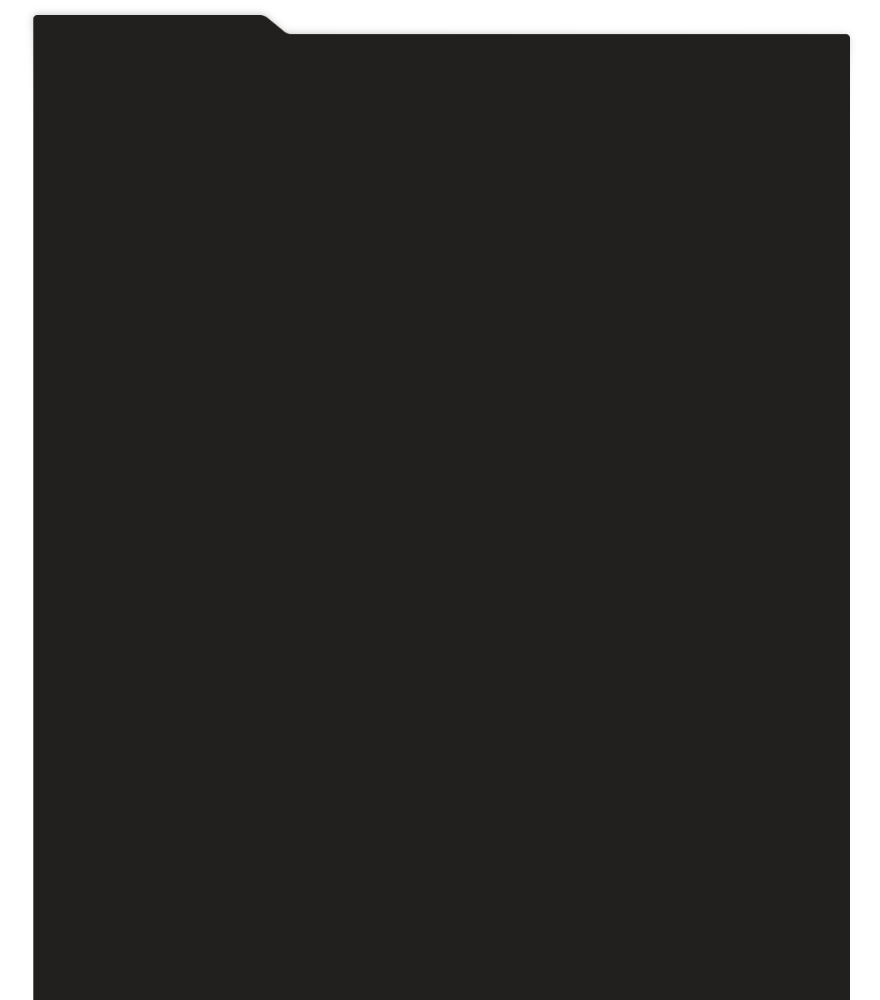
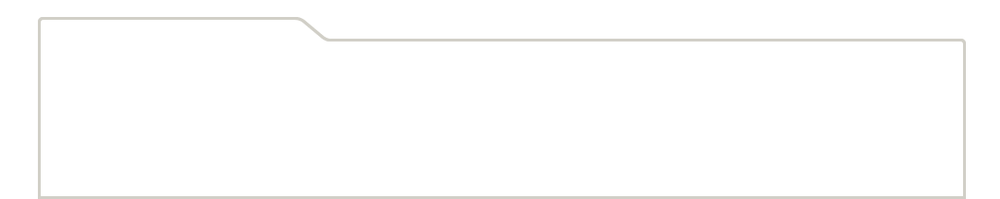
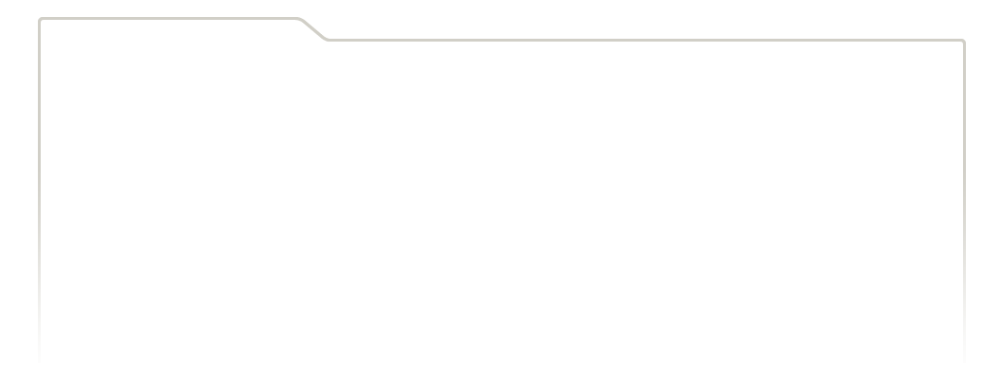
...
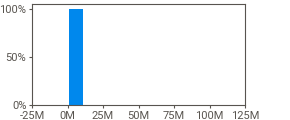
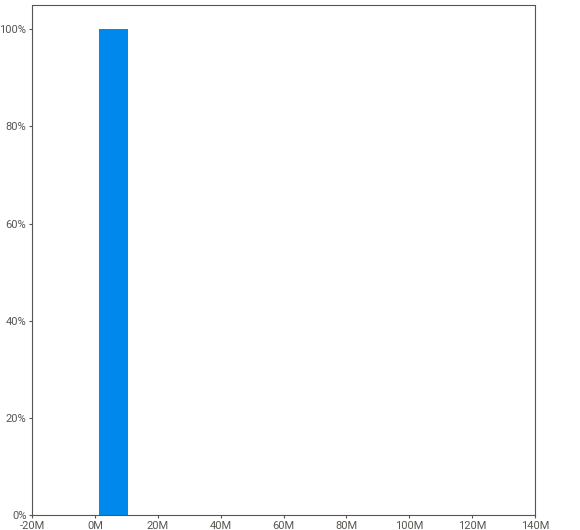
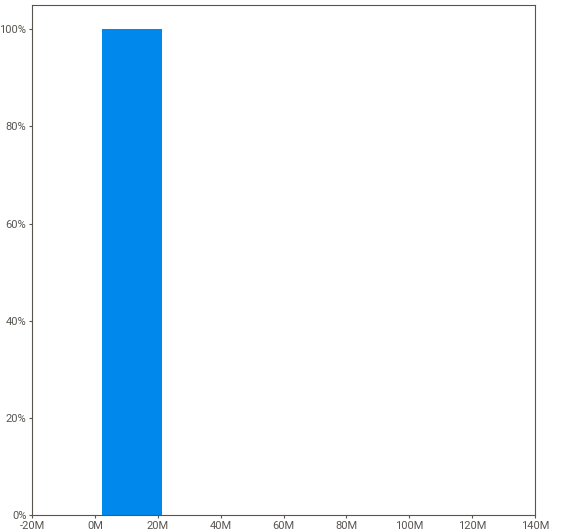
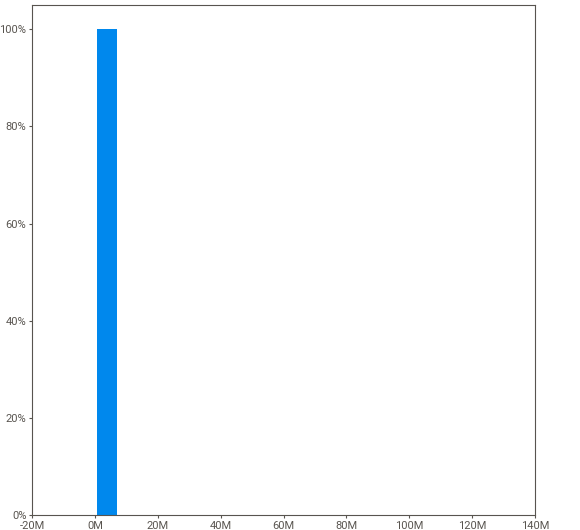
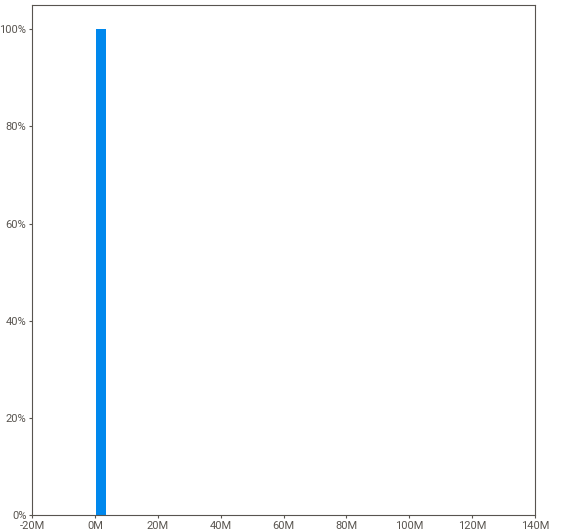

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_2 = sweetviz.analyze(
            [bureau, "bureau"],
            pairwise_analysis="off",
        )
        report_inspect_2.show_notebook()

***

### Table `bureau_balance`

In [ ]:
bureau_balance.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Columns: 3 entries, SK_ID_BUREAU to STATUS
dtypes: category(1), int32(1), int8(1)
memory usage: 156.2 MB


In [ ]:
bureau_balance.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [ ]:
an.col_info(bureau_balance, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_BUREAU,int32,109.2 MB,"817,395",3.0%,0,0%,97,<0.1%,<0.1%,5645521
2,MONTHS_BALANCE,int8,27.3 MB,97,<0.1%,0,0%,"622,601",2.3%,2.3%,-1
3,STATUS,category,27.3 MB,8,<0.1%,0,0%,"13,646,993",50.0%,50.0%,C


                                             |          | [  0%]   00:00 -> (? left)


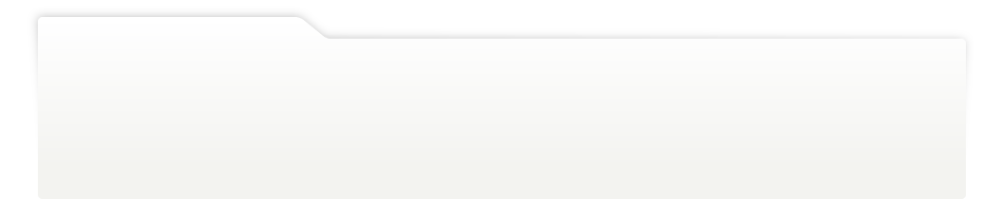
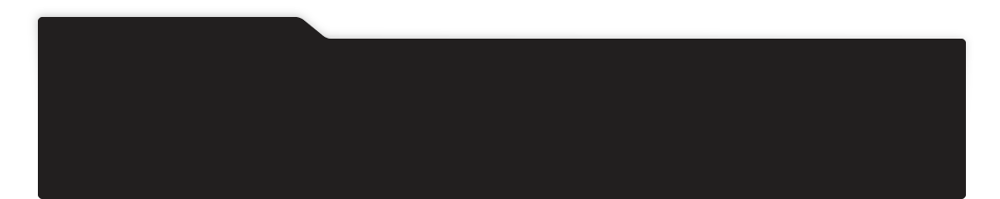
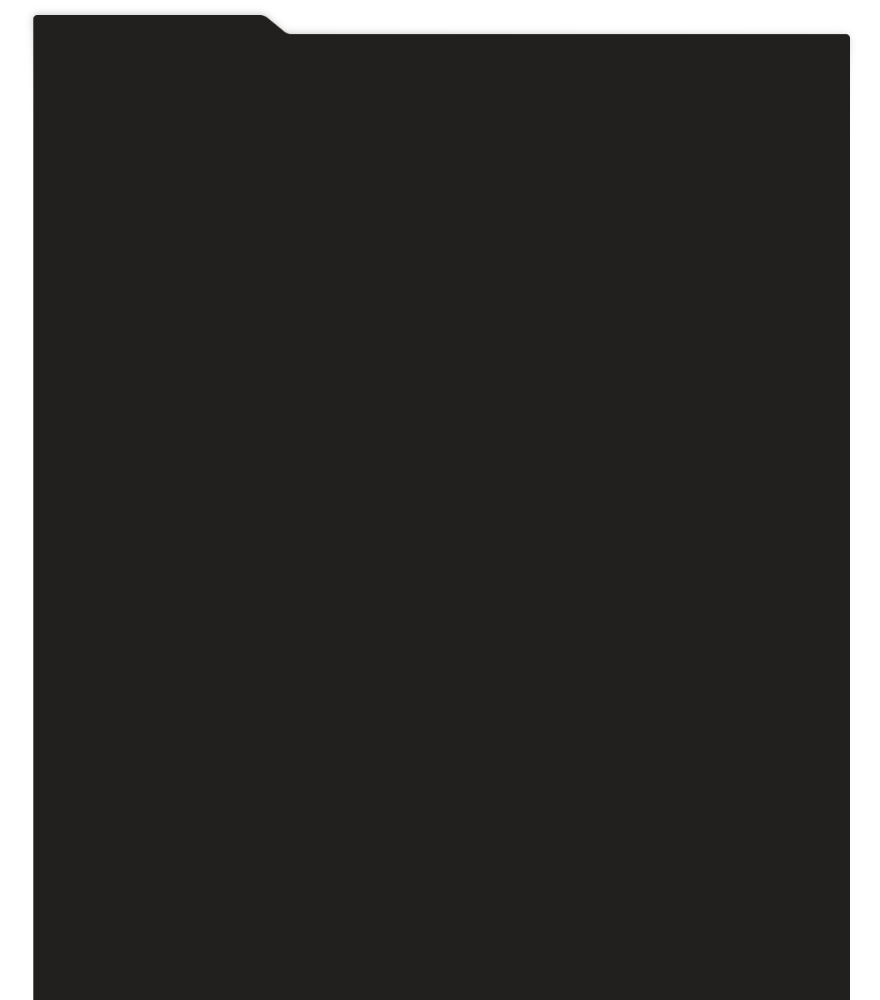
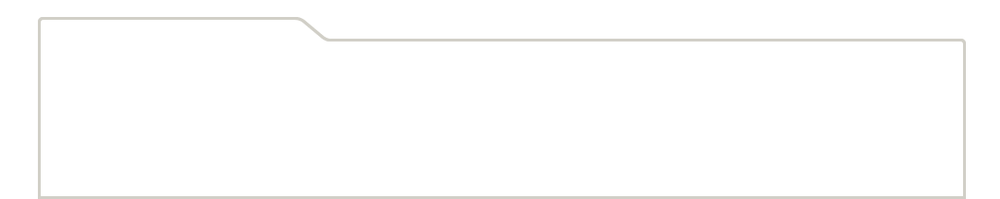
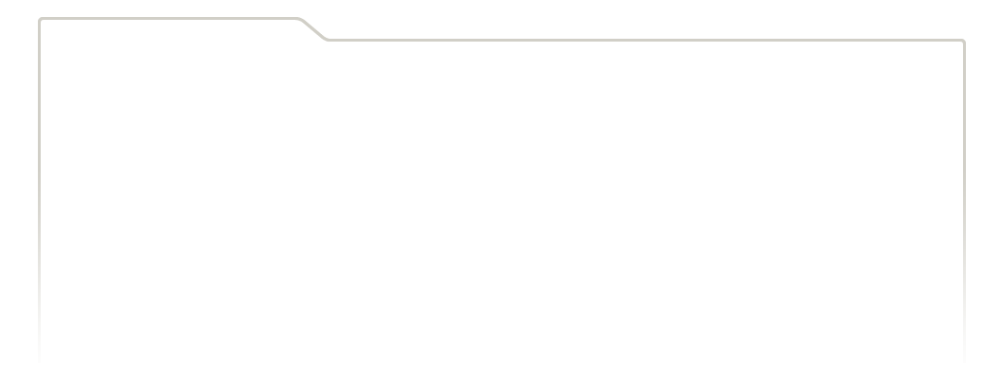
...
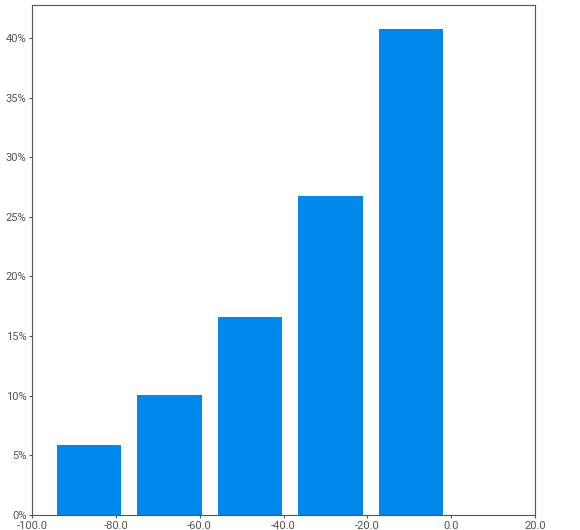
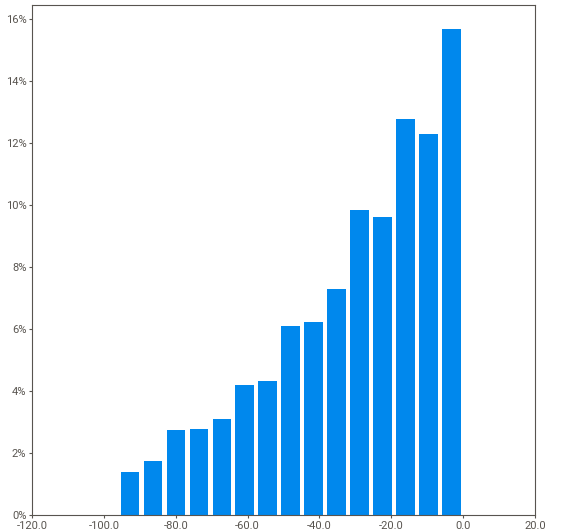
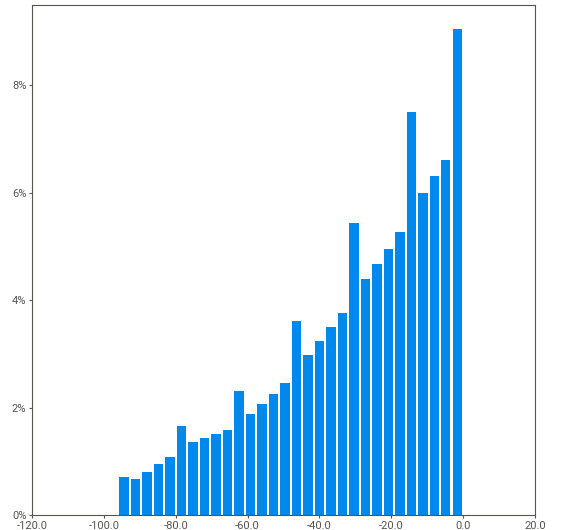
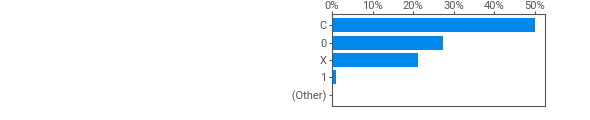
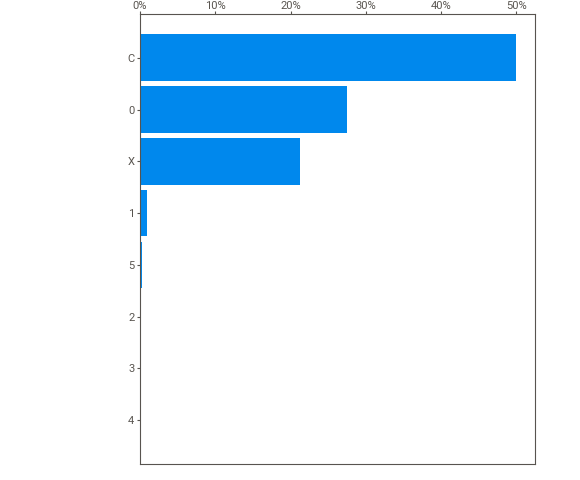

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_3 = sweetviz.analyze(
            [bureau_balance, "bureau_balance"],
            pairwise_analysis="off",
        )
        report_inspect_3.show_notebook()

***

### Table `previous_application`

In [ ]:
previous_application.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Columns: 37 entries, SK_ID_PREV to NFLAG_INSURED_ON_APPROVAL
dtypes: category(16), float32(10), float64(5), int16(1), int32(3), int8(2)
memory usage: 178.4 MB


In [ ]:
previous_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.43,17145.00,17145.00,0.00,17145.00,SATURDAY,15,Y,1,0.00,0.18,0.87,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.00,middle,POS mobile with interest,365243.00,-42.00,300.00,-42.00,-37.00,0.00
1,2802425,108129,Cash loans,25188.62,607500.00,679671.00,NaN,607500.00,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.00,low_action,Cash X-Sell: low,365243.00,-134.00,916.00,365243.00,365243.00,1.00
2,2523466,122040,Cash loans,15060.74,112500.00,136444.50,NaN,112500.00,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,high,Cash X-Sell: high,365243.00,-271.00,59.00,365243.00,365243.00,1.00
3,2819243,176158,Cash loans,47041.33,450000.00,470790.00,NaN,450000.00,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,middle,Cash X-Sell: middle,365243.00,-482.00,-152.00,-182.00,-177.00,1.00
4,1784265,202054,Cash loans,31924.40,337500.00,404055.00,NaN,337500.00,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.00,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
an.col_info(previous_application, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_PREV,int32,6.7 MB,"1,670,214",100.0%,0,0%,1,<0.1%,<0.1%,2030495
2,SK_ID_CURR,int32,6.7 MB,"338,857",20.3%,0,0%,77,<0.1%,<0.1%,187868
3,NAME_CONTRACT_TYPE,category,1.7 MB,4,<0.1%,0,0%,"747,553",44.8%,44.8%,Cash loans
4,AMT_ANNUITY,float64,13.4 MB,"357,959",21.4%,"372,235",22.3%,"31,865",1.9%,2.5%,2250.0
5,AMT_APPLICATION,float64,13.4 MB,"93,885",5.6%,0,0%,"392,402",23.5%,23.5%,0.0
6,AMT_CREDIT,float64,13.4 MB,"86,803",5.2%,1,<0.1%,"336,768",20.2%,20.2%,0.0
7,AMT_DOWN_PAYMENT,float64,13.4 MB,"29,278",1.8%,"895,844",53.6%,"369,854",22.1%,47.8%,0.0
8,AMT_GOODS_PRICE,float64,13.4 MB,"93,885",5.6%,"385,515",23.1%,"47,831",2.9%,3.7%,45000.0
9,WEEKDAY_APPR_PROCESS_START,category,1.7 MB,7,<0.1%,0,0%,"255,118",15.3%,15.3%,TUESDAY
10,HOUR_APPR_PROCESS_START,int8,1.7 MB,24,<0.1%,0,0%,"192,728",11.5%,11.5%,11


                                             |          | [  0%]   00:00 -> (? left)


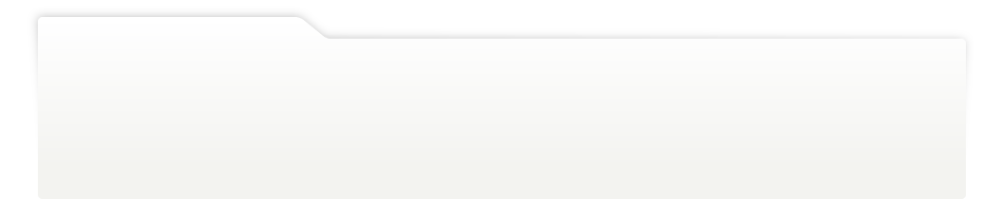
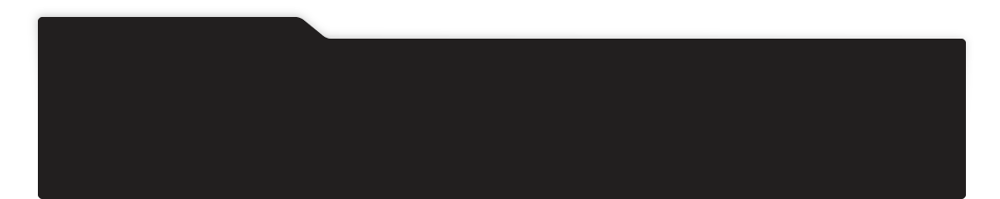
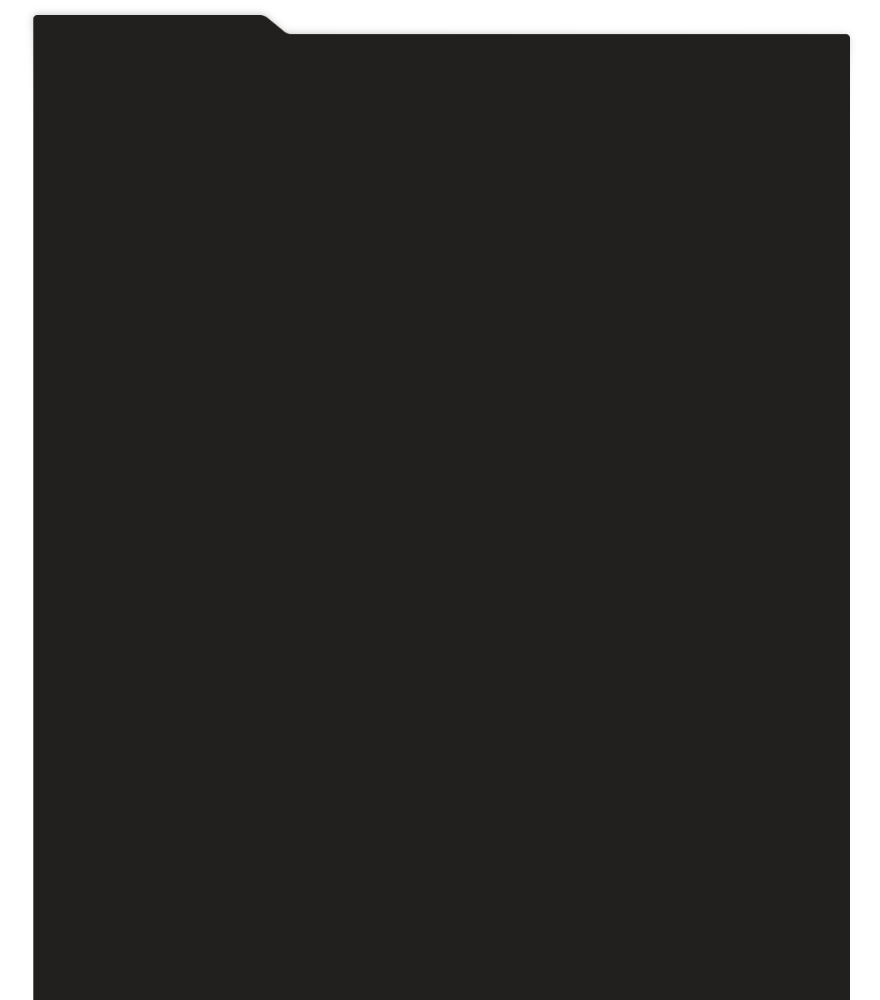
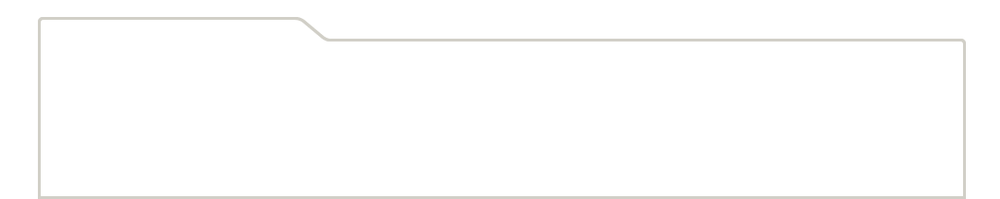
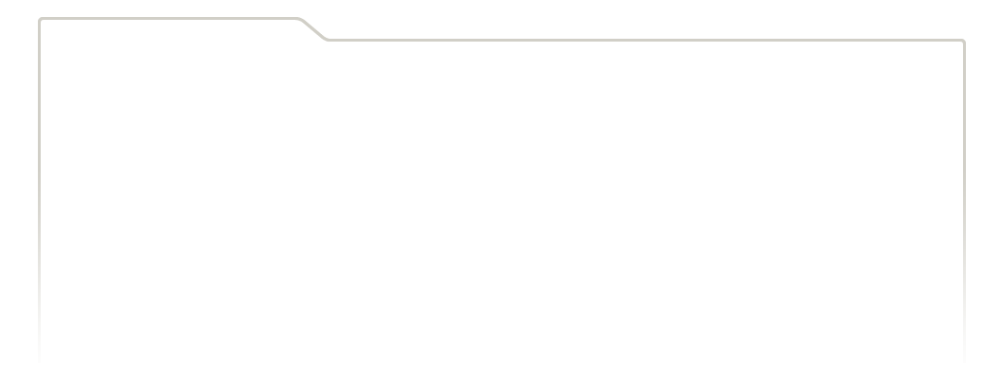
...
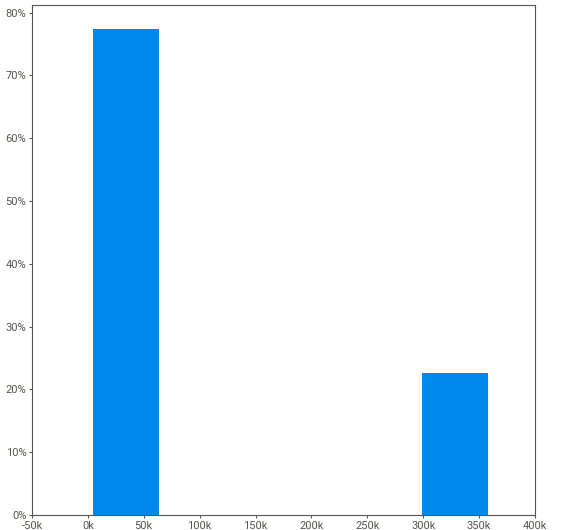
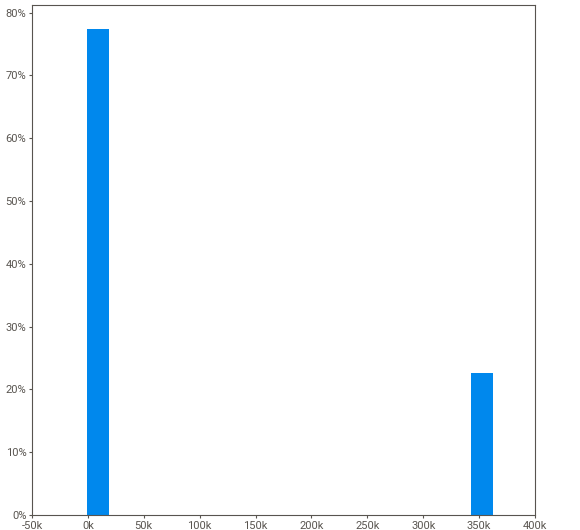
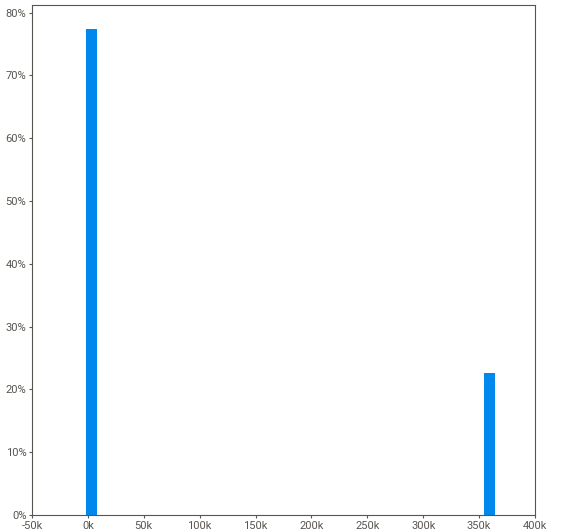
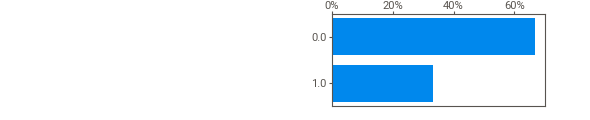
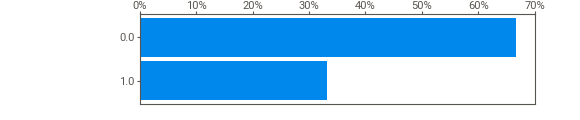

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_4 = sweetviz.analyze(
            [previous_application, "previous_application"],
            pairwise_analysis="off",
        )
        report_inspect_4.show_notebook()

***

### Table `pos_cash_balance`

In [ ]:
pos_cash_balance.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Columns: 8 entries, SK_ID_PREV to SK_DPD_DEF
dtypes: category(1), float32(2), int16(2), int32(2), int8(1)
memory usage: 209.8 MB


In [ ]:
pos_cash_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.00,45.00,Active,0,0
1,1715348,367990,-33,36.00,35.00,Active,0,0
2,1784872,397406,-32,12.00,9.00,Active,0,0
3,1903291,269225,-35,48.00,42.00,Active,0,0
4,2341044,334279,-35,36.00,35.00,Active,0,0


In [ ]:
an.col_info(pos_cash_balance, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_PREV,int32,40.0 MB,"936,325",9.4%,0,0%,96,<0.1%,<0.1%,1856103
2,SK_ID_CURR,int32,40.0 MB,"337,252",3.4%,0,0%,295,<0.1%,<0.1%,265042
3,MONTHS_BALANCE,int8,10.0 MB,96,<0.1%,0,0%,"216,441",2.2%,2.2%,-10
4,CNT_INSTALMENT,float32,40.0 MB,73,<0.1%,"26,071",0.3%,"2,496,845",25.0%,25.0%,12.0
5,CNT_INSTALMENT_FUTURE,float32,40.0 MB,79,<0.1%,"26,087",0.3%,"1,185,960",11.9%,11.9%,0.0
6,NAME_CONTRACT_STATUS,category,10.0 MB,9,<0.1%,0,0%,"9,151,119",91.5%,91.5%,Active
7,SK_DPD,int16,20.0 MB,"3,400",<0.1%,0,0%,"9,706,131",97.0%,97.0%,0
8,SK_DPD_DEF,int16,20.0 MB,"2,307",<0.1%,0,0%,"9,887,389",98.9%,98.9%,0


                                             |          | [  0%]   00:00 -> (? left)


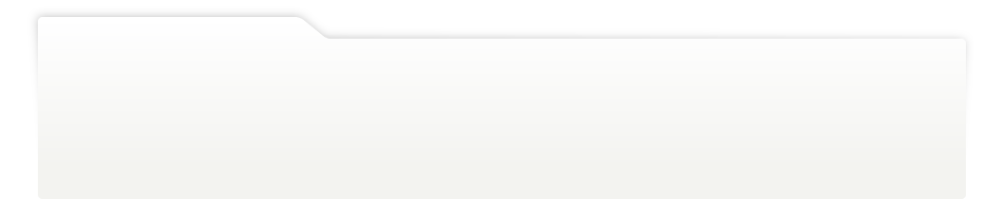
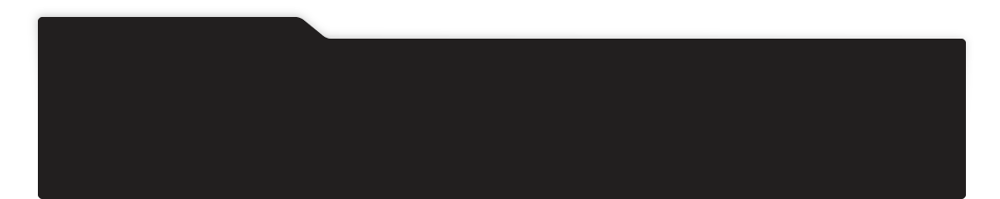
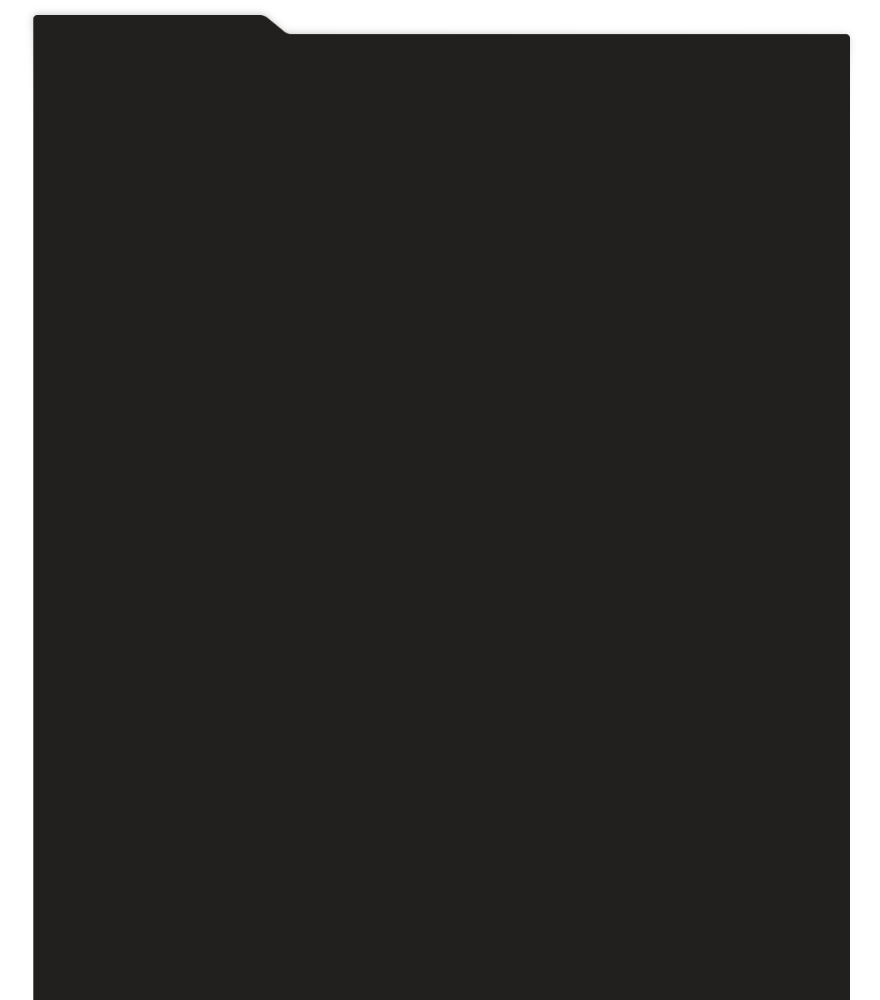
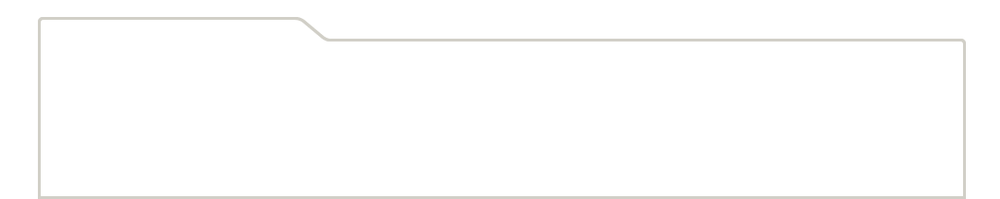
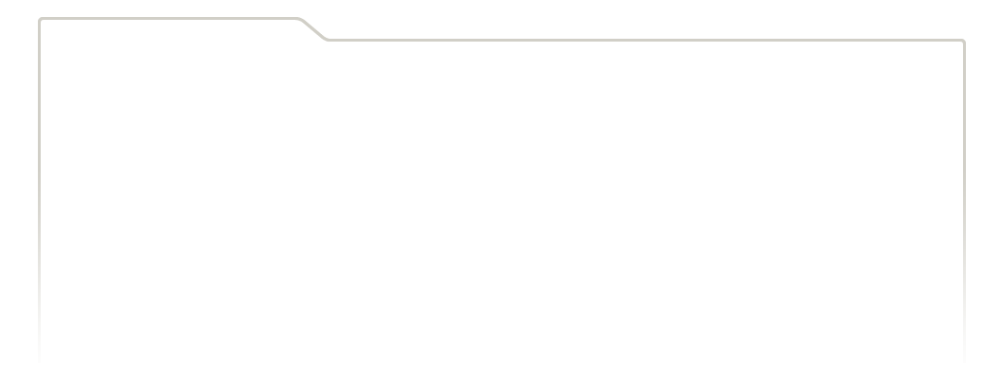
...
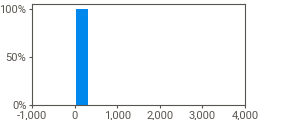
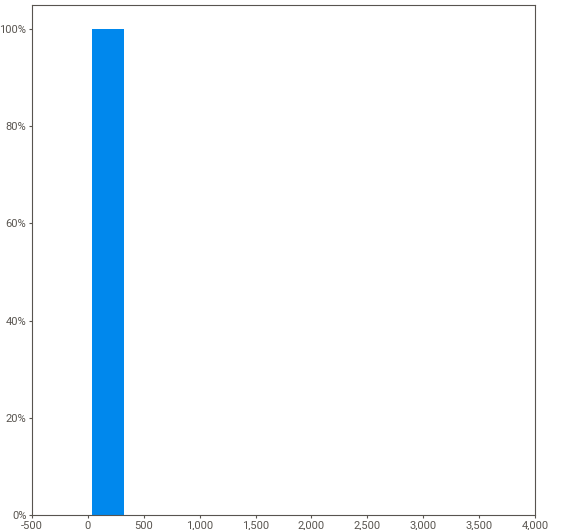
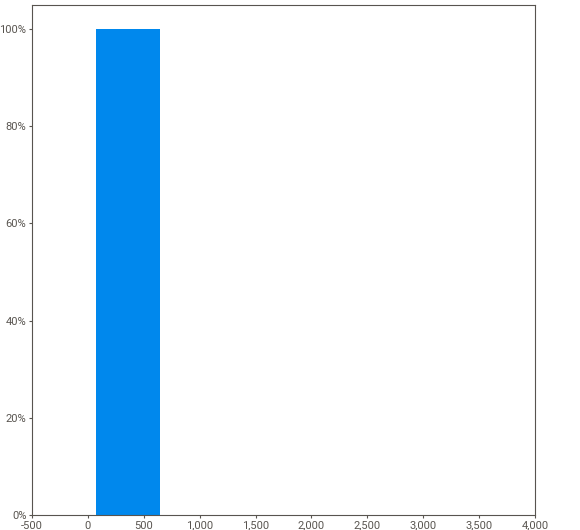
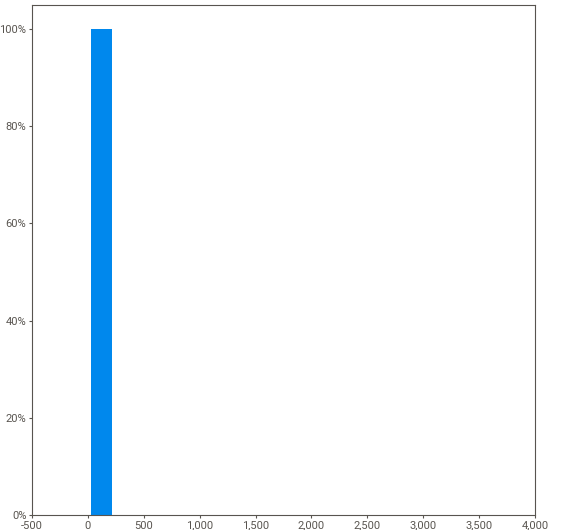
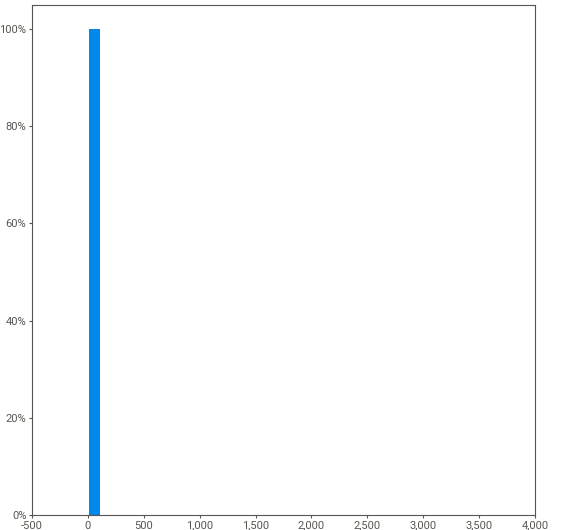

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_5 = sweetviz.analyze(
            [pos_cash_balance, "pos_cash_balance"],
            pairwise_analysis="off",
        )
        report_inspect_5.show_notebook()

***

### Table `credit_card_balance`

In [ ]:
credit_card_balance.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Columns: 23 entries, SK_ID_PREV to SK_DPD_DEF
dtypes: category(1), float32(4), float64(11), int16(3), int32(3), int8(1)
memory usage: 454.1 MB


In [ ]:
credit_card_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,Active,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,Active,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,Active,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,Active,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,Active,0,0


In [ ]:
an.col_info(credit_card_balance, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_PREV,int32,15.4 MB,"104,307",2.7%,0,0%,96,<0.1%,<0.1%,2377894
2,SK_ID_CURR,int32,15.4 MB,"103,558",2.7%,0,0%,192,<0.1%,<0.1%,186401
3,MONTHS_BALANCE,int8,3.8 MB,96,<0.1%,0,0%,"102,115",2.7%,2.7%,-4
4,AMT_BALANCE,float64,30.7 MB,"1,347,904",35.1%,0,0%,"2,156,420",56.2%,56.2%,0.0
5,AMT_CREDIT_LIMIT_ACTUAL,int32,15.4 MB,181,<0.1%,0,0%,"753,823",19.6%,19.6%,0
6,AMT_DRAWINGS_ATM_CURRENT,float64,30.7 MB,"2,267",0.1%,"749,816",19.5%,"2,665,718",69.4%,86.3%,0.0
7,AMT_DRAWINGS_CURRENT,float64,30.7 MB,"187,005",4.9%,0,0%,"3,223,443",83.9%,83.9%,0.0
8,AMT_DRAWINGS_OTHER_CURRENT,float64,30.7 MB,"1,832",<0.1%,"749,816",19.5%,"3,078,163",80.2%,99.6%,0.0
9,AMT_DRAWINGS_POS_CURRENT,float64,30.7 MB,"168,748",4.4%,"749,816",19.5%,"2,825,595",73.6%,91.4%,0.0
10,AMT_INST_MIN_REGULARITY,float64,30.7 MB,"312,266",8.1%,"305,236",7.9%,"1,928,864",50.2%,54.6%,0.0


                                             |          | [  0%]   00:00 -> (? left)


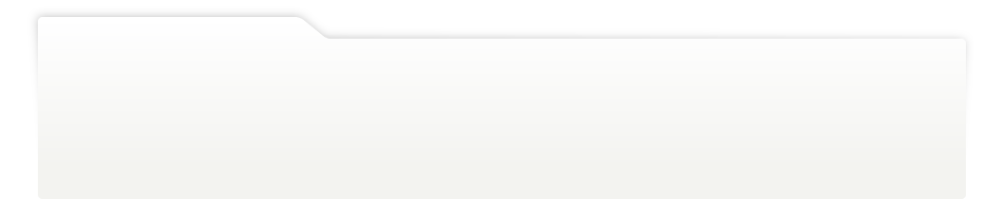
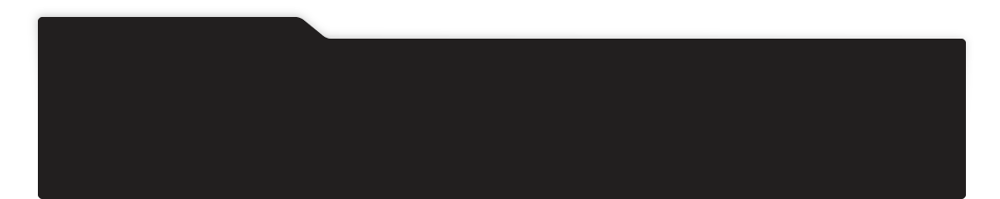
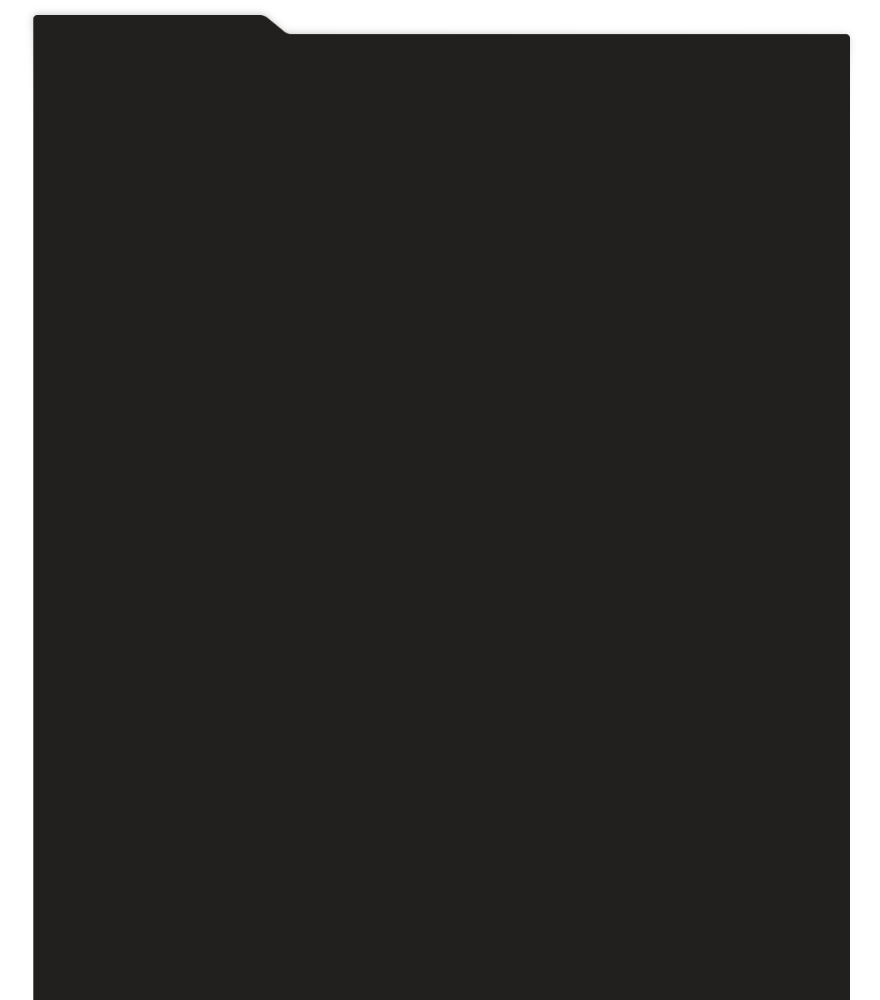
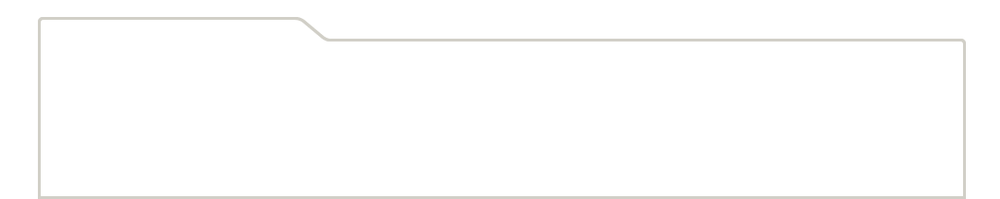
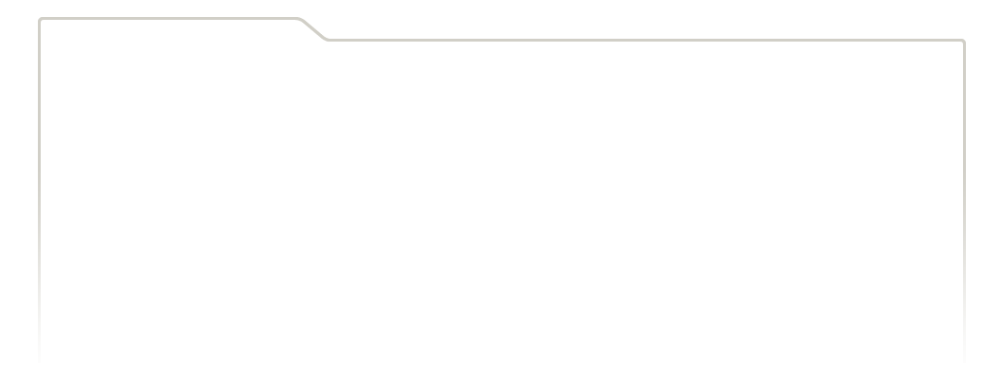
...
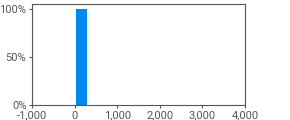
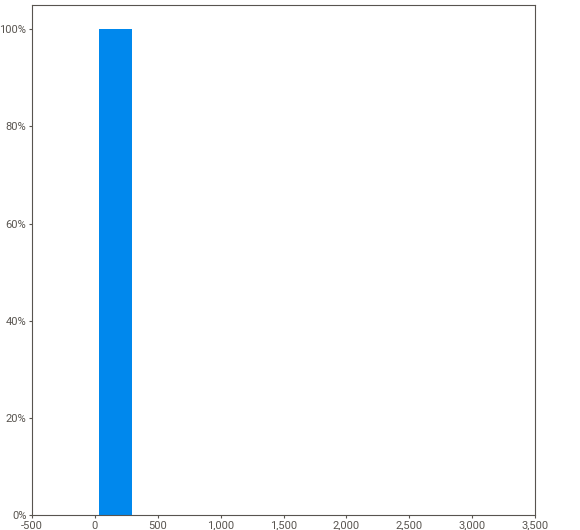
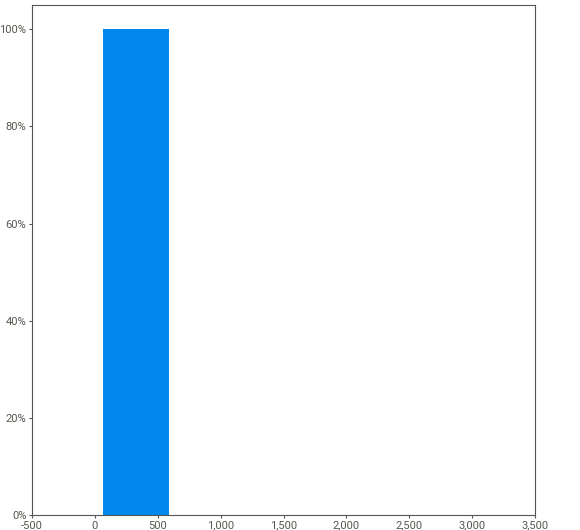
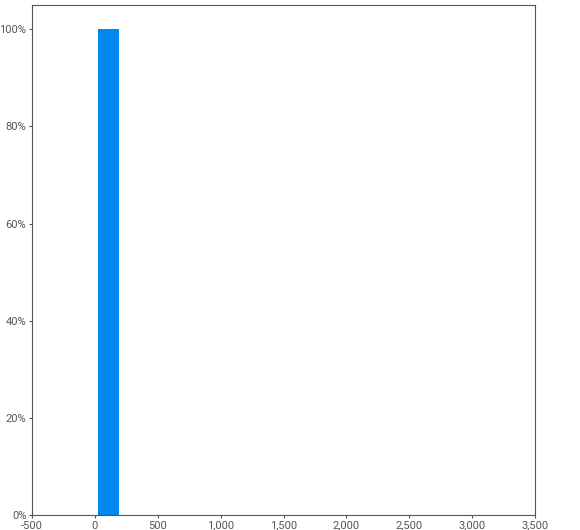
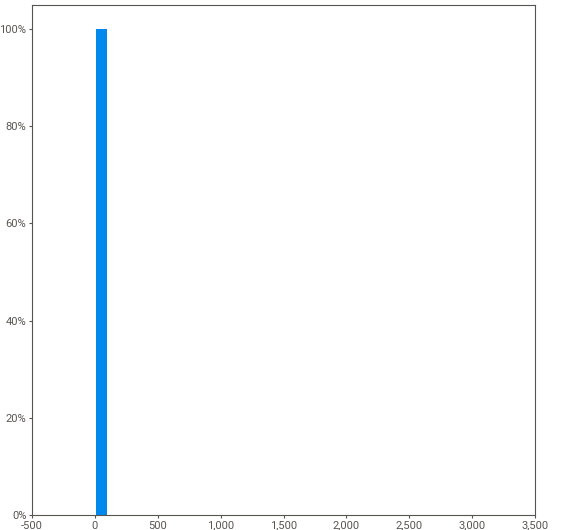

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_6 = sweetviz.analyze(
            [credit_card_balance, "previous_application"],
            pairwise_analysis="off",
        )
        report_inspect_6.show_notebook()

### Table `installments_payments`

In [ ]:
installments_payments.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Columns: 8 entries, SK_ID_PREV to AMT_PAYMENT
dtypes: float32(3), float64(2), int16(1), int32(2)
memory usage: 493.1 MB


In [ ]:
installments_payments.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.00,6,-1180.00,-1187.00,6948.36,6948.36
1,1330831,151639,0.00,34,-2156.00,-2156.00,1716.53,1716.53
2,2085231,193053,2.00,1,-63.00,-63.00,25425.00,25425.00
3,2452527,199697,1.00,3,-2418.00,-2426.00,24350.13,24350.13
4,2714724,167756,1.00,2,-1383.00,-1366.00,2165.04,2160.59


In [ ]:
an.col_info(installments_payments, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_PREV,int32,54.4 MB,"997,752",7.3%,0,0%,293,<0.1%,<0.1%,2360056
2,SK_ID_CURR,int32,54.4 MB,"339,587",2.5%,0,0%,372,<0.1%,<0.1%,145728
3,NUM_INSTALMENT_VERSION,float32,54.4 MB,65,<0.1%,0,0%,"8,485,004",62.4%,62.4%,1.0
4,NUM_INSTALMENT_NUMBER,int16,27.2 MB,277,<0.1%,0,0%,"1,004,160",7.4%,7.4%,1
5,DAYS_INSTALMENT,float32,54.4 MB,"2,922",<0.1%,0,0%,"11,512",0.1%,0.1%,-120.0
6,DAYS_ENTRY_PAYMENT,float32,54.4 MB,"3,039",<0.1%,"2,905",<0.1%,"13,103",0.1%,0.1%,-91.0
7,AMT_INSTALMENT,float64,108.8 MB,"902,539",6.6%,0,0%,"254,062",1.9%,1.9%,9000.0
8,AMT_PAYMENT,float64,108.8 MB,"944,235",6.9%,"2,905",<0.1%,"248,757",1.8%,1.8%,9000.0


                                             |          | [  0%]   00:00 -> (? left)


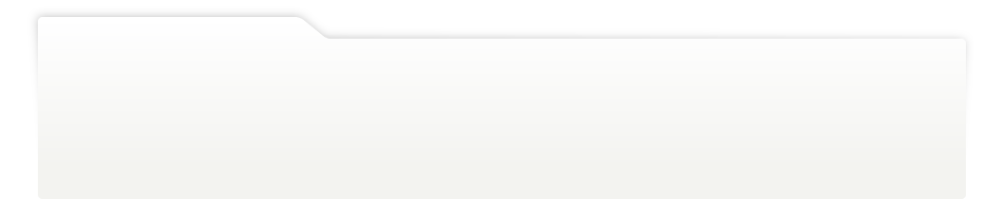
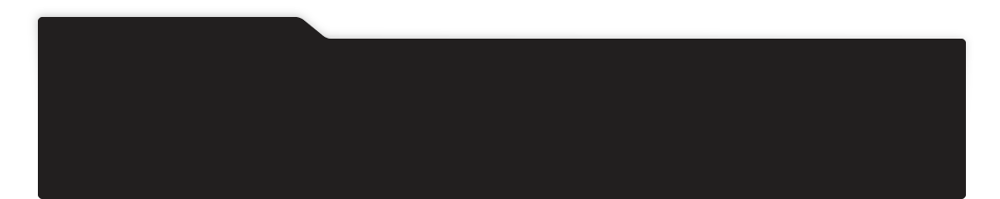
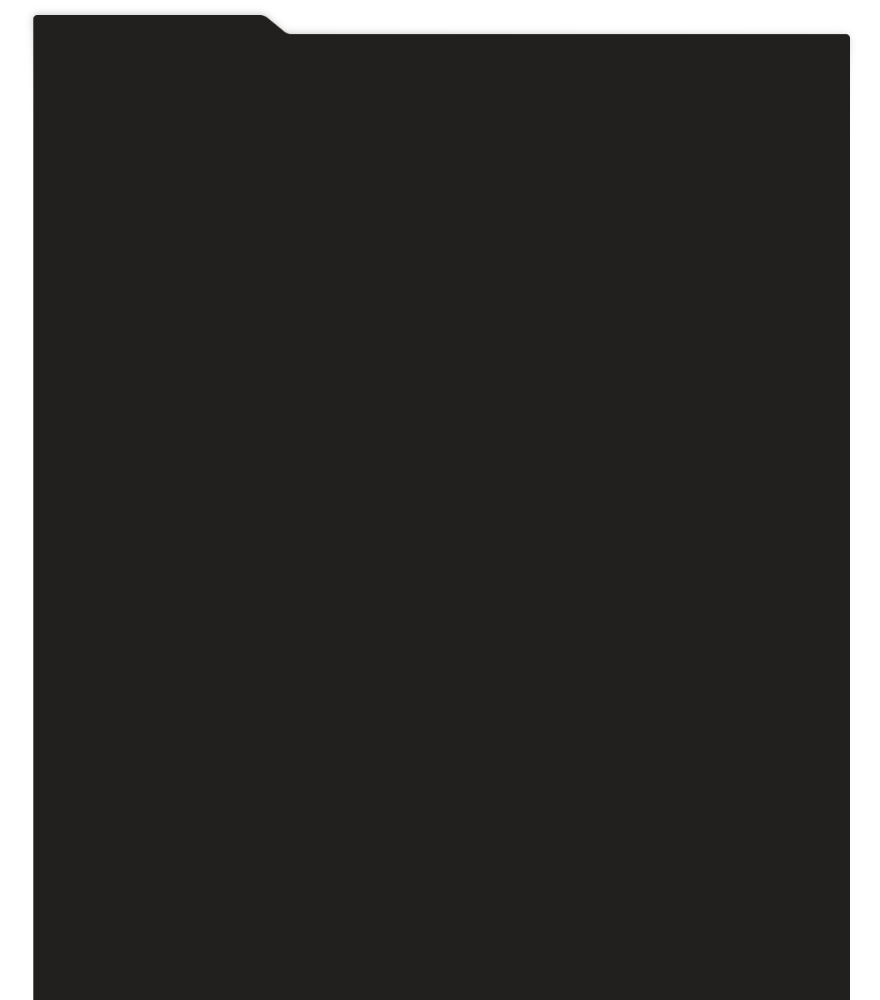
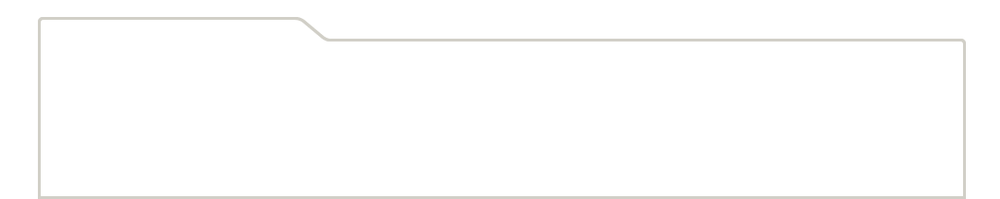
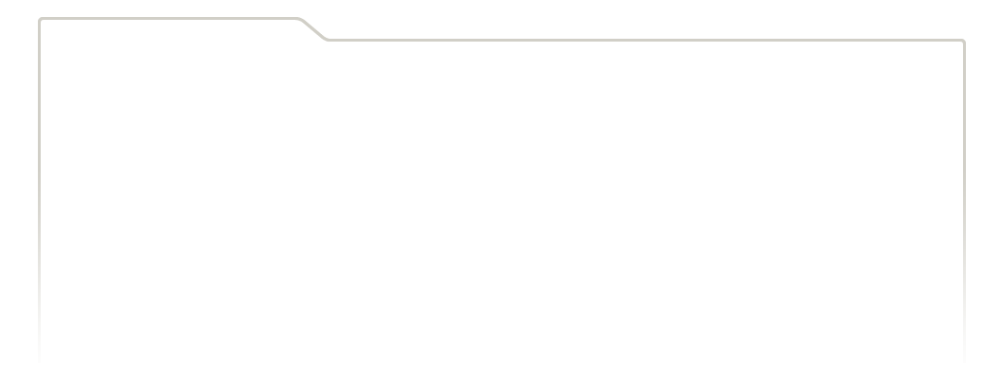
...
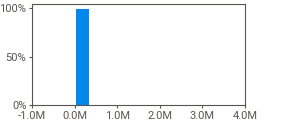
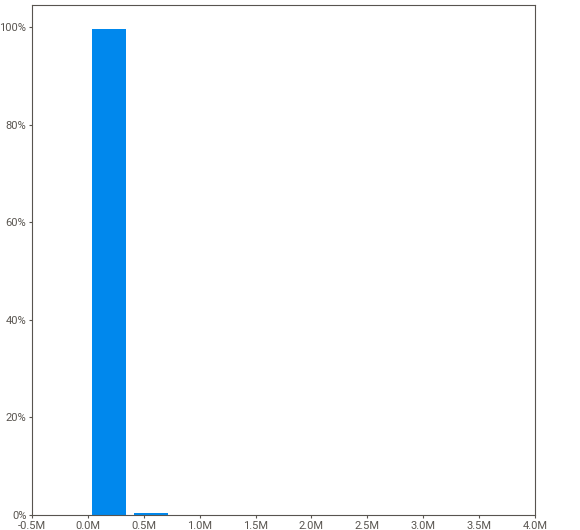
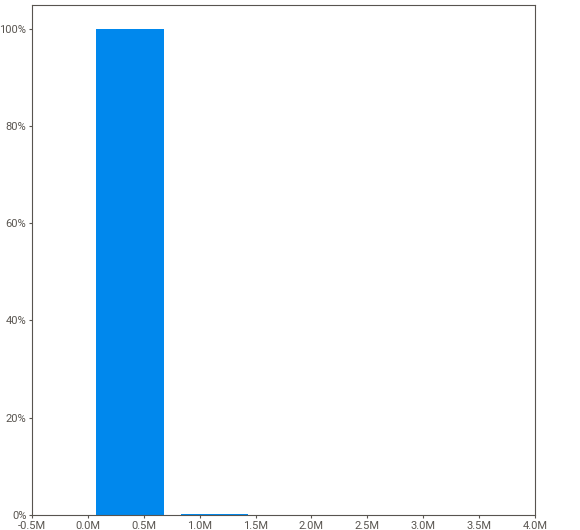
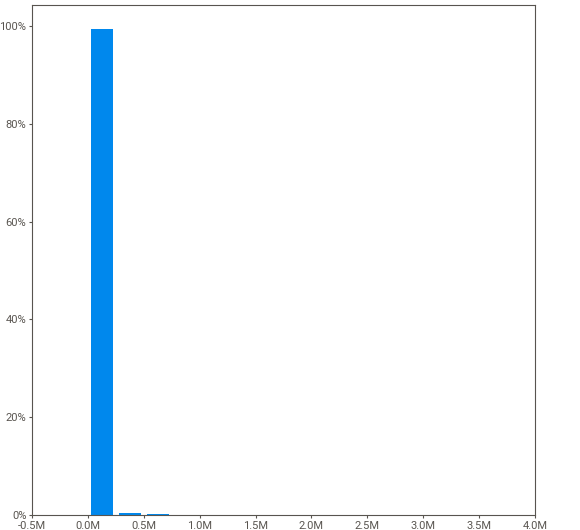
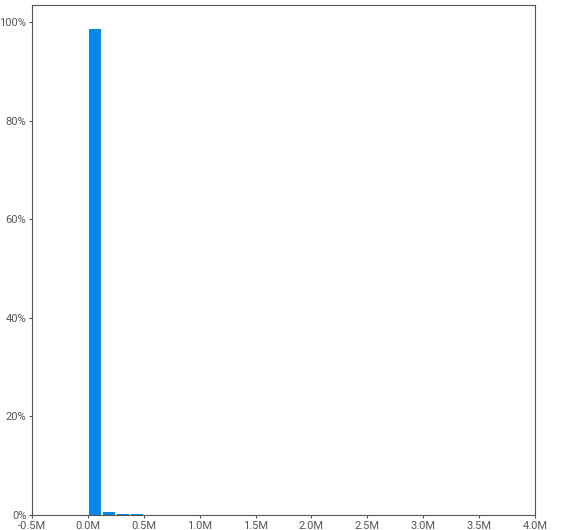

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_inspect_7 = sweetviz.analyze(
            [installments_payments, "installments_payments"],
            pairwise_analysis="off",
        )
        report_inspect_7.show_notebook()

***

### Tables `application_test` and `sample_submission`

Table `application_test` contains the same variables as table `application`, but without the target variable `TARGET`. 
And table `sample_submission` only contains sample and not real data. These tables will be **excluded** from the analysis.

In [ ]:
application_test.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: category(16), float32(64), float64(1), int16(2), int32(2), int8(36)
memory usage: 15.3 MB


In [ ]:
application_test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.00,568800.00,20560.50,450000.00,Unaccompanied,Working,Higher education,Married,House / apartment,0.02,-19241,-2329,-5170.00,-812,NaN,1,1,0,1,0,1,NaN,2.00,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.75,0.79,0.16,0.07,0.06,0.97,NaN,NaN,NaN,0.14,0.12,NaN,NaN,NaN,0.05,NaN,NaN,0.07,0.06,0.97,NaN,NaN,NaN,0.14,0.12,NaN,NaN,NaN,0.05,NaN,NaN,0.07,0.06,0.97,NaN,NaN,NaN,0.14,0.12,NaN,NaN,NaN,0.05,NaN,NaN,NaN,block of flats,0.04,"Stone, brick",No,0.00,0.00,0.00,0.00,-1740.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
1,100005,Cash loans,M,N,Y,0,99000.00,222768.00,17370.00,180000.00,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.04,-18064,-4469,-9118.00,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.00,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.56,0.29,0.43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,3.00
2,100013,Cash loans,M,Y,Y,0,202500.00,663264.00,69777.00,630000.00,NaN,Working,Higher education,Married,House / apartment,0.02,-20038,-4458,-2175.00,-3503,5.00,1,1,0,1,0,0,Drivers,2.00,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.70,0.61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-856.00,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,1.00,4.00
3,100028,Cash loans,F,N,Y,2,315000.00,1575000.00,49018.50,1575000.00,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.03

In [ ]:
sample_submission.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 2 entries, SK_ID_CURR to TARGET
dtypes: float32(1), int32(1)
memory usage: 380.9 KB


In [ ]:
sample_submission.head()

,SK_ID_CURR,TARGET
0,100001,0.50
1,100005,0.50
2,100013,0.50
3,100028,0.50
4,100038,0.50


## Split to Train, Validation, and Test Sets

- To make models more robust for the unseen data, the data is split into **training**, **validation**, and **test sets** (70%:15%:15%). 
- **Stratification** by target is used to ensure that the proportions of target values are the same in all sets.

In [ ]:
application_train, application_validation = train_test_split(
    application, test_size=0.3, random_state=42, stratify=application.TARGET
)

application_validation, application_test = train_test_split(
    application_validation,
    test_size=0.5,
    random_state=42,
    stratify=application_validation.TARGET,
)

In [ ]:
X_train = application_train.drop(columns=["TARGET"])
y_train = application_train["TARGET"]

X_validation = application_validation.drop(columns=["TARGET"])
y_validation = application_validation["TARGET"]

X_test = application_test.drop(columns=["TARGET"])
y_test = application_test["TARGET"]

The sizes of the sets are ("k" stands for thousands):

In [ ]:
print(f"{application_train.shape[0]/1e3:.1f}k rows in training set.")
print(f"{application_validation.shape[0]/1e3: .1f}k rows in validation set.")
print(f"{application_test.shape[0]/1e3: .1f}k rows in test set.")

215.3k rows in training set.
 46.1k rows in validation set.
 46.1k rows in test set.


## EDA on Train Set

A more detailed EDA is performed on the training set only. Pay attention that in the `sweetviz` report, not only the distributions of variables are plotted as bars but also the means of the target variable in each category/interval are indicated by dark blue dots connected with a line.

In [ ]:
application_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
159703,285133,0,Cash loans,F,Y,Y,2,405000.00,1971072.00,68643.00,1800000.00,Unaccompanied,Commercial associate,Higher education,Married,House / apartment,0.01,-13587,-1028,-7460.00,-1823,13.00,1,1,0,1,0,0,Accountants,4.00,3,3,SATURDAY,11,0,0,0,0,0,0,Self-employed,0.68,0.33,0.64,0.12,0.10,0.98,0.78,NaN,0.00,0.24,0.17,0.21,0.00,0.10,0.12,NaN,0.03,0.12,0.10,0.98,0.79,NaN,0.00,0.24,0.17,0.21,0.00,0.11,0.13,NaN,0.03,0.12,0.10,0.98,0.79,NaN,0.00,0.24,0.17,0.21,0.00,0.10,0.13,NaN,0.03,reg oper account,block of flats,0.10,"Stone, brick",No,4.00,0.00,4.00,0.00,-2169.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
79269,191894,0,Cash loans,M,N,Y,0,337500.00,508495.50,38146.50,454500.00,Family,State servant,Higher education,Married,House / apartment,0.01,-17543,-1208,-4054.00,-1090,NaN,1,1,0,1,0,0,Managers,2.00,2,2,WEDNESDAY,11,0,0,0,0,0,0,Agriculture,NaN,0.62,0.44,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.00,1.00,2.00,1.00,-659.00,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,6.00
232615,369428,0,Cash loans,M,N,Y,1,112500.00,110146.50,13068.00,90000.00,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.01,-11557,-593,-5554.00,-4130,NaN,1,1,0,1,1,1,Laborers,3.00,2,2,FRIDAY,11,0,0,0,0,0,0,Business Entity Type 3,0.36,0.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-172.00,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
33420,138717,0,Cash loans,F,N,Y,2,40500.00,66384.00

In [ ]:
an.col_info(application_train, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,861.0 kB,"215,257",100.0%,0,0%,1,<0.1%,<0.1%,285133
2,TARGET,int8,215.3 kB,2,<0.1%,0,0%,"197,880",91.9%,91.9%,0
3,NAME_CONTRACT_TYPE,category,215.5 kB,2,<0.1%,0,0%,"194,675",90.4%,90.4%,Cash loans
4,CODE_GENDER,category,215.5 kB,3,<0.1%,0,0%,"141,622",65.8%,65.8%,F
5,FLAG_OWN_CAR,category,215.5 kB,2,<0.1%,0,0%,"142,086",66.0%,66.0%,N
6,FLAG_OWN_REALTY,category,215.5 kB,2,<0.1%,0,0%,"149,412",69.4%,69.4%,Y
7,CNT_CHILDREN,int8,215.3 kB,12,<0.1%,0,0%,"150,641",70.0%,70.0%,0
8,AMT_INCOME_TOTAL,float64,1.7 MB,"1,949",0.9%,0,0%,"24,982",11.6%,11.6%,135000.0
9,AMT_CREDIT,float32,861.0 kB,"5,097",2.4%,0,0%,"6,823",3.2%,3.2%,450000.0
10,AMT_ANNUITY,float32,861.0 kB,"12,801",5.9%,8,<0.1%,"4,499",2.1%,2.1%,9000.0


                                             |          | [  0%]   00:00 -> (? left)


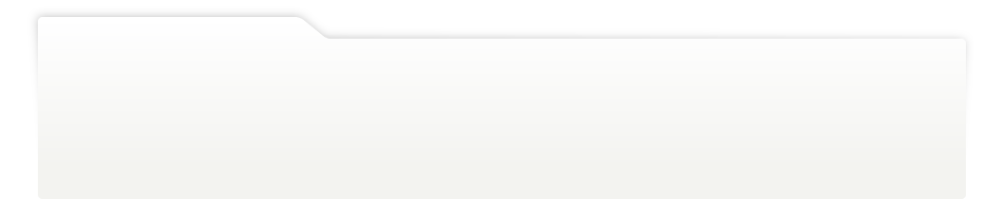
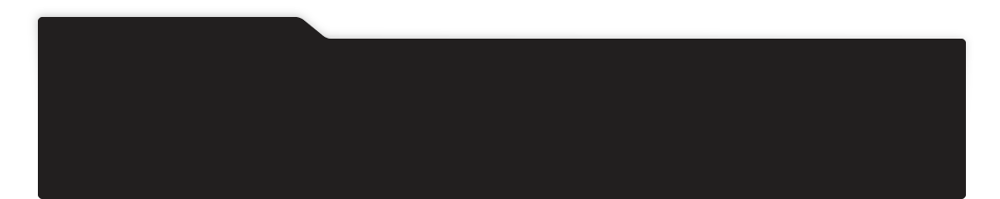
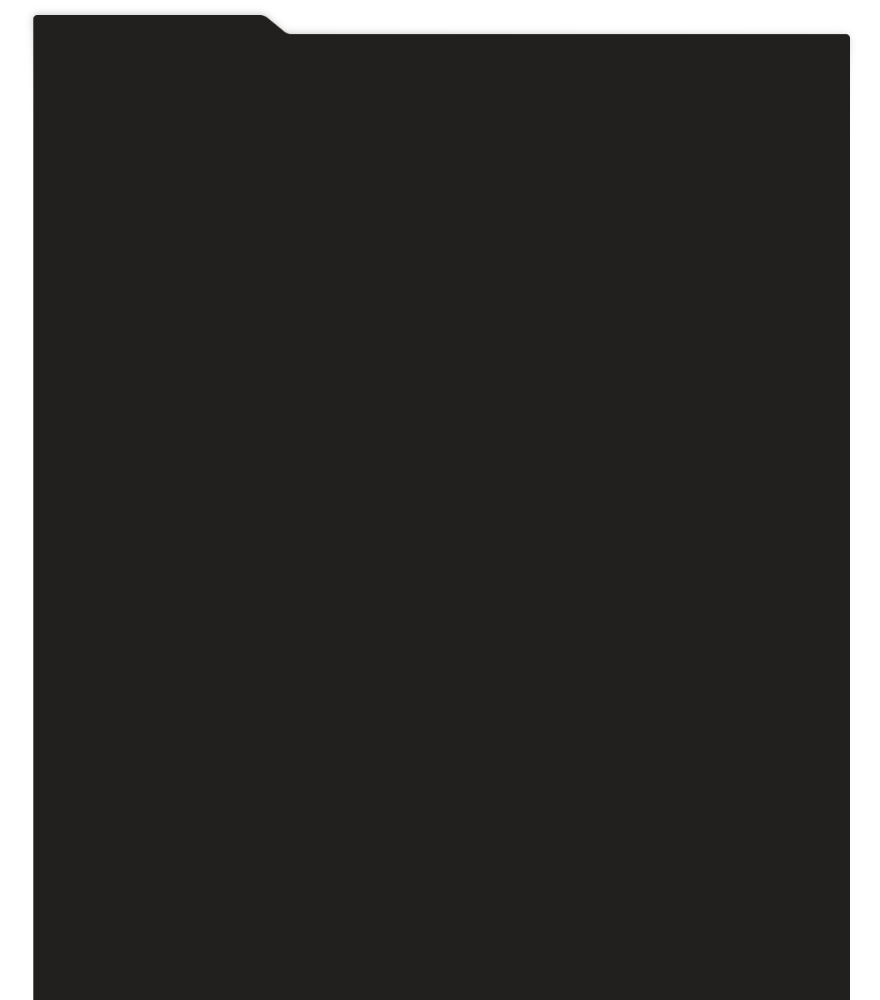
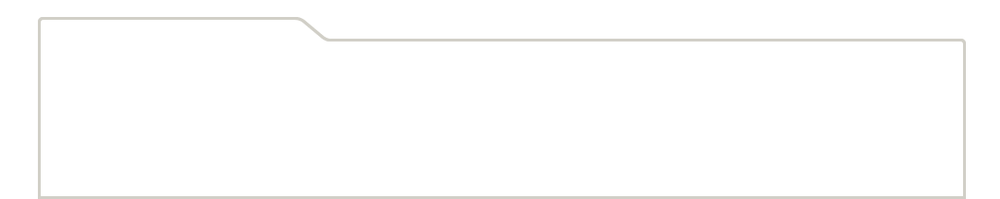
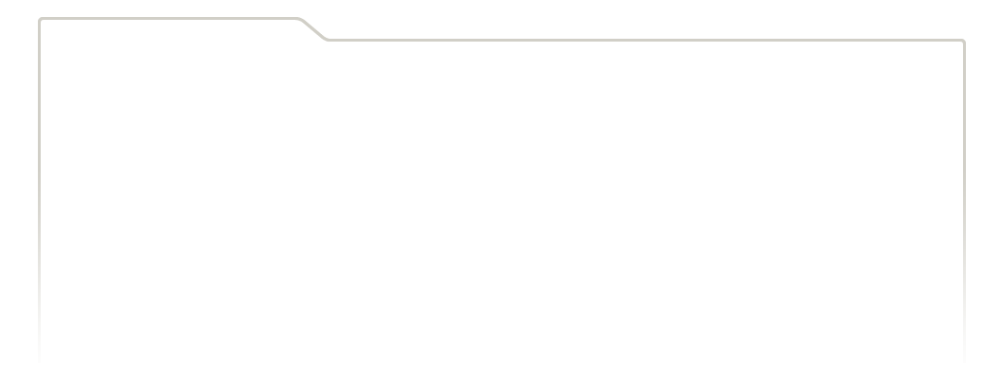
...
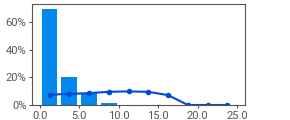
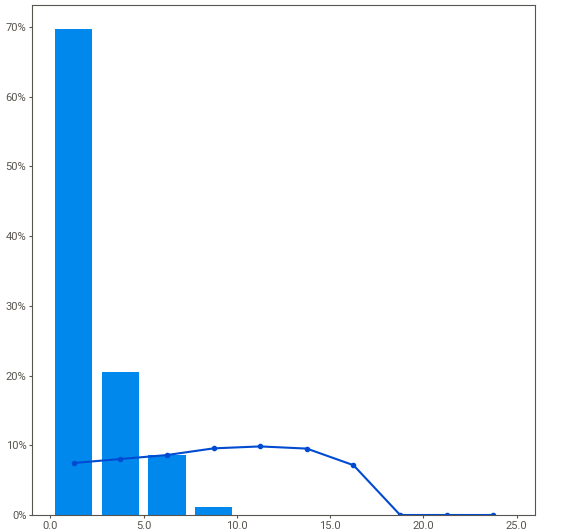
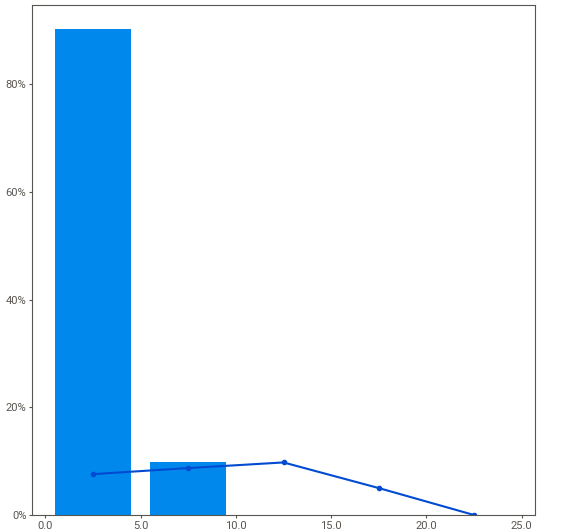
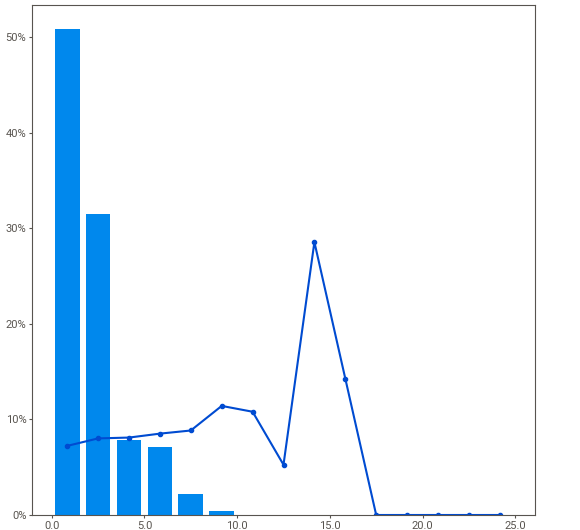
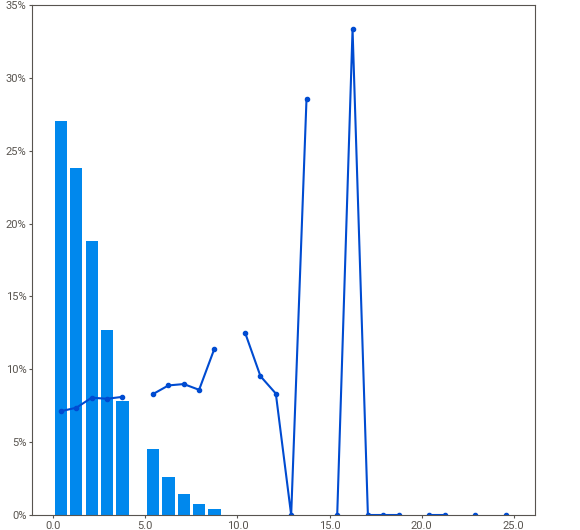

In [ ]:
if do_eda:
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")

        report_eda_1 = sweetviz.analyze(
            [application_train, "application (train)"],
            target_feat="TARGET",
            pairwise_analysis="off",
        )
        report_eda_1.show_notebook()

***

The distribution of the number of children (`CNT_CHILDREN`) is right-skewed, with a few outliers. In the `sweetviz` report, the trends in the distribution are not clear due to the extreme values. The frequency table below shows that the majority of clients have no children and only a few have more than 5-6 children.

In [ ]:
application_train.value_counts("CNT_CHILDREN").sort_index()

CNT_CHILDREN
0     150641
1      42945
2      18697
3       2598
4        280
5         67
6         17
7          6
8          2
9          1
10         2
19         1
Name: count, dtype: int64

Total income (`AMT_INCOME_TOTAL`) is also right-skewed, with a few outliers. Let's categorize values, draw a frequency table and plot the distribution with the most extreme values removed to see the trends more clearly.

In [ ]:
above_1m_count = (
    application_train.assign(
        FLAG_INCOME_TOTAL_ABOVE_1M=lambda df: pd.cut(
            df["AMT_INCOME_TOTAL"],
            bins=[0, 5e5, 1e6, 1.5e6, 2e6, 1e7, np.inf],
            labels=["0-100k", "500k-1M", "1M-1.5M", "1.5M-2M", "2M-10M", "10M+"],
        )
    )
    .value_counts("FLAG_INCOME_TOTAL_ABOVE_1M")
    .sort_index()
)
above_1m_count

FLAG_INCOME_TOTAL_ABOVE_1M
0-100k     213341
500k-1M      1745
1M-1.5M       109
1.5M-2M        29
2M-10M         31
10M+            2
Name: count, dtype: int64

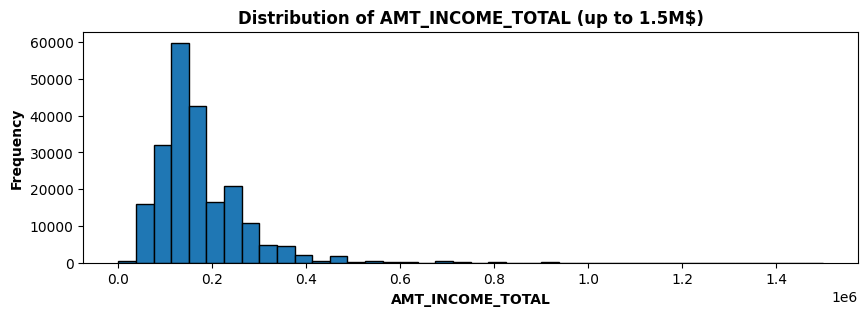

In [ ]:
plt.figure(figsize=(10, 3))
plt.hist(application_train["AMT_INCOME_TOTAL"], bins=40, range=(0, 1.5e6), ec="black")
plt.xlabel("AMT_INCOME_TOTAL")
plt.ylabel("Frequency")
plt.title("Distribution of AMT_INCOME_TOTAL (up to 1.5M$)")
plt.show()

Most of the values in `DAYS_EMPLOYED` are negative, which means that the client is employed. But there is a big positive number (365243) which will be treated as a missing value.

In [ ]:
application_train.value_counts("DAYS_EMPLOYED").sort_index()

DAYS_EMPLOYED
-17583         1
-17546         1
-17522         1
-17139         1
-16849         1
           ...  
-3             2
-2             2
-1             1
 0             1
 365243    38756
Name: count, Length: 11770, dtype: int64

In [ ]:
application_train.eval("DAYS_EMPLOYED > 0").value_counts().sort_index()

DAYS_EMPLOYED
False    176501
True      38756
Name: count, dtype: int64

There are many types of organizations. Value `XNA` should be converted to an explicit missing value:

In [ ]:
application_train.value_counts("ORGANIZATION_TYPE").sort_index()

ORGANIZATION_TYPE
Advertising                 289
Agriculture                1730
Bank                       1735
Business Entity Type 1     4214
Business Entity Type 2     7374
Business Entity Type 3    47582
Cleaning                    195
Construction               4704
Culture                     269
Electricity                 674
Emergency                   395
Government                 7324
Hotel                       686
Housing                    2055
Industry: type 1            737
Industry: type 10            75
Industry: type 11          1888
Industry: type 12           258
Industry: type 13            46
Industry: type 2            326
Industry: type 3           2292
Industry: type 4            633
Industry: type 5            393
Industry: type 6             77
Industry: type 7            903
Industry: type 8             17
Industry: type 9           2396
Insurance                   415
Kindergarten               4891
Legal Services              218
Medicine              

# Modeling (w/o Historical Data)

In this section, a model based only on the data from the main table `application` is built. The historical credit data is not included here.

## Create Pipelines

A few pre-processing steps are defined in this section. The pipelines are created using `sklearn`'s `Pipeline` class.

Some general steps:

In [8]:
# Numeric variables except missing value indicators
select_numeric = make_column_selector(dtype_include="number")

# Categorical variables
select_categorical = make_column_selector(dtype_include="category")

# Create the pipelines
# Use median imputation for numeric variables
numeric_transformer = Pipeline(
    steps=[("imputer", SimpleImputer(strategy="median", add_indicator=True))]
)

# Use one-hot encoding for categorical variables
# and clean column names (remove spaces, special characters, etc.)
categorical_transformer = Pipeline(
    steps=[
        ("onehot", OneHotEncoder(sparse_output=False, handle_unknown="ignore")),
        ("clean_names", CleanColumnNames()),
    ]
)

# Merge pipelines of numeric and categorical variables
pre_processing = ColumnTransformer(
    transformers=[
        ("numeric", numeric_transformer, select_numeric),
        ("categorical", categorical_transformer, select_categorical),
    ],
    verbose_feature_names_out=False,
    remainder="passthrough",
)
pre_processing

ColumnTransformer(remainder='passthrough',
                  transformers=[('numeric',
                                 Pipeline(steps=[('imputer',
                                                  SimpleImputer(add_indicator=True,
                                                                strategy='median'))]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001E1D640F1D0>),
                                ('categorical',
                                 Pipeline(steps=[('onehot',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse_output=False)),
                                                 ('clean_names',
                                                  CleanColumnNames())]),
                                 <sklearn.compose._column_transformer.make_column_selector object at 0x000001E1D640E5D0>)],
                  verbose_feature_names_out=False)

Some pre-processing steps specific to the main table `application` are implemented below. These are:

1) Data cleaning steps;
2) Feature engineering steps.

In feature engineering, variables such as *the number of non-children in the family*, *income per family member* and others are created.

Some variables that might be considered discriminative by the law are (age, sex, and family status) **discarded** from the analysis. Some, which might also be considered unethical (e.g., the day of the week and the hour of the day when the application started) are also **removed**.

In [9]:
class PreprocessorForApplications(BaseEstimator, TransformerMixin):
    """Transformer for the loan grade prediction."""

    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        education_values = [
            "Lower secondary",
            "Secondary / secondary special",
            "Incomplete higher",
            "Higher education",
            "Academic degree",
        ]

        education_dtype = pd.CategoricalDtype(categories=education_values, ordered=True)

        X = X.assign(
            # Extract features
            FLAG_OWN_CAR=lambda df: (df["FLAG_OWN_CAR"] == "Y").astype("Int8"),
            FLAG_OWN_REALTY=lambda df: (df["FLAG_OWN_REALTY"] == "Y").astype("Int8"),
            FLAG_IS_EMERGENCY=lambda df: (df["EMERGENCYSTATE_MODE"] == "Yes").astype(
                "Int8"
            ),
            NAME_EDUCATION_TYPE=lambda df: df["NAME_EDUCATION_TYPE"].astype(
                education_dtype
            ),
            ord_education_type=lambda df: df["NAME_EDUCATION_TYPE"].cat.codes,
            flag_has_children=lambda df: (df["CNT_CHILDREN"] > 0).astype("Int8"),
            DAYS_EMPLOYED=lambda df: df["DAYS_EMPLOYED"].replace(365243, np.nan),
            years_employed=lambda df: df["DAYS_EMPLOYED"] / -365,
            amt_income_total_per_family_member=lambda df: df["AMT_INCOME_TOTAL"]
            / df["CNT_FAM_MEMBERS"],
            cnt_fam_members_excluding_children=lambda df: df["CNT_FAM_MEMBERS"]
            - df["CNT_CHILDREN"],
            amt_annuity_to_credit_ratio=lambda df: df["AMT_ANNUITY"] / df["AMT_CREDIT"],
            amt_annuity_to_income_ratio=lambda df: df["AMT_ANNUITY"]
            / df["AMT_INCOME_TOTAL"],
            amt_credit_to_income_ratio=lambda df: df["AMT_CREDIT"]
            / df["AMT_INCOME_TOTAL"],
            amt_annuity_to_income_per_family_member=lambda df: df["AMT_ANNUITY"]
            / df["amt_income_total_per_family_member"],
            # Make explicit the missing values: XNA → NaN
            ORGANIZATION_TYPE=lambda df: df["ORGANIZATION_TYPE"].replace("XNA", np.nan),
        )
        return X.drop(
            columns=[
                "SK_ID_CURR",
                # Restricted by legal constraints
                "CODE_GENDER",
                "NAME_FAMILY_STATUS",
                "DAYS_BIRTH",
                # Not useful / Unethical
                "WEEKDAY_APPR_PROCESS_START",
                "HOUR_APPR_PROCESS_START",
                # Almost constant
                "FLAG_MOBIL",
                # Already used/processed
                "EMERGENCYSTATE_MODE",
                "DAYS_EMPLOYED",
            ]
        )

    def get_feature_names_out(self):
        pass

## Train Full Model

A *Light Gradient Boosting Machine* (**LGBM**) is used as a model here as it is fast, reasonably accurate and robust to outliers, missing values, and some other issues which means that a few pre-processing steps can be skipped.

In [10]:
lgbm_classifier = LGBMClassifier(
    random_state=1, class_weight="balanced", n_jobs=-1, device="gpu"
)

The model creation in this section will consist of the following steps:

1) `application`-specific pre-processing steps (see code in the previous section);
2) general pre-processing steps for each data type (see the pipeline in the previous section);
3) feature pre-selection removing duplicated and correlated columns;
4) training the model.

In [ ]:
if "models_default_prediction" not in locals():
    models_default_prediction = {}


@my.cache_results(dir_interim + "task-1-applications-only--model-01_lgbm.pickle")
def fit_lgbm_default():
    """Fit a LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor_1", PreprocessorForApplications()),
            ("preprocessor_2", clone(pre_processing)),
            ("drop_duplicate_features", DropDuplicateFeatures()),
            (
                "drop_corr_features",
                SmartCorrelatedSelection(selection_method="variance"),
            ),
            ("classifier", clone(lgbm_classifier)),
        ]
    )
    pipeline.fit(X_train, y_train)
    return pipeline


models_default_prediction["LGBM"] = fit_lgbm_default()
models_default_prediction["LGBM"]

[LightGBM] [Info] Number of positive: 17377, number of negative: 197880
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 6162
[LightGBM] [Info] Number of data points in the train set: 215257, number of used features: 185
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce GTX 950M, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 35 dense feature groups (7.39 MB) transferred to GPU in 0.023343 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


Pipeline(steps=[('preprocessor_1', PreprocessorForApplications()),
                ('preprocessor_2',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('numeric',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(add_indicator=True,
                                                                                 strategy='median'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x0000027560D0E090>),
                                                 ('categorical',
                                                  Pipeline(steps=[(...
                                                                   CleanColumnNames())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x00000275A157FD50>)],
                                   verbose_feature_names_out=False)),
                ('drop_duplicate_features', DropDuplicateFeatures()),
                ('drop_corr_features',
                 SmartCorrelatedSelection(selection_method='variance')),
                ('classifier',
                 LGBMClassifier(class_weight='balanced', device='gpu',
                                n_jobs=-1, random_state=1))])

In [ ]:
feature_names_all = (
    models_default_prediction["LGBM"].named_steps["classifier"].feature_name_
)
print(f"N features used by LGBM: {len(feature_names_all)}")

N features used by LGBM: 197


## Evaluate Models

The model is evaluated on the validation set. For reference, the results are also calculated on the training set.

The main metric to rank modes here and in the other sections is the **ROC AUC** score. The values of other metrics are taken into account too.

In [ ]:
# | code-fold: false
# | label: tbl-loan-status-9-features-train
# | tbl-cap: 'Classification scores for the **train set**.
# |           The rows are sorted by ROC-AUC score.
# |           The best values in each column are highlighted.'

print("--- Train ---")

ml.classification_scores(
    models_default_prediction,
    X_train,
    y_train,
    color="orange",
    sort_by="ROC_AUC",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,215257,0.919,0.714,0.721,0.443,0.292,0.821,0.731,0.712,0.182,0.968,0.799


In [ ]:
# | code-fold: false
# | label: tbl-loan-status-9-features-validation
# | tbl-cap: 'Classification scores for the **validation set**.
# |           The rows are sorted by ROC-AUC score.
# |           The best values in each column are highlighted.'

print("--- Validation ---")

ml.classification_scores(
    models_default_prediction,
    X_validation,
    y_validation,
    sort_by="ROC_AUC",
)

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM,46127,0.919,0.705,0.688,0.375,0.268,0.815,0.667,0.708,0.167,0.960,0.759


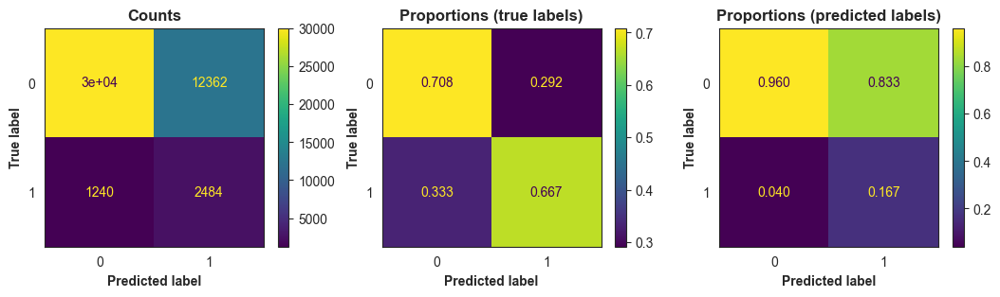

In [ ]:
sns.set_style("white")
y_pred_validation_lgbm = models_default_prediction["LGBM"].predict(X_validation)
ml.plot_confusion_matrices(y_validation, y_pred_validation_lgbm, figsize=(13, 3));

## Feature Importance {#sec-feature-importance-1}

In this section, the feature importance is calculated: both internal LGBM feature importance as well as SHAP values are used. The results indicate that 5 most important features captured by both methods are:

 - the ratio of annuity to credit amount (`amt_annuity_to_credit_ratio`)
 - `EXT_SOURCE_3`
 - `EXT_SOURCE_2`
 - `EXT_SOURCE_1`
 - length of employment (`years_employed`).


*Note.* Feature names in *CAPITALS* indicate that there are the original features from the `application` table and feature names in *lowercase* indicate that the features were derived, extracted or the values were pre-processed.

Find the details below.

In [ ]:
@my.cache_results(dir_interim + "task-1-applications-only--shap_lgbm_k=all.pickle")
def get_shap_values_lgbm():
    model = "LGBM"
    preproc = Pipeline(steps=models_default_prediction[model].steps[:-1])
    classifier = models_default_prediction[model]["classifier"]
    X_validation_preproc = preproc.transform(X_validation)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)
    return shap_values, X_validation_preproc


shap_values_lgbm, data_for_lgbm = get_shap_values_lgbm()

In [ ]:
vals = np.abs(shap_values_lgbm).mean(0).mean(0)
feature_importance = (
    pd.DataFrame(
        list(zip(data_for_lgbm.columns, vals)),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

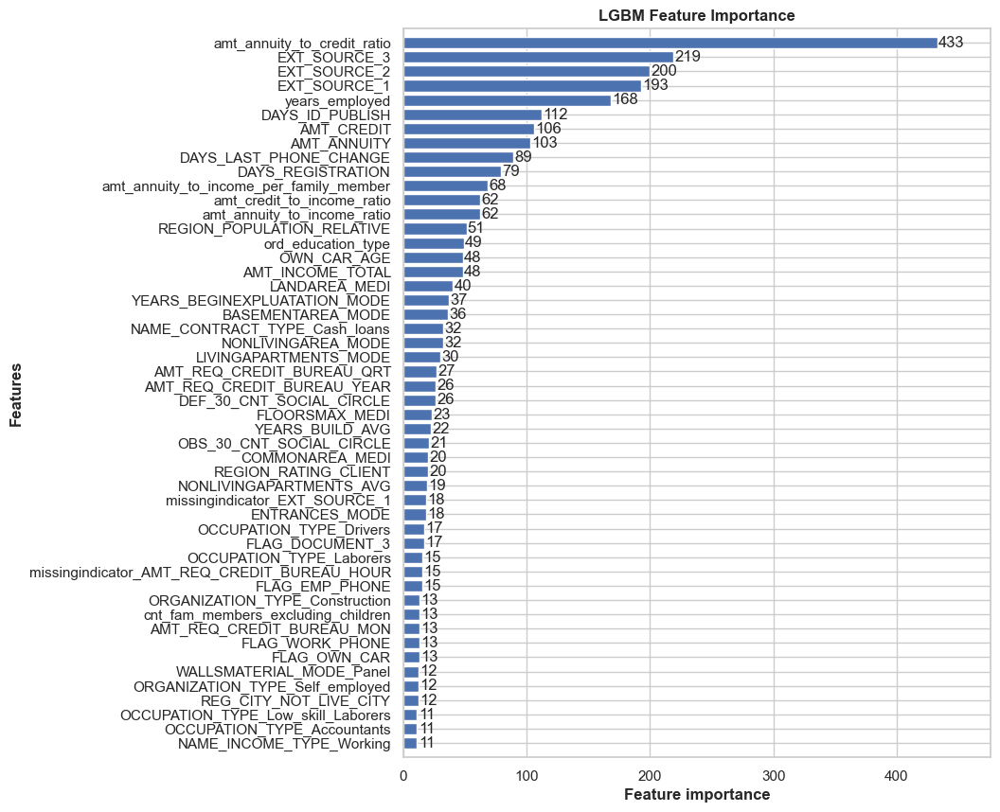

In [ ]:
sns.set_style("whitegrid")
lgb.plot_importance(
    models_default_prediction["LGBM"]["classifier"],
    max_num_features=50,
    figsize=(8, 10),
    height=0.8,
    title="LGBM Feature Importance",
);

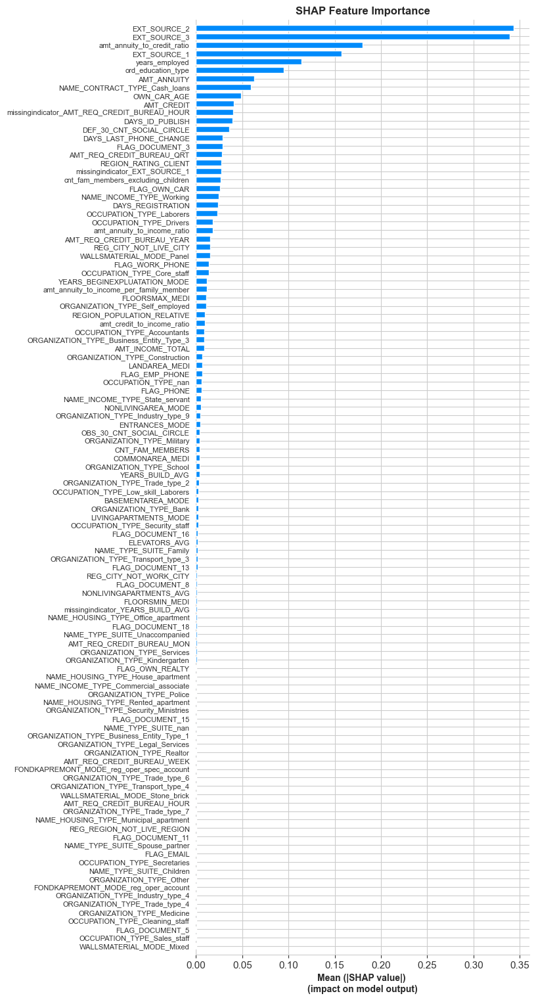

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm[1],
    data_for_lgbm,
    plot_type="bar",
    max_display=110,
    plot_size=(10, 15),
    show=False,
)
plt.tick_params(axis="y", labelsize=8)
plt.title("SHAP Feature Importance", fontsize=12)
plt.xlabel("Mean (|SHAP value|) \n(impact on model output)", fontsize=10);

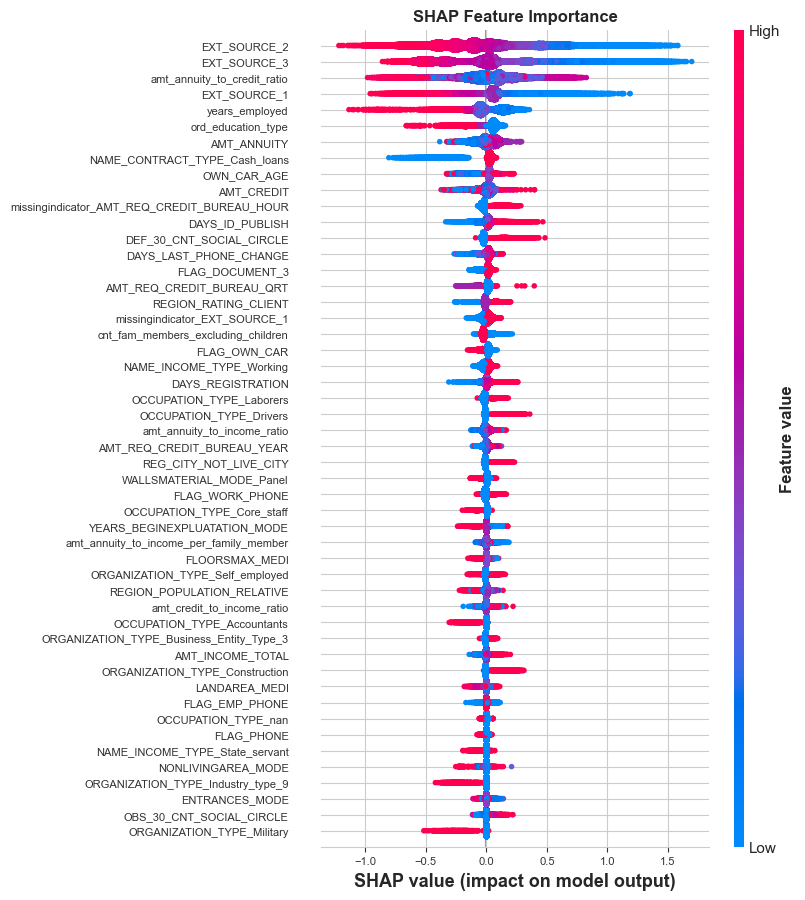

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm[1], data_for_lgbm, max_display=50, plot_size=(10, 9), show=False
)
plt.title("SHAP Feature Importance", fontsize=12)
plt.tick_params(axis="y", labelsize=8)
plt.tick_params(axis="x", labelsize=8)

In [ ]:
# | label: tbl-shap-feature-importance-1
# | tbl-cap: 'SHAP feature importance for the **validation set**.'
# | code-summary: Code of the table
# | code-fold: true

feature_importance.query("importance > 0.00001").style.format(precision=5)

,index,col_name,importance
0,21,EXT_SOURCE_2,0.34360
1,22,EXT_SOURCE_3,0.33933
2,68,amt_annuity_to_credit_ratio,0.18039
3,20,EXT_SOURCE_1,0.15745
4,66,years_employed,0.11401
5,65,ord_education_type,0.09472
6,4,AMT_ANNUITY,0.06261
7,82,NAME_CONTRACT_TYPE_Cash_loans,0.05932
8,8,OWN_CAR_AGE,0.04880
9,3,AMT_CREDIT,0.04073


## Training Models with Feature Selection {#sec-models-with-feature-selection-1}

In this section, LGBM models are trained on the training on **subsets of features**. These subsets are determined **by SHAP values**: 7 thresholds of SHAP values are used to select features.

This method is quicker than sequential feature selection (SFS) but might not be as accurate as not all combinations of features are tested.

Despite the fact, that the validation ROC AUC value was highest in the full model (0.759), the **model with 111 was chosen** for the next steps because ROC AUC is lower just by 0.001 and most of the other metrics are better than in the full model.

Find the details below.

In [ ]:
def fit_lgbm_on_features(features):
    """Template to fit a LGBM model with a smaller number of features."""
    pipeline = Pipeline(
        steps=[
            ("preprocessor_1", PreprocessorForApplications()),
            ("preprocessor_2", clone(pre_processing)),
            ("drop_duplicate_features", DropDuplicateFeatures()),
            (
                "drop_corr_features",
                SmartCorrelatedSelection(selection_method="variance"),
            ),
            ("selector", ColumnSelector(features)),
            ("classifier", clone(lgbm_classifier)),
        ]
    )
    pipeline.fit(X_train, y_train)
    return pipeline


def fit_lgbm_with_shap_threshold(threshold):
    """Function for feature selection based on SHAP values"""
    features = feature_importance.query(f"importance > {threshold}").col_name.to_list()

    k = len(features)

    return f"LGBM ({k} features)", fit_lgbm_on_features(features)

In [ ]:
# Restore from file or calculate
file = dir_interim + "task-1-default--lgbm_models_as_dict.pkl"

if os.path.exists(file):
    with open(file, "rb") as f:
        models_default_prediction = joblib.load(f)
else:
    for threshold in [0.00004, 0.0001, 0.0002, 0.001, 0.003, 0.010, 0.050]:
        model_name, model = fit_lgbm_with_shap_threshold(threshold)
        models_default_prediction[model_name] = model

    # Change name of the full model
    models_default_prediction[
        "LGBM (FULL | 197 feat.)"
    ] = models_default_prediction.pop("LGBM")

    with open(file, "wb") as f:
        joblib.dump(models_default_prediction, f)

del file

# Time: 9m 10.8s

Change model's label to make it easier to understand among other models:

In [ ]:
print("--- Train ---")
ml.classification_scores(
    models_default_prediction,
    X_train,
    y_train,
    sort_by="ROC_AUC",
    color="orange",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (123 features),215257,0.919,0.714,0.722,0.443,0.292,0.821,0.731,0.712,0.182,0.968,0.800
LGBM (FULL | 197 feat.),215257,0.919,0.714,0.721,0.443,0.292,0.821,0.731,0.712,0.182,0.968,0.799
LGBM (98 features),215257,0.919,0.714,0.722,0.444,0.292,0.820,0.733,0.712,0.183,0.968,0.799
LGBM (74 features),215257,0.919,0.713,0.721,0.443,0.292,0.820,0.731,0.712,0.182,0.968,0.799
LGBM (111 features),215257,0.919,0.714,0.721,0.443,0.292,0.820,0.731,0.712,0.182,0.968,0.799
LGBM (55 features),215257,0.919,0.713,0.721,0.441,0.291,0.820,0.730,0.711,0.182,0.968,0.799
LGBM (34 features),215257,0.919,0.711,0.718,0.437,0.289,0.819,0.726,0.710,0.180,0.967,0.796
LGBM (8 features),215257,0.919,0.705,0.708,0.416,0.280,0.814,0.711,0.704,0.174,0.965,0.784


In [ ]:
print("--- Validation ---")
ml.classification_scores(
    models_default_prediction,
    X_validation,
    y_validation,
    sort_by="ROC_AUC",
)

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (FULL | 197 feat.),46127,0.919,0.705,0.688,0.375,0.268,0.815,0.667,0.708,0.167,0.960,0.759
LGBM (123 features),46127,0.919,0.704,0.687,0.375,0.267,0.815,0.668,0.707,0.167,0.960,0.759
LGBM (111 features),46127,0.919,0.705,0.691,0.381,0.269,0.816,0.673,0.708,0.168,0.961,0.758
LGBM (98 features),46127,0.919,0.704,0.689,0.377,0.268,0.814,0.671,0.707,0.167,0.961,0.758
LGBM (74 features),46127,0.919,0.704,0.689,0.377,0.268,0.815,0.670,0.707,0.167,0.961,0.758
LGBM (34 features),46127,0.919,0.703,0.688,0.375,0.267,0.814,0.669,0.706,0.167,0.960,0.758
LGBM (55 features),46127,0.919,0.703,0.688,0.375,0.267,0.814,0.669,0.706,0.167,0.961,0.758
LGBM (8 features),46127,0.919,0.698,0.688,0.376,0.265,0.810,0.675,0.700,0.165,0.961,0.754


## Hyperparameter Tuning {#sec-hyperparam-tuning-1}

The model with 111 features is tuned using **Optuna** package (Bayesian optimization).

In [ ]:
# Features to use: 111 features
feature_names_to_tune_111 = (
    models_default_prediction["LGBM (111 features)"]
    .named_steps["classifier"]
    .feature_name_
)

# Use 3-fold stratified CV
stratified_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=1)

In [ ]:
# Define objective function for Optuna
def objective_1(trial):
    "Objective function for hyperparameter tuning"
    # LGBM params
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 1000, step=50),
        "max_depth": trial.suggest_int("max_depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["gbdt"]),
        # Tree Structure and Complexity
        "num_leaves": trial.suggest_int("num_leaves", 2, 256),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        # Regularization
        "lambda_l1": trial.suggest_float("lambda_l1", 1e-8, 10.0, log=True),
        "lambda_l2": trial.suggest_float("lambda_l2", 1e-8, 10.0, log=True),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 1.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 1.0),
        # Learning Rate and Feature Selection
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "feature_fraction": trial.suggest_float("feature_fraction", 0.4, 1.0),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        # Other Parameters
        "bagging_fraction": trial.suggest_float("bagging_fraction", 0.4, 1.0),
        "bagging_freq": trial.suggest_int("bagging_freq", 1, 7),
        "min_child_weight": trial.suggest_float(
            "min_child_weight", 1e-3, 1e3, log=True
        ),
        "min_split_gain": trial.suggest_float("min_split_gain", 0.0, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 50),
        "max_delta_step": trial.suggest_int("max_delta_step", 0, 10),
    }

    model = LGBMClassifier(
        objective="binary",
        metric="auc",
        random_state=1,
        class_weight="balanced",
        n_jobs=-1,
        device="gpu",
        **params,
    )

    pipeline_to_tune = Pipeline(
        steps=[
            ("preprocessor_1", PreprocessorForApplications()),
            ("preprocessor_2", clone(pre_processing)),
            ("selector", ColumnSelector(feature_names_to_tune_111)),
            ("classifier", model),
        ]
    )

    scores = cross_val_score(
        pipeline_to_tune, X_train, y_train, n_jobs=-1, cv=stratified_kfold
    )

    return scores.mean()


study_name_1 = "tune--without-credit-history"
storage_name_1 = f"sqlite:///{dir_interim}/optuna--{study_name_1}.db"

study_1 = optuna.create_study(
    study_name=study_name_1,
    storage=storage_name_1,
    load_if_exists=True,
    direction="maximize",
)
study_1.optimize(objective_1, n_trials=100, timeout=3600)
# Time: 61m 42.5s

[I 2023-12-27 23:19:35,808] A new study created in RDB with name: tune--without-credit-history
[I 2023-12-27 23:21:36,524] Trial 0 finished with value: 0.8748890771937772 and parameters: {'n_estimators': 700, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 70, 'min_child_samples': 35, 'lambda_l1': 0.025550868350601743, 'lambda_l2': 6.238522519933288e-06, 'reg_alpha': 0.8322445184530112, 'reg_lambda': 0.4781666892844665, 'learning_rate': 0.22386006944324777, 'feature_fraction': 0.605273438694538, 'subsample': 0.2815517349153884, 'colsample_bytree': 0.5105571507272018, 'bagging_fraction': 0.6965379020611673, 'bagging_freq': 5, 'min_child_weight': 0.0659826384593787, 'min_split_gain': 0.04703076905732695, 'min_data_in_leaf': 24, 'max_delta_step': 3}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:23:31,224] Trial 1 finished with value: 0.8719995072472626 and parameters: {'n_estimators': 450, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 213, 'min_child_s

The best set of hyperparameters was found in trial 40 with CV ROC AUC of 0.905.

- 'n_estimators': 950,
- 'max_depth': 10, 
- 'boosting_type': 'gbdt', 
- 'num_leaves': 134, 
- 'min_child_samples': 16, 
- 'lambda_l1': 0.002865600014675554, 
- 'lambda_l2': 0.2596842570474358, 
- 'reg_alpha': 0.7882191530750605, 
- 'reg_lambda': 0.8807986419485984, 
- 'learning_rate': 0.1590297123957936, 
- 'feature_fraction': 0.6798887463051443, 
- 'subsample': 0.4338721676814267, 
- 'colsample_bytree': 0.7119935931199451, 
- 'bagging_fraction': 0.8456859403262338, 
- 'bagging_freq': 1, 
- 'min_child_weight': 0.004745177681063355,
- 'min_split_gain': 0.17818587330243982, 
- 'min_data_in_leaf': 40, 
- 'max_delta_step': 0

## Evaluate Tuned Model {#sec-evaluate-tuned-model-1}

The tuned model with the best set of hyperparameters is evaluated on the validation set. For reference, the results are also calculated on the training set as well.

Warning messages indicate, that as values of some parameters are set, other parameters are ignored. The ignored parameters will not be set.

The results show that on the training set the tuned model performs best, but on the validation set it performs worst. This indicates overfitting. 
Feasible options in this situation may include:

1) tunning the model with fewer features (e.g., 34, as ROC AUC is almost the same as in the model with 111 features);
2) using a simpler model (e.g., Logistic Regression).

Unfortunately, currently, there is not enough time to implement that so the untuned model with 111 features will be selected as the best one.


See the details below.

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>An example of warnings </summary>



```
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_bytree=0.7119935931199451 will be ignored. Current value: feature_fraction=0.6798887463051443
[LightGBM] [Warning] lambda_l1 is set=0.002865600014675554, reg_alpha=0.7882191530750605 will be ignored. Current value: lambda_l1=0.002865600014675554
[LightGBM] [Warning] lambda_l2 is set=0.2596842570474358, reg_lambda=0.8807986419485984 will be ignored. Current value: lambda_l2=0.2596842570474358
[LightGBM] [Warning] bagging_fraction is set=0.8456859403262338, subsample=0.4338721676814267 will be ignored. Current value: bagging_fraction=0.8456859403262338
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_bytree=0.7119935931199451 will be ignored. Current value: feature_fraction=0.6798887463051443
[LightGBM] [Warning] lambda_l1 is set=0.002865600014675554, reg_alpha=0.7882191530750605 will be ignored. Current value: lambda_l1=0.002865600014675554
[LightGBM] [Warning] lambda_l2 is set=0.2596842570474358, reg_lambda=0.8807986419485984 will be ignored. Current value: lambda_l2=0.2596842570474358
[LightGBM] [Warning] bagging_fraction is set=0.8456859403262338, subsample=0.4338721676814267 will be ignored. Current value: bagging_fraction=0.8456859403262338
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
```


</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

In [ ]:
# The ignored parameters are left commented out
params_tuned_1 = {
    "n_estimators": 950,
    "max_depth": 10,
    "boosting_type": "gbdt",
    "num_leaves": 134,
    # "min_child_samples": 16,
    "lambda_l1": 0.002865600014675554,
    "lambda_l2": 0.2596842570474358,
    # "reg_alpha": 0.7882191530750605,
    # "reg_lambda": 0.8807986419485984,
    "learning_rate": 0.1590297123957936,
    "feature_fraction": 0.6798887463051443,
    # "subsample": 0.4338721676814267,
    # "colsample_bytree": 0.7119935931199451,
    "bagging_fraction": 0.8456859403262338,
    "bagging_freq": 1,
    "min_child_weight": 0.004745177681063355,
    "min_split_gain": 0.17818587330243982,
    "min_data_in_leaf": 40,
    "max_delta_step": 0,
}

model_tuned_1 = LGBMClassifier(
    objective="binary",
    metric="auc",
    random_state=1,
    class_weight="balanced",
    n_jobs=-1,
    device="gpu",
    **params_tuned_1,
)

pipeline_with_tuned_model = Pipeline(
    steps=[
        ("preprocessor_1", PreprocessorForApplications()),
        ("preprocessor_2", clone(pre_processing)),
        ("selector", ColumnSelector(feature_names_to_tune_111)),
        ("classifier", clone(model_tuned_1)),
    ]
)

models_default_prediction["LGBM (111 feat. | tuned)"] = pipeline_with_tuned_model.fit(
    X_train, y_train
)
# Time: 3m 20.7s

In [ ]:
performance_train_1 = ml.classification_scores(
    models_default_prediction,
    X_train,
    y_train,
    sort_by="ROC_AUC",
    color="orange",
)

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6798887463051443
[LightGBM] [Warning] lambda_l1 is set=0.002865600014675554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002865600014675554
[LightGBM] [Warning] lambda_l2 is set=0.2596842570474358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2596842570474358
[LightGBM] [Warning] bagging_fraction is set=0.8456859403262338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8456859403262338
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_b

In [ ]:
performance_validation_1 = ml.classification_scores(
    models_default_prediction,
    X_validation,
    y_validation,
    sort_by="ROC_AUC",
)

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6798887463051443
[LightGBM] [Warning] lambda_l1 is set=0.002865600014675554, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.002865600014675554
[LightGBM] [Warning] lambda_l2 is set=0.2596842570474358, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2596842570474358
[LightGBM] [Warning] bagging_fraction is set=0.8456859403262338, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8456859403262338
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] feature_fraction is set=0.6798887463051443, colsample_b

In [ ]:
print("--- Train ---")
performance_train_1

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (111 feat. | tuned),215257,0.919,0.995,0.997,0.995,0.972,0.997,1.000,0.995,0.945,1.000,1.000
LGBM (123 features),215257,0.919,0.714,0.722,0.443,0.292,0.821,0.731,0.712,0.182,0.968,0.800
LGBM (FULL | 197 feat.),215257,0.919,0.714,0.721,0.443,0.292,0.821,0.731,0.712,0.182,0.968,0.799
LGBM (98 features),215257,0.919,0.714,0.722,0.444,0.292,0.820,0.733,0.712,0.183,0.968,0.799
LGBM (74 features),215257,0.919,0.713,0.721,0.443,0.292,0.820,0.731,0.712,0.182,0.968,0.799
LGBM (111 features),215257,0.919,0.714,0.721,0.443,0.292,0.820,0.731,0.712,0.182,0.968,0.799
LGBM (55 features),215257,0.919,0.713,0.721,0.441,0.291,0.820,0.730,0.711,0.182,0.968,0.799
LGBM (34 features),215257,0.919,0.711,0.718,0.437,0.289,0.819,0.726,0.710,0.180,0.967,0.796
LGBM (8 features),215257,0.919,0.705,0.708,0.416,0.280,0.814,0.711,0.704,0.174,0.965,0.784


In [ ]:
print("--- Validation ---")
performance_validation_1

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (FULL | 197 feat.),46127,0.919,0.705,0.688,0.375,0.268,0.815,0.667,0.708,0.167,0.960,0.759
LGBM (123 features),46127,0.919,0.704,0.687,0.375,0.267,0.815,0.668,0.707,0.167,0.960,0.759
LGBM (111 features),46127,0.919,0.705,0.691,0.381,0.269,0.816,0.673,0.708,0.168,0.961,0.758
LGBM (98 features),46127,0.919,0.704,0.689,0.377,0.268,0.814,0.671,0.707,0.167,0.961,0.758
LGBM (74 features),46127,0.919,0.704,0.689,0.377,0.268,0.815,0.670,0.707,0.167,0.961,0.758
LGBM (34 features),46127,0.919,0.703,0.688,0.375,0.267,0.814,0.669,0.706,0.167,0.960,0.758
LGBM (55 features),46127,0.919,0.703,0.688,0.375,0.267,0.814,0.669,0.706,0.167,0.961,0.758
LGBM (8 features),46127,0.919,0.698,0.688,0.376,0.265,0.810,0.675,0.700,0.165,0.961,0.754
LGBM (111 feat. | tuned),46127,0.919,0.896,0.568,0.136,0.215,0.944,0.178,0.959,0.274,0.930,0.716


## Final Evaluation {#sec-final-evaluation-1}

After hyperparameter tuning, the trade-off between model complexity and accuracy was re-considered. Instead of the best-performing model based on 111 features, a much less complex model based on 34 features with comparable performance (AUC = 0.758 which differs by less than 0.0005) was chosen as the final model to be deployed.


The **final performance** of the model based on these features is **AUC = 0.763** (slightly better which can be related to the fact that the model was trained on a larger dataset).

In [ ]:
features_34 = feature_importance.head(34).col_name.to_list()

pipeline_final_1_with_34_feat = Pipeline(
    steps=[
        ("preprocessor_1", PreprocessorForApplications()),
        ("preprocessor_2", clone(pre_processing)),
        ("selector", ColumnSelector(features_34)),
        ("classifier", clone(lgbm_classifier)),
    ]
)

In [ ]:
# For performance evaluation
X_train_validation = pd.concat([X_train, X_validation])
y_train_validation = pd.concat([y_train, y_validation])

file = dir_interim + "task-1-applications-only--lgbm_models_final_1.pkl"

if os.path.exists(file):
    with open(file, "rb") as f:
        models_final_1 = joblib.load(f)
else:
    models_final_1 = {}
    models_final_1["LGBM (34 feat. | final)"] = pipeline_final_1_with_34_feat.fit(
        X_train_validation, y_train_validation
    )
    with open(file, "wb") as f:
        joblib.dump(models_final_1, f)

del file

[LightGBM] [Info] Number of positive: 21101, number of negative: 240283
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 3410
[LightGBM] [Info] Number of data points in the train set: 261384, number of used features: 34
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce GTX 950M, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 17 dense feature groups (4.99 MB) transferred to GPU in 0.013168 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


In [ ]:
print("--- Train ---")

ml.classification_scores(
    models_final_1,
    X_train_validation,
    y_train_validation,
    color="orange",
    sort_by="ROC_AUC",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (34 feat. | final),261384,0.919,0.710,0.714,0.429,0.286,0.818,0.720,0.709,0.178,0.966,0.791


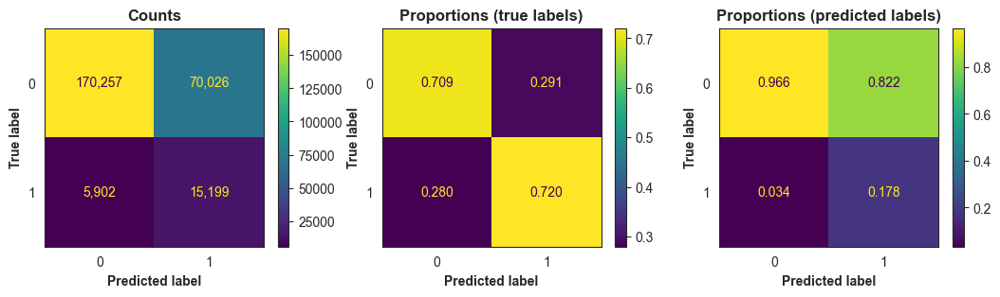

In [ ]:
# | label: fig-confusion-matrices-train-val-1
# | fig-cap: 'Confusion matrices for the joint **train and validation set**.'
# | code-summary: Code of the figure
# | code-fold: true

sns.set_style("white")
y_pred_train_val_1 = models_final_1["LGBM (34 feat. | final)"].predict(
    X_train_validation
)
ml.plot_confusion_matrices(y_train_validation, y_pred_train_val_1, figsize=(13, 3));

In [ ]:
print("--- Test ---")

ml.classification_scores(
    models_final_1,
    X_test,
    y_test,
    sort_by="ROC_AUC",
)

--- Test ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (34 feat. | final),46127,0.919,0.707,0.696,0.392,0.273,0.816,0.683,0.709,0.171,0.962,0.763


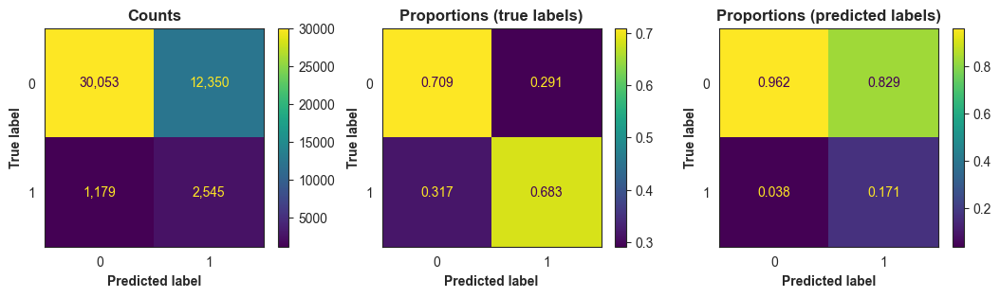

In [ ]:
# | label: fig-confusion-matrices-1
# | fig-cap: 'Confusion matrices for the **test set**.'
# | code-summary: Code of the figure
# | code-fold: true

sns.set_style("white")
y_pred_test_1 = models_final_1["LGBM (34 feat. | final)"].predict(X_test)
ml.plot_confusion_matrices(y_test, y_pred_test_1, figsize=(13, 3));

In [ ]:
# SHAP values for the final model
@my.cache_results(dir_interim + "task-1-applications-only--shap_lgbm_k=34-final.pickle")
def get_shap_values_lgbm_final_1():
    model = "LGBM (34 feat. | final)"
    preproc = Pipeline(steps=models_final_1[model].steps[:-1])
    classifier = models_final_1[model]["classifier"]
    X_test_preproc = preproc.transform(X_test)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_test_preproc)
    return shap_values, X_test_preproc


shap_values_lgbm_test_1, data_for_lgbm_test_1 = get_shap_values_lgbm_final_1()

feature_importance_test_1 = (
    pd.DataFrame(
        list(
            zip(
                data_for_lgbm_test_1.columns,
                np.abs(shap_values_lgbm_test_1).mean(0).mean(0),
            )
        ),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

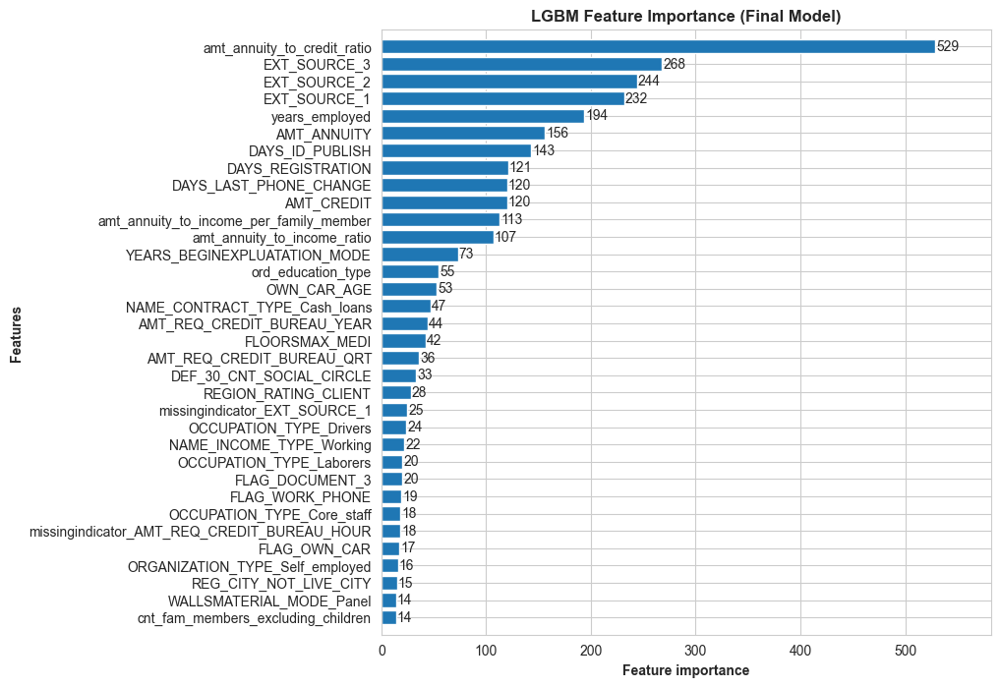

In [ ]:
sns.set_style("whitegrid")
lgb.plot_importance(
    models_final_1["LGBM (34 feat. | final)"]["classifier"],
    max_num_features=50,
    figsize=(8, 8),
    height=0.8,
    title="LGBM Feature Importance (Final Model)",
);

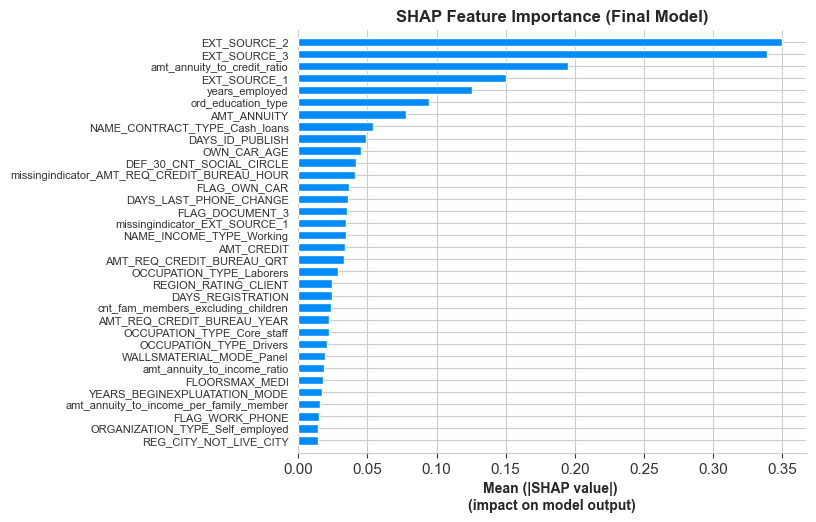

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_test_1[1],
    data_for_lgbm_test_1,
    plot_type="bar",
    max_display=50,
    plot_size=(10, 5),
    show=False,
)
plt.tick_params(axis="y", labelsize=8)
plt.title("SHAP Feature Importance (Final Model)", fontsize=12)
plt.xlabel("Mean (|SHAP value|) \n(impact on model output)", fontsize=10);

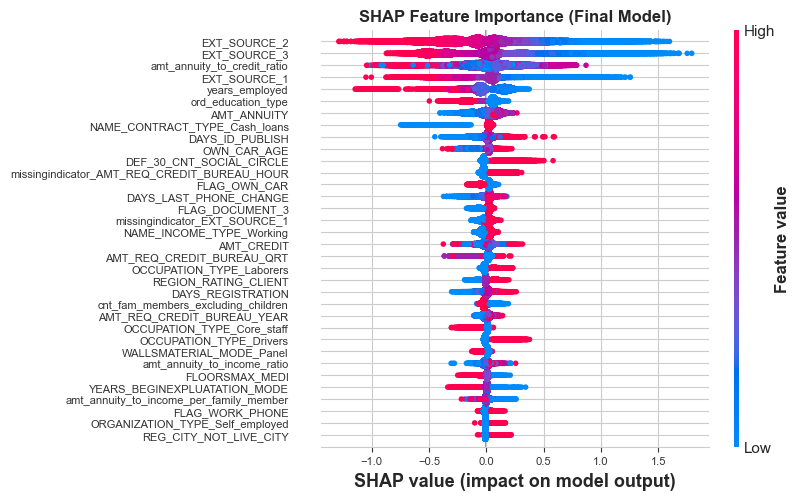

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_test_1[1],
    data_for_lgbm_test_1,
    max_display=50,
    plot_size=(10, 5),
    show=False,
)
plt.title("SHAP Feature Importance (Final Model)", fontsize=12)
plt.tick_params(axis="y", labelsize=8)
plt.tick_params(axis="x", labelsize=8)

<!-- 

[I 2023-12-27 23:19:35,808] A new study created in RDB with name: tune--without-credit-history
[I 2023-12-27 23:21:36,524] Trial 0 finished with value: 0.8748890771937772 and parameters: {'n_estimators': 700, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 70, 'min_child_samples': 35, 'lambda_l1': 0.025550868350601743, 'lambda_l2': 6.238522519933288e-06, 'reg_alpha': 0.8322445184530112, 'reg_lambda': 0.4781666892844665, 'learning_rate': 0.22386006944324777, 'feature_fraction': 0.605273438694538, 'subsample': 0.2815517349153884, 'colsample_bytree': 0.5105571507272018, 'bagging_fraction': 0.6965379020611673, 'bagging_freq': 5, 'min_child_weight': 0.0659826384593787, 'min_split_gain': 0.04703076905732695, 'min_data_in_leaf': 24, 'max_delta_step': 3}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:23:31,224] Trial 1 finished with value: 0.8719995072472626 and parameters: {'n_estimators': 450, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 213, 'min_child_samples': 85, 'lambda_l1': 1.661141373652044e-05, 'lambda_l2': 0.004818453214986181, 'reg_alpha': 0.4467088053506053, 'reg_lambda': 0.8312315360481795, 'learning_rate': 0.14446555019790158, 'feature_fraction': 0.9148147970988095, 'subsample': 0.06025781999414132, 'colsample_bytree': 0.12426740411827782, 'bagging_fraction': 0.819760663190308, 'bagging_freq': 5, 'min_child_weight': 0.13983078649703026, 'min_split_gain': 0.9980604904877477, 'min_data_in_leaf': 39, 'max_delta_step': 8}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:25:13,496] Trial 2 finished with value: 0.8716975552657328 and parameters: {'n_estimators': 1000, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 217, 'min_child_samples': 81, 'lambda_l1': 0.009261946937607285, 'lambda_l2': 0.06187411358260759, 'reg_alpha': 0.8360855695430213, 'reg_lambda': 0.924252800361061, 'learning_rate': 0.2656294979420381, 'feature_fraction': 0.465108015073728, 'subsample': 0.45509562950354704, 'colsample_bytree': 0.8388483403850614, 'bagging_fraction': 0.7223922062864684, 'bagging_freq': 6, 'min_child_weight': 4.831699218012537, 'min_split_gain': 0.962711189116782, 'min_data_in_leaf': 35, 'max_delta_step': 2}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:25:33,913] Trial 3 finished with value: 0.6886373087416217 and parameters: {'n_estimators': 300, 'max_depth': 3, 'boosting_type': 'gbdt', 'num_leaves': 248, 'min_child_samples': 33, 'lambda_l1': 0.004828148870358621, 'lambda_l2': 3.7703945012157024e-08, 'reg_alpha': 0.59959488943298, 'reg_lambda': 0.1437503088550186, 'learning_rate': 0.0378365539137563, 'feature_fraction': 0.8254606113930397, 'subsample': 0.8122840147057663, 'colsample_bytree': 0.9718079730031982, 'bagging_fraction': 0.5958803375842794, 'bagging_freq': 7, 'min_child_weight': 27.943197609701645, 'min_split_gain': 0.22052965204241526, 'min_data_in_leaf': 39, 'max_delta_step': 9}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:27:54,032] Trial 4 finished with value: 0.8427321660875374 and parameters: {'n_estimators': 950, 'max_depth': 7, 'boosting_type': 'gbdt', 'num_leaves': 243, 'min_child_samples': 13, 'lambda_l1': 3.167458423762587e-07, 'lambda_l2': 2.0396359964114315e-05, 'reg_alpha': 0.9294582973364317, 'reg_lambda': 0.5563919876289434, 'learning_rate': 0.07876875308940313, 'feature_fraction': 0.7357755986308083, 'subsample': 0.21739585888299084, 'colsample_bytree': 0.7852352864892946, 'bagging_fraction': 0.7029190171696713, 'bagging_freq': 2, 'min_child_weight': 1.5343452877981487, 'min_split_gain': 0.9847878845340966, 'min_data_in_leaf': 4, 'max_delta_step': 6}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:28:43,962] Trial 5 finished with value: 0.7071918616650716 and parameters: {'n_estimators': 850, 'max_depth': 4, 'boosting_type': 'gbdt', 'num_leaves': 144, 'min_child_samples': 26, 'lambda_l1': 0.01415493365081948, 'lambda_l2': 0.006424681506007423, 'reg_alpha': 0.6180900050335616, 'reg_lambda': 0.29405590359524547, 'learning_rate': 0.02219633676489674, 'feature_fraction': 0.9691971625917661, 'subsample': 0.11557394834032685, 'colsample_bytree': 0.062123273241513156, 'bagging_fraction': 0.6974205405994247, 'bagging_freq': 4, 'min_child_weight': 0.003574530682905926, 'min_split_gain': 0.9711972007891173, 'min_data_in_leaf': 49, 'max_delta_step': 4}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:29:58,291] Trial 6 finished with value: 0.7174493746075338 and parameters: {'n_estimators': 1000, 'max_depth': 5, 'boosting_type': 'gbdt', 'num_leaves': 25, 'min_child_samples': 9, 'lambda_l1': 1.1640499253732652, 'lambda_l2': 1.4978615689896486, 'reg_alpha': 0.6703920743197584, 'reg_lambda': 0.6951344076255069, 'learning_rate': 0.03934371100464988, 'feature_fraction': 0.5426727265714434, 'subsample': 0.9003412951794741, 'colsample_bytree': 0.9572435750544385, 'bagging_fraction': 0.7122492104249079, 'bagging_freq': 2, 'min_child_weight': 383.3789145469394, 'min_split_gain': 0.13037245311437773, 'min_data_in_leaf': 15, 'max_delta_step': 0}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:30:36,511] Trial 7 finished with value: 0.6979471073413656 and parameters: {'n_estimators': 750, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 25, 'min_child_samples': 45, 'lambda_l1': 0.00036467107284622217, 'lambda_l2': 0.9664719945485747, 'reg_alpha': 0.0037572914004266877, 'reg_lambda': 0.35831306235287763, 'learning_rate': 0.06805395733114952, 'feature_fraction': 0.5522713863361657, 'subsample': 0.28819032440828074, 'colsample_bytree': 0.5917850497085058, 'bagging_fraction': 0.9832808929105473, 'bagging_freq': 4, 'min_child_weight': 0.059396449073026505, 'min_split_gain': 0.8609953778780896, 'min_data_in_leaf': 2, 'max_delta_step': 4}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:32:39,473] Trial 8 finished with value: 0.7632829528249984 and parameters: {'n_estimators': 700, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 183, 'min_child_samples': 86, 'lambda_l1': 0.43707893573098267, 'lambda_l2': 1.1063823368943688e-07, 'reg_alpha': 0.37683976035684597, 'reg_lambda': 0.7766568902763252, 'learning_rate': 0.011339287234428277, 'feature_fraction': 0.5522059526815742, 'subsample': 0.7322810968584744, 'colsample_bytree': 0.17684575464900754, 'bagging_fraction': 0.6152408818469279, 'bagging_freq': 1, 'min_child_weight': 0.07350345998766064, 'min_split_gain': 0.6272191527067923, 'min_data_in_leaf': 46, 'max_delta_step': 9}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:32:58,013] Trial 9 finished with value: 0.6852599447300033 and parameters: {'n_estimators': 450, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 16, 'min_child_samples': 13, 'lambda_l1': 0.0070758192800633914, 'lambda_l2': 0.13717467880445933, 'reg_alpha': 0.7362306944558158, 'reg_lambda': 0.3272592750320643, 'learning_rate': 0.029383915056277837, 'feature_fraction': 0.8289326333877685, 'subsample': 0.9345982070505822, 'colsample_bytree': 0.2984780648394578, 'bagging_fraction': 0.925810197700263, 'bagging_freq': 1, 'min_child_weight': 49.251384853626384, 'min_split_gain': 0.008451976684397788, 'min_data_in_leaf': 2, 'max_delta_step': 6}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:33:28,532] Trial 10 finished with value: 0.7684488721125219 and parameters: {'n_estimators': 150, 'max_depth': 7, 'boosting_type': 'gbdt', 'num_leaves': 87, 'min_child_samples': 65, 'lambda_l1': 4.891527454057723, 'lambda_l2': 1.7766807872936614e-05, 'reg_alpha': 0.9978156714517683, 'reg_lambda': 0.0016067837261933837, 'learning_rate': 0.2611021234227985, 'feature_fraction': 0.6516022331735631, 'subsample': 0.4763179523459447, 'colsample_bytree': 0.4636511039806581, 'bagging_fraction': 0.46156670236544706, 'bagging_freq': 5, 'min_child_weight': 0.0014304249163018315, 'min_split_gain': 0.3246805866112631, 'min_data_in_leaf': 23, 'max_delta_step': 0}. Best is trial 0 with value: 0.8748890771937772.
[I 2023-12-27 23:35:15,562] Trial 11 finished with value: 0.8782710858654724 and parameters: {'n_estimators': 500, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 113, 'min_child_samples': 98, 'lambda_l1': 2.8861819174336533e-06, 'lambda_l2': 0.0007058725506922919, 'reg_alpha': 0.42669822608800045, 'reg_lambda': 0.9783691932791746, 'learning_rate': 0.14222487027417705, 'feature_fraction': 0.9635586125518529, 'subsample': 0.050624589771094415, 'colsample_bytree': 0.342473029527568, 'bagging_fraction': 0.8553943871270485, 'bagging_freq': 5, 'min_child_weight': 0.15274206501441348, 'min_split_gain': 0.4461762335815785, 'min_data_in_leaf': 27, 'max_delta_step': 7}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:36:53,579] Trial 12 finished with value: 0.8738531048568623 and parameters: {'n_estimators': 600, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 87, 'min_child_samples': 99, 'lambda_l1': 1.3423524891267378e-07, 'lambda_l2': 0.00013164904456447555, 'reg_alpha': 0.3753630433121057, 'reg_lambda': 0.9897294778233382, 'learning_rate': 0.14170726301672681, 'feature_fraction': 0.9980175031070498, 'subsample': 0.22833986121884964, 'colsample_bytree': 0.39512367125352293, 'bagging_fraction': 0.8724062667064009, 'bagging_freq': 5, 'min_child_weight': 0.2622582690107168, 'min_split_gain': 0.4416845674532798, 'min_data_in_leaf': 22, 'max_delta_step': 3}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:38:25,091] Trial 13 finished with value: 0.8620160976845547 and parameters: {'n_estimators': 600, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 84, 'min_child_samples': 57, 'lambda_l1': 4.833402031282412e-06, 'lambda_l2': 2.5977647272347386e-06, 'reg_alpha': 0.5195545278104725, 'reg_lambda': 0.5971811647641649, 'learning_rate': 0.14126902389604182, 'feature_fraction': 0.6877658982489735, 'subsample': 0.056309405751741703, 'colsample_bytree': 0.5861630773127292, 'bagging_fraction': 0.8123145203990759, 'bagging_freq': 7, 'min_child_weight': 0.014161748826676928, 'min_split_gain': 0.523022406210781, 'min_data_in_leaf': 30, 'max_delta_step': 7}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:39:35,072] Trial 14 finished with value: 0.8780248740132749 and parameters: {'n_estimators': 300, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 129, 'min_child_samples': 40, 'lambda_l1': 3.159875322258148e-08, 'lambda_l2': 0.0009420741355173971, 'reg_alpha': 0.8079070267854085, 'reg_lambda': 0.47196676315342473, 'learning_rate': 0.28064826534912485, 'feature_fraction': 0.4100906099818725, 'subsample': 0.32040123209157056, 'colsample_bytree': 0.2884983489599452, 'bagging_fraction': 0.823637627022563, 'bagging_freq': 3, 'min_child_weight': 0.01352913024023231, 'min_split_gain': 0.009335610475266924, 'min_data_in_leaf': 14, 'max_delta_step': 2}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:40:07,058] Trial 15 finished with value: 0.7674314856025837 and parameters: {'n_estimators': 100, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 135, 'min_child_samples': 64, 'lambda_l1': 1.1093894693363508e-08, 'lambda_l2': 0.0007252146370295743, 'reg_alpha': 0.26404462746108115, 'reg_lambda': 0.674582771693113, 'learning_rate': 0.09954423258559975, 'feature_fraction': 0.4089650219134541, 'subsample': 0.38088460195602175, 'colsample_bytree': 0.26963460056226346, 'bagging_fraction': 0.9894528142903561, 'bagging_freq': 3, 'min_child_weight': 0.015885521142713823, 'min_split_gain': 0.2231871227491393, 'min_data_in_leaf': 10, 'max_delta_step': 10}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:41:25,977] Trial 16 finished with value: 0.8775463754838221 and parameters: {'n_estimators': 300, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 165, 'min_child_samples': 49, 'lambda_l1': 2.979801132039705e-06, 'lambda_l2': 0.00025417590238099034, 'reg_alpha': 0.7249036921470404, 'reg_lambda': 0.8202778015863035, 'learning_rate': 0.18006312787180753, 'feature_fraction': 0.7370066028683423, 'subsample': 0.596637826806498, 'colsample_bytree': 0.33624300721567546, 'bagging_fraction': 0.8764736731421038, 'bagging_freq': 3, 'min_child_weight': 0.5791617342788797, 'min_split_gain': 0.3512094898270119, 'min_data_in_leaf': 16, 'max_delta_step': 2}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:42:32,478] Trial 17 finished with value: 0.8545180808335937 and parameters: {'n_estimators': 300, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 114, 'min_child_samples': 74, 'lambda_l1': 1.0424205102368452e-08, 'lambda_l2': 8.250065245439023, 'reg_alpha': 0.5771786186662261, 'reg_lambda': 0.46386315662637, 'learning_rate': 0.2743647210971697, 'feature_fraction': 0.43022418099957055, 'subsample': 0.15288268840229252, 'colsample_bytree': 0.212170834584281, 'bagging_fraction': 0.7965514894530638, 'bagging_freq': 3, 'min_child_weight': 0.009215891417021284, 'min_split_gain': 0.13522409806794833, 'min_data_in_leaf': 16, 'max_delta_step': 5}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:43:52,718] Trial 18 finished with value: 0.840214250784558 and parameters: {'n_estimators': 400, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 118, 'min_child_samples': 97, 'lambda_l1': 4.028505692985566e-05, 'lambda_l2': 0.0024298720059222328, 'reg_alpha': 0.8068097048036752, 'reg_lambda': 0.658718828376563, 'learning_rate': 0.11360943815373552, 'feature_fraction': 0.480041144602146, 'subsample': 0.3602857201118521, 'colsample_bytree': 0.39457375811046463, 'bagging_fraction': 0.912398175273994, 'bagging_freq': 6, 'min_child_weight': 0.001030133654874284, 'min_split_gain': 0.6525591832264386, 'min_data_in_leaf': 30, 'max_delta_step': 1}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:44:19,977] Trial 19 finished with value: 0.7405938010394489 and parameters: {'n_estimators': 200, 'max_depth': 5, 'boosting_type': 'gbdt', 'num_leaves': 57, 'min_child_samples': 39, 'lambda_l1': 3.2047555533872153e-07, 'lambda_l2': 0.020605679980235606, 'reg_alpha': 0.5068287729814005, 'reg_lambda': 0.9227978766682805, 'learning_rate': 0.2064521033259073, 'feature_fraction': 0.8044307556062196, 'subsample': 0.17588926419955378, 'colsample_bytree': 0.208274754943567, 'bagging_fraction': 0.8068835108366229, 'bagging_freq': 2, 'min_child_weight': 0.709777498318447, 'min_split_gain': 0.3098974642919132, 'min_data_in_leaf': 10, 'max_delta_step': 8}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:44:42,086] Trial 20 finished with value: 0.7612528170842955 and parameters: {'n_estimators': 50, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 158, 'min_child_samples': 24, 'lambda_l1': 1.1944409555908412e-06, 'lambda_l2': 0.0006399993856977176, 'reg_alpha': 0.6904445761992442, 'reg_lambda': 0.5190310484924262, 'learning_rate': 0.1782897440083468, 'feature_fraction': 0.9016233224676775, 'subsample': 0.5730556441213499, 'colsample_bytree': 0.06783581520353882, 'bagging_fraction': 0.8596259140100362, 'bagging_freq': 4, 'min_child_weight': 0.026274533589895142, 'min_split_gain': 0.016636042354496304, 'min_data_in_leaf': 29, 'max_delta_step': 6}. Best is trial 11 with value: 0.8782710858654724.
[I 2023-12-27 23:46:01,622] Trial 21 finished with value: 0.8833719634667491 and parameters: {'n_estimators': 300, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 177, 'min_child_samples': 45, 'lambda_l1': 3.4991269944278816e-06, 'lambda_l2': 0.0002491284134385983, 'reg_alpha': 0.7480374305092647, 'reg_lambda': 0.8248409723216801, 'learning_rate': 0.1901342759969906, 'feature_fraction': 0.7462514961118765, 'subsample': 0.5970550676337194, 'colsample_bytree': 0.36799990149343387, 'bagging_fraction': 0.9183731050628999, 'bagging_freq': 3, 'min_child_weight': 0.36135045191782317, 'min_split_gain': 0.40707406736393204, 'min_data_in_leaf': 16, 'max_delta_step': 2}. Best is trial 21 with value: 0.8833719634667491.
[I 2023-12-27 23:47:15,553] Trial 22 finished with value: 0.8881755261066901 and parameters: {'n_estimators': 250, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 197, 'min_child_samples': 54, 'lambda_l1': 6.487095526319997e-08, 'lambda_l2': 0.0017328406272876602, 'reg_alpha': 0.8954019209806247, 'reg_lambda': 0.7574800975978729, 'learning_rate': 0.28442706550634245, 'feature_fraction': 0.7823651612335393, 'subsample': 0.6274888850559157, 'colsample_bytree': 0.3549984446040611, 'bagging_fraction': 0.9350132824135351, 'bagging_freq': 3, 'min_child_weight': 0.18974615877784037, 'min_split_gain': 0.47269394006479004, 'min_data_in_leaf': 20, 'max_delta_step': 2}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:48:14,237] Trial 23 finished with value: 0.851493793278416 and parameters: {'n_estimators': 200, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 190, 'min_child_samples': 57, 'lambda_l1': 9.149873937494441e-08, 'lambda_l2': 9.731946260935053e-05, 'reg_alpha': 0.9412953784916732, 'reg_lambda': 0.7672495740592127, 'learning_rate': 0.18715023155531416, 'feature_fraction': 0.7729667315426292, 'subsample': 0.6467429302022853, 'colsample_bytree': 0.39652678699156313, 'bagging_fraction': 0.9486007346471711, 'bagging_freq': 4, 'min_child_weight': 0.16338460855819342, 'min_split_gain': 0.4593591636130272, 'min_data_in_leaf': 20, 'max_delta_step': 1}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:49:35,797] Trial 24 finished with value: 0.8814626237854742 and parameters: {'n_estimators': 550, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 210, 'min_child_samples': 70, 'lambda_l1': 6.206372509221023e-07, 'lambda_l2': 0.009433328937434073, 'reg_alpha': 0.933946630859976, 'reg_lambda': 0.9954225256080727, 'learning_rate': 0.2988681483708137, 'feature_fraction': 0.8673030919587643, 'subsample': 0.5347153032152265, 'colsample_bytree': 0.34481442679746765, 'bagging_fraction': 0.9428166360548743, 'bagging_freq': 2, 'min_child_weight': 0.41137454052279926, 'min_split_gain': 0.552588353202933, 'min_data_in_leaf': 28, 'max_delta_step': 4}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:50:42,099] Trial 25 finished with value: 0.8713862821743685 and parameters: {'n_estimators': 400, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 215, 'min_child_samples': 66, 'lambda_l1': 5.606353525411963e-07, 'lambda_l2': 0.01645968116387086, 'reg_alpha': 0.900328990911367, 'reg_lambda': 0.8882478647335285, 'learning_rate': 0.2995296376396346, 'feature_fraction': 0.8653931193758865, 'subsample': 0.6956790691548889, 'colsample_bytree': 0.4605688189731501, 'bagging_fraction': 0.9963554434544024, 'bagging_freq': 2, 'min_child_weight': 1.3790999793509264, 'min_split_gain': 0.5500198236137742, 'min_data_in_leaf': 8, 'max_delta_step': 4}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:51:58,432] Trial 26 finished with value: 0.8757299330182601 and parameters: {'n_estimators': 600, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 194, 'min_child_samples': 73, 'lambda_l1': 3.458832037131109e-08, 'lambda_l2': 0.01062829757405875, 'reg_alpha': 0.9090182869071985, 'reg_lambda': 0.8535617462549212, 'learning_rate': 0.2068294241225185, 'feature_fraction': 0.763010580961449, 'subsample': 0.5453704964594214, 'colsample_bytree': 0.24605307868957346, 'bagging_fraction': 0.942644568029684, 'bagging_freq': 1, 'min_child_weight': 0.42312410212590734, 'min_split_gain': 0.616416087546423, 'min_data_in_leaf': 20, 'max_delta_step': 3}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:52:43,882] Trial 27 finished with value: 0.8116483935336053 and parameters: {'n_estimators': 200, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 229, 'min_child_samples': 52, 'lambda_l1': 8.577767779820766e-07, 'lambda_l2': 0.0018848346117680019, 'reg_alpha': 0.9868091766180361, 'reg_lambda': 0.9828569897195489, 'learning_rate': 0.21901708186437807, 'feature_fraction': 0.8703601172344868, 'subsample': 0.4981492493361206, 'colsample_bytree': 0.1845769619284794, 'bagging_fraction': 0.9078603509428422, 'bagging_freq': 3, 'min_child_weight': 3.1809205085934575, 'min_split_gain': 0.6988582226953822, 'min_data_in_leaf': 34, 'max_delta_step': 1}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:54:13,932] Trial 28 finished with value: 0.8534635288851998 and parameters: {'n_estimators': 350, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 173, 'min_child_samples': 60, 'lambda_l1': 1.145739349972685e-07, 'lambda_l2': 0.00013318361338986002, 'reg_alpha': 0.7665287665052277, 'reg_lambda': 0.7432817893085424, 'learning_rate': 0.10513798925474571, 'feature_fraction': 0.7015728921275299, 'subsample': 0.6058590655055107, 'colsample_bytree': 0.3606173051524219, 'bagging_fraction': 0.9616218937977218, 'bagging_freq': 2, 'min_child_weight': 0.46816099764162866, 'min_split_gain': 0.39738802885664537, 'min_data_in_leaf': 18, 'max_delta_step': 5}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:55:11,491] Trial 29 finished with value: 0.8186632554762338 and parameters: {'n_estimators': 550, 'max_depth': 6, 'boosting_type': 'gbdt', 'num_leaves': 199, 'min_child_samples': 71, 'lambda_l1': 1.9300245738733512e-05, 'lambda_l2': 0.06529332322007117, 'reg_alpha': 0.8540002668256893, 'reg_lambda': 0.8910470873527566, 'learning_rate': 0.2322779764126315, 'feature_fraction': 0.7815730411921928, 'subsample': 0.4178043783507136, 'colsample_bytree': 0.44913002804719304, 'bagging_fraction': 0.997686972664943, 'bagging_freq': 3, 'min_child_weight': 0.047450020650408674, 'min_split_gain': 0.5261641319776578, 'min_data_in_leaf': 27, 'max_delta_step': 3}. Best is trial 22 with value: 0.8881755261066901.
[I 2023-12-27 23:57:55,258] Trial 30 finished with value: 0.8921939752528024 and parameters: {'n_estimators': 700, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 152, 'min_child_samples': 33, 'lambda_l1': 0.00011264523436153885, 'lambda_l2': 0.002535426217214707, 'reg_alpha': 0.8531783896338508, 'reg_lambda': 0.8386482461746168, 'learning_rate': 0.22932817006049094, 'feature_fraction': 0.6501957138290259, 'subsample': 0.519408739568785, 'colsample_bytree': 0.5360604044432666, 'bagging_fraction': 0.9107998816579961, 'bagging_freq': 2, 'min_child_weight': 0.23203258978937152, 'min_split_gain': 0.3946794330666563, 'min_data_in_leaf': 25, 'max_delta_step': 3}. Best is trial 30 with value: 0.8921939752528024.
[I 2023-12-28 00:00:16,380] Trial 31 finished with value: 0.8922264966138842 and parameters: {'n_estimators': 700, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 156, 'min_child_samples': 29, 'lambda_l1': 0.00014582924208031534, 'lambda_l2': 0.00207070770891591, 'reg_alpha': 0.879099482559331, 'reg_lambda': 0.8226420082257161, 'learning_rate': 0.23972844391778333, 'feature_fraction': 0.6389072863404655, 'subsample': 0.4944031203227879, 'colsample_bytree': 0.5442477245125785, 'bagging_fraction': 0.9100444612104912, 'bagging_freq': 2, 'min_child_weight': 0.26729999120841763, 'min_split_gain': 0.39571056657151543, 'min_data_in_leaf': 24, 'max_delta_step': 3}. Best is trial 31 with value: 0.8922264966138842.
[I 2023-12-28 00:02:49,485] Trial 32 finished with value: 0.8989997991337638 and parameters: {'n_estimators': 800, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 149, 'min_child_samples': 26, 'lambda_l1': 9.803860851134294e-05, 'lambda_l2': 0.0030044424373395283, 'reg_alpha': 0.8485579521271137, 'reg_lambda': 0.823632033229195, 'learning_rate': 0.16123569549530453, 'feature_fraction': 0.6545602810054852, 'subsample': 0.5129109164629315, 'colsample_bytree': 0.5255478300943521, 'bagging_fraction': 0.9073804905823786, 'bagging_freq': 1, 'min_child_weight': 0.12693393736639316, 'min_split_gain': 0.3846614060379614, 'min_data_in_leaf': 25, 'max_delta_step': 2}. Best is trial 32 with value: 0.8989997991337638.
[I 2023-12-28 00:05:09,170] Trial 33 finished with value: 0.8958036145465975 and parameters: {'n_estimators': 750, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 151, 'min_child_samples': 25, 'lambda_l1': 0.00013239045157530194, 'lambda_l2': 0.0032071894959281267, 'reg_alpha': 0.8662145021497873, 'reg_lambda': 0.7533395165967287, 'learning_rate': 0.23146274771366598, 'feature_fraction': 0.6289110073229573, 'subsample': 0.45122154653169216, 'colsample_bytree': 0.5406432957366871, 'bagging_fraction': 0.8907563452214535, 'bagging_freq': 1, 'min_child_weight': 0.08022134072683336, 'min_split_gain': 0.3830191281331384, 'min_data_in_leaf': 24, 'max_delta_step': 2}. Best is trial 32 with value: 0.8989997991337638.
[I 2023-12-28 00:07:22,684] Trial 34 finished with value: 0.8897318053882265 and parameters: {'n_estimators': 750, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 150, 'min_child_samples': 23, 'lambda_l1': 0.0002756081233310541, 'lambda_l2': 0.004038521806636954, 'reg_alpha': 0.8368395098367797, 'reg_lambda': 0.8351955687445882, 'learning_rate': 0.15985743765335148, 'feature_fraction': 0.6189789865249556, 'subsample': 0.4704072511809242, 'colsample_bytree': 0.5594715372860741, 'bagging_fraction': 0.7656943167789485, 'bagging_freq': 1, 'min_child_weight': 0.09350196583068483, 'min_split_gain': 0.3716033548247211, 'min_data_in_leaf': 24, 'max_delta_step': 3}. Best is trial 32 with value: 0.8989997991337638.
[I 2023-12-28 00:09:19,708] Trial 35 finished with value: 0.8992227839303806 and parameters: {'n_estimators': 850, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 158, 'min_child_samples': 31, 'lambda_l1': 0.00012594780677761396, 'lambda_l2': 0.04190854332710144, 'reg_alpha': 0.8578304010160532, 'reg_lambda': 0.9082046808688874, 'learning_rate': 0.2269423609657828, 'feature_fraction': 0.6267650752224884, 'subsample': 0.45372996056218884, 'colsample_bytree': 0.6231626398111181, 'bagging_fraction': 0.8942737662563495, 'bagging_freq': 1, 'min_child_weight': 0.03139373537452999, 'min_split_gain': 0.2889146281291505, 'min_data_in_leaf': 34, 'max_delta_step': 1}. Best is trial 35 with value: 0.8992227839303806.
[I 2023-12-28 00:12:12,040] Trial 36 finished with value: 0.8967002186582534 and parameters: {'n_estimators': 850, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 133, 'min_child_samples': 17, 'lambda_l1': 0.0012579716529809257, 'lambda_l2': 0.13286685086210484, 'reg_alpha': 0.7970066890973759, 'reg_lambda': 0.9052548375736079, 'learning_rate': 0.12827308333727266, 'feature_fraction': 0.5947904298434539, 'subsample': 0.42544021303549495, 'colsample_bytree': 0.6185053528543994, 'bagging_fraction': 0.8897744944480148, 'bagging_freq': 1, 'min_child_weight': 0.03348700916069735, 'min_split_gain': 0.28462873394322535, 'min_data_in_leaf': 35, 'max_delta_step': 1}. Best is trial 35 with value: 0.8992227839303806.
[I 2023-12-28 00:15:01,246] Trial 37 finished with value: 0.8975457216031145 and parameters: {'n_estimators': 900, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 102, 'min_child_samples': 17, 'lambda_l1': 0.0010511873817839884, 'lambda_l2': 0.04511572731653093, 'reg_alpha': 0.8013630825405028, 'reg_lambda': 0.9251516562576017, 'learning_rate': 0.1589772264584597, 'feature_fraction': 0.6038001674080635, 'subsample': 0.42037162655371074, 'colsample_bytree': 0.6502318100866276, 'bagging_fraction': 0.8411653909921795, 'bagging_freq': 1, 'min_child_weight': 0.03848395291096782, 'min_split_gain': 0.27887820629397675, 'min_data_in_leaf': 39, 'max_delta_step': 0}. Best is trial 35 with value: 0.8992227839303806.
[I 2023-12-28 00:17:09,325] Trial 38 finished with value: 0.85945636749193 and parameters: {'n_estimators': 900, 'max_depth': 7, 'boosting_type': 'gbdt', 'num_leaves': 100, 'min_child_samples': 18, 'lambda_l1': 0.0009059956557422825, 'lambda_l2': 0.2372632702197369, 'reg_alpha': 0.7913680828324612, 'reg_lambda': 0.9399333038053995, 'learning_rate': 0.12402294496183226, 'feature_fraction': 0.5967861272024316, 'subsample': 0.39973665639568184, 'colsample_bytree': 0.6506821200780779, 'bagging_fraction': 0.835482168603026, 'bagging_freq': 1, 'min_child_weight': 0.02841779979609808, 'min_split_gain': 0.26635896836483625, 'min_data_in_leaf': 41, 'max_delta_step': 0}. Best is trial 35 with value: 0.8992227839303806.
[I 2023-12-28 00:18:37,903] Trial 39 finished with value: 0.8140501732349567 and parameters: {'n_estimators': 850, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 50, 'min_child_samples': 8, 'lambda_l1': 0.0014391679638090364, 'lambda_l2': 0.04193995020208812, 'reg_alpha': 0.6704979008319145, 'reg_lambda': 0.9220114570199825, 'learning_rate': 0.079993010687535, 'feature_fraction': 0.5948035295441012, 'subsample': 0.3540651650868418, 'colsample_bytree': 0.6798399781297993, 'bagging_fraction': 0.752945071168631, 'bagging_freq': 1, 'min_child_weight': 0.007388820142358995, 'min_split_gain': 0.2852848467749537, 'min_data_in_leaf': 35, 'max_delta_step': 1}. Best is trial 35 with value: 0.8992227839303806.
[I 2023-12-28 00:21:16,910] Trial 40 finished with value: 0.9046627973391566 and parameters: {'n_estimators': 950, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 134, 'min_child_samples': 16, 'lambda_l1': 0.002865600014675554, 'lambda_l2': 0.2596842570474358, 'reg_alpha': 0.7882191530750605, 'reg_lambda': 0.8807986419485984, 'learning_rate': 0.1590297123957936, 'feature_fraction': 0.6798887463051443, 'subsample': 0.4338721676814267, 'colsample_bytree': 0.7119935931199451, 'bagging_fraction': 0.8456859403262338, 'bagging_freq': 1, 'min_child_weight': 0.004745177681063355, 'min_split_gain': 0.17818587330243982, 'min_data_in_leaf': 40, 'max_delta_step': 0}. Best is trial 40 with value: 0.9046627973391566.

-->

## Model for Deployment (w/o Historical Data) {#sec-model-for-deployment-1}

In [ ]:
# For deployment
X_all = pd.concat([X_train, X_validation, X_test], axis=0)
y_all = pd.concat([y_train, y_validation, y_test], axis=0)

pipeline_to_deploy_1 = clone(pipeline_final_1_with_34_feat)
pipeline_to_deploy_1 = pipeline_to_deploy_1.fit(X_all, y_all)

For simplicity, the model will be deployed without pre-processing pipeline.

In [ ]:
# Extract and save classifier
classifier_to_deploy_1 = pipeline_to_deploy_1.named_steps["classifier"]

with open("models/classifier-1--without_credit_history.pickle", "wb") as f:
    joblib.dump(classifier_to_deploy_1, f)

<!--
# Make data to test deployment

classifier_to_deploy_1 = pipeline_to_deploy_1.named_steps["classifier"]

preproc = Pipeline(steps=pipeline_to_deploy_1.steps[:-1])
preproc.transform(X_all.head(2)).to_dict(orient="list")
-->

# Feature Engineering

In this section, data from the tables with **historical credit data** will be prepared for the modeling. At first, each subsection will reveal the steps used to *pre-process* each dataset to get it ready for merging. Then, the datasets will be *merged* and a joint dataset will be created.

*Note.* 

1) In this section, all the features from the `application` dataset will be used again even though some of them were not used in the previous model.
2) The feature selection will be performed after all the features are created and merged into a single dataset.

The main strategy to aggregate features was:

- for **numeric** features, mean, median, standard deviation, max, min and range were calculated. On rare occasions, other statistics were calculated too.
- for **categorical** features, the frequency either of each category or of the biggest categories was calculated. 

As each dataset was different and had different features, the steps to pre-process were modified each time. 

## Table `bureau`

In [ ]:
bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN


In [ ]:
file = dir_interim + "aggregated--bureau_aggregated.feather"

if os.path.exists(file):
    bureau_aggregated = pd.read_feather(file)

else:
    bureau_aggregated = (
        bureau.assign(
            CREDIT_TYPE=lambda df: df["CREDIT_TYPE"].apply(
                lambda x: x
                if x
                in [
                    "Consumer credit",
                    "Credit card",
                    "Car loan",
                    "Mortgage",
                    "Microloan",
                ]
                else "Other"
            ),
        )
        .groupby("SK_ID_CURR")
        .agg(
            n_credits_total=("SK_ID_BUREAU", "count"),
            n_credits_active=("CREDIT_ACTIVE", lambda x: (x == "Active").sum()),
            n_credits_closed=("CREDIT_ACTIVE", lambda x: (x == "Closed").sum()),
            n_credits_bad_debt=("CREDIT_ACTIVE", lambda x: (x == "Bad debt").sum()),
            n_credits_sold=("CREDIT_ACTIVE", lambda x: (x == "Sold").sum()),
            mode_credit_currency=(
                "CREDIT_CURRENCY",
                lambda x: x.mode().iloc[0] if not x.empty else None,
            ),
            n_different_currencies=("CREDIT_CURRENCY", "nunique"),
            n_currency_1=("CREDIT_CURRENCY", lambda x: (x == "currency 1").sum()),
            n_currency_2=("CREDIT_CURRENCY", lambda x: (x == "currency 2").sum()),
            n_currency_3=("CREDIT_CURRENCY", lambda x: (x == "currency 3").sum()),
            n_currency_4=("CREDIT_CURRENCY", lambda x: (x == "currency 4").sum()),
            days_credit_min=("DAYS_CREDIT", "min"),
            days_credit_max=("DAYS_CREDIT", "max"),
            days_credit_mean=("DAYS_CREDIT", "mean"),
            days_credit_std=("DAYS_CREDIT", "std"),
            days_credit_median=("DAYS_CREDIT", "median"),
            days_credit_range=("DAYS_CREDIT", lambda x: x.max() - x.min()),
            days_credit_overdue_min=("CREDIT_DAY_OVERDUE", "min"),
            days_credit_overdue_max=("CREDIT_DAY_OVERDUE", "max"),
            days_credit_overdue_mean=("CREDIT_DAY_OVERDUE", "mean"),
            days_credit_overdue_std=("CREDIT_DAY_OVERDUE", "std"),
            days_credit_overdue_median=("CREDIT_DAY_OVERDUE", "median"),
            days_credit_overdue_range=(
                "CREDIT_DAY_OVERDUE",
                lambda x: x.max() - x.min(),
            ),
            days_credit_enddate_min=("DAYS_CREDIT_ENDDATE", "min"),
            days_credit_enddate_max=("DAYS_CREDIT_ENDDATE", "max"),
            days_credit_enddate_mean=("DAYS_CREDIT_ENDDATE", "mean"),
            days_credit_enddate_std=("DAYS_CREDIT_ENDDATE", "std"),
            days_credit_enddate_median=("DAYS_CREDIT_ENDDATE", "median"),
            days_credit_enddate_range=(
                "DAYS_CREDIT_ENDDATE",
                lambda x: x.max() - x.min(),
            ),
            days_enddate_fact_min=("DAYS_ENDDATE_FACT", "min"),
            days_enddate_fact_max=("DAYS_ENDDATE_FACT", "max"),
            days_enddate_fact_mean=("DAYS_ENDDATE_FACT", "mean"),
            days_enddate_fact_std=("DAYS_ENDDATE_FACT", "std"),
            days_enddate_fact_median=("DAYS_ENDDATE_FACT", "median"),
            days_enddate_fact_range=("DAYS_ENDDATE_FACT", lambda x: x.max() - x.min()),
            amt_credit_max_overdue_min=("AMT_CREDIT_MAX_OVERDUE", "min"),
            amt_credit_max_overdue_max=("AMT_CREDIT_MAX_OVERDUE", "max"),
            amt_credit_max_overdue_mean=("AMT_CREDIT_MAX_OVERDUE", "mean"),
            amt_credit_max_overdue_std=("AMT_CREDIT_MAX_OVERDUE", "std"),
            amt_credit_max_overdue_median=("AMT_CREDIT_MAX_OVERDUE", "median"),
            amt_credit_max_overdue_range=(
                "AMT_CREDIT_MAX_OVERDUE",
                lambda x: x.max() - x.min(),
            ),
            cnt_credit_prolong_min=("CNT_CREDIT_PROLONG", "min"),
            cnt_credit_prolong_max=("CNT_CREDIT_PROLONG", "max"),
            cnt_credit_prolong_mean=("CNT_CREDIT_PROLONG", "mean"),
            cnt_credit_prolong_std=("CNT_CREDIT_PROLONG", "std"),
            cnt_credit_prolong_median=("CNT_CREDIT_PROLONG", "median"),
            cnt_credit_prolong_range=(
                "CNT_CREDIT_PROLONG",
                lambda x: x.max() - x.min(),
            ),
            cnt_credit_prolong_sum=("CNT_CREDIT_PROLONG", "sum"),
            amt_credit_sum_min=("AMT_CREDIT_SUM", "min"),
            amt_credit_sum_max=("AMT_CREDIT_SUM", "max"),
            amt_credit_sum_mean=("AMT_CREDIT_SUM", "mean"),
            amt_credit_sum_std=("AMT_CREDIT_SUM", "std"),
            amt_credit_sum_median=("AMT_CREDIT_SUM", "median"),
            amt_credit_sum_range=("AMT_CREDIT_SUM", lambda x: x.max() - x.min()),
            amt_credit_sum_sum=("AMT_CREDIT_SUM", "sum"),
            amt_credit_sum_debt_min=("AMT_CREDIT_SUM_DEBT", "min"),
            amt_credit_sum_debt_max=("AMT_CREDIT_SUM_DEBT", "max"),
            amt_credit_sum_debt_mean=("AMT_CREDIT_SUM_DEBT", "mean"),
            amt_credit_sum_debt_std=("AMT_CREDIT_SUM_DEBT", "std"),
            amt_credit_sum_debt_median=("AMT_CREDIT_SUM_DEBT", "median"),
            amt_credit_sum_debt_range=(
                "AMT_CREDIT_SUM_DEBT",
                lambda x: x.max() - x.min(),
            ),
            amt_credit_sum_debt_sum=("AMT_CREDIT_SUM_DEBT", "sum"),
            amt_credit_sum_limit_min=("AMT_CREDIT_SUM_LIMIT", "min"),
            amt_credit_sum_limit_max=("AMT_CREDIT_SUM_LIMIT", "max"),
            amt_credit_sum_limit_mean=("AMT_CREDIT_SUM_LIMIT", "mean"),
            amt_credit_sum_limit_std=("AMT_CREDIT_SUM_LIMIT", "std"),
            amt_credit_sum_limit_median=("AMT_CREDIT_SUM_LIMIT", "median"),
            amt_credit_sum_limit_range=(
                "AMT_CREDIT_SUM_LIMIT",
                lambda x: x.max() - x.min(),
            ),
            amt_credit_sum_limit_sum=("AMT_CREDIT_SUM_LIMIT", "sum"),
            amt_credit_sum_overdue_min=("AMT_CREDIT_SUM_OVERDUE", "min"),
            amt_credit_sum_overdue_max=("AMT_CREDIT_SUM_OVERDUE", "max"),
            amt_credit_sum_overdue_mean=("AMT_CREDIT_SUM_OVERDUE", "mean"),
            amt_credit_sum_overdue_std=("AMT_CREDIT_SUM_OVERDUE", "std"),
            amt_credit_sum_overdue_median=("AMT_CREDIT_SUM_OVERDUE", "median"),
            amt_credit_sum_overdue_range=(
                "AMT_CREDIT_SUM_OVERDUE",
                lambda x: x.max() - x.min(),
            ),
            amt_credit_sum_overdue_sum=("AMT_CREDIT_SUM_OVERDUE", "sum"),
            mode_credit_type=(
                "CREDIT_TYPE",
                lambda x: x.mode().iloc[0] if not x.empty else None,
            ),
            n_different_credit_types=("CREDIT_TYPE", "nunique"),
            n_consumer_credits=(
                "CREDIT_TYPE",
                lambda x: (x == "Consumer credit").sum(),
            ),
            n_credit_card_credits=("CREDIT_TYPE", lambda x: (x == "Credit card").sum()),
            n_car_loans=("CREDIT_TYPE", lambda x: (x == "Car loan").sum()),
            n_mortgages=("CREDIT_TYPE", lambda x: (x == "Mortgage").sum()),
            n_microloans=("CREDIT_TYPE", lambda x: (x == "Microloan").sum()),
            n_other_type_credit=("CREDIT_TYPE", lambda x: (x == "Other").sum()),
            days_credit_update_min=("DAYS_CREDIT_UPDATE", "min"),
            days_credit_update_max=("DAYS_CREDIT_UPDATE", "max"),
            days_credit_update_mean=("DAYS_CREDIT_UPDATE", "mean"),
            days_credit_update_std=("DAYS_CREDIT_UPDATE", "std"),
            days_credit_update_median=("DAYS_CREDIT_UPDATE", "median"),
            days_credit_update_range=(
                "DAYS_CREDIT_UPDATE",
                lambda x: x.max() - x.min(),
            ),
            amt_annuity_min=("AMT_ANNUITY", "min"),
            amt_annuity_max=("AMT_ANNUITY", "max"),
            amt_annuity_mean=("AMT_ANNUITY", "mean"),
            amt_annuity_std=("AMT_ANNUITY", "std"),
            amt_annuity_median=("AMT_ANNUITY", "median"),
            amt_annuity_range=("AMT_ANNUITY", lambda x: x.max() - x.min()),
        )
        .reset_index()
    )

    bureau_aggregated.to_feather(file)

del file
# Time: 17m 16.8s

In [ ]:
bureau_aggregated.shape

(305811, 97)

In [ ]:
bureau_aggregated.head()

,SK_ID_CURR,n_credits_total,n_credits_active,n_credits_closed,n_credits_bad_debt,n_credits_sold,mode_credit_currency,n_different_currencies,n_currency_1,n_currency_2,n_currency_3,n_currency_4,days_credit_min,days_credit_max,days_credit_mean,days_credit_std,days_credit_median,days_credit_range,days_credit_overdue_min,days_credit_overdue_max,days_credit_overdue_mean,days_credit_overdue_std,days_credit_overdue_median,days_credit_overdue_range,days_credit_enddate_min,days_credit_enddate_max,days_credit_enddate_mean,days_credit_enddate_std,days_credit_enddate_median,days_credit_enddate_range,days_enddate_fact_min,days_enddate_fact_max,days_enddate_fact_mean,days_enddate_fact_std,days_enddate_fact_median,days_enddate_fact_range,amt_credit_max_overdue_min,amt_credit_max_overdue_max,amt_credit_max_overdue_mean,amt_credit_max_overdue_std,amt_credit_max_overdue_median,amt_credit_max_overdue_range,cnt_credit_prolong_min,cnt_credit_prolong_max,cnt_credit_prolong_mean,cnt_credit_prolong_std,cnt_credit_prolong_median,cnt_credit_prolong_range,cnt_credit_prolong_sum,amt_credit_sum_min,amt_credit_sum_max,amt_credit_sum_mean,amt_credit_sum_std,amt_credit_sum_median,amt_credit_sum_range,amt_credit_sum_sum,amt_credit_sum_debt_min,amt_credit_sum_debt_max,amt_credit_sum_debt_mean,amt_credit_sum_debt_std,amt_credit_sum_debt_median,amt_credit_sum_debt_range,amt_credit_sum_debt_sum,amt_credit_sum_limit_min,amt_credit_sum_limit_max,amt_credit_sum_limit_mean,amt_credit_sum_limit_std,amt_credit_sum_limit_median,amt_credit_sum_limit_range,amt_credit_sum_limit_sum,amt_credit_sum_overdue_min,amt_credit_sum_overdue_max,amt_credit_sum_overdue_mean,amt_credit_sum_overdue_std,amt_credit_sum_overdue_median,amt_credit_sum_overdue_range,amt_credit_sum_overdue_sum,mode_credit_type,n_different_credit_types,n_consumer_credits,n_credit_card_credits,n_car_loans,n_mortgages,n_microloans,n_other_type_credit,days_credit_update_min,days_credit_update_max,days_credit_update_mean,days_credit_update_std,days_credit_update_median,days_credit_update_range,amt_annuity_min,amt_annuity_max,amt_annuity_mean,amt_annuity_std,amt_annuity_median,amt_annuity_range
0,100001,7,3,4,0,0,currency 1,1,7,0,0,0,-1572,-49,-735.00,489.94,-857.00,1523,0,0,0.00,0.00,0.00,0,-1329,1778,82.43,1032.86,-179.00,3107,-1328,-544,-825.50,369.08,-715.00,784,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0.00,0.00,0.00,0,0,85500.00,378000.00,207623.57,122544.54,168345.00,292500.00,1453365.00,0.00,373239.00,85240.93,137485.63,0.00,373239.00,596686.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,Consumer credit,1,7,0,0,0,0,0,-155,-6,-93.14,77.20,-155.00,149,0.00,10822.50,3545.36,4800.61,0.00,10822.50
1,100002,8,2,6,0,0,currency 1,1,8,0,0,0,-1437,-103,-874.00,431.45,-1042.50,1334,0,0,0.00,0.00,0.00,0,-1072,780,-349.00,767.49,-424.50,1852,-1185,-36,-697.50,515.99,-939.00,1149,0.00,5043.65,1681.03,2363.25,40.50,5043.65,0,0,0.00,0.00,0.00,0,0,0.00,450000.00,108131.95,146075.56,54130.50,450000.00,865055.56,0.00,245781.00,49156.20,109916.60,0.00,245781.00,245781.00,0.00,31988.56,7997.14,15994.28,0.00,31988.56,31988.56,0.00,0.00,0.00,0.00,0.00,0.00,0.00,Consumer credit,2,4,4,0,0,0,0,-1185,-7,-499.88,518.52,-402.50,1178,0.00,0.00,0.00,0.00,0.00,0.00
2,100003,4,1,3,0,0,currency 1,1,4,0,0,0,-2586,-606,-1400.75,909.83,-1205.50,1980,0,0,0.00,0.00,0.00,0,-2434,1216,-544.50,1492.77,-480.00,3650,-2131,-540,-1097.33,896.10,-621.00,1591,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0.00,0.00,0.00,0,0,22248.00,810000.00,254350.12,372269.47,92576.25,787752.00,1017400.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,810000.00,202500.00,405000.00,0.00,810000.00,810000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,Consumer credit,2,2,2,0,0,0,0,-2131,-43,-816.00,908.05,-545.00,2088,NaN,NaN,NaN,NaN,NaN,NaN
3,100004,2,0,2,0,0,currency 1,1,2,0,0,0,-1326,-408,-867.00,649.12,-867.00,918,0,0,0.00,0.00,0.00,0,-595,-382,-488.50,150.61,-488.50,213,-683,-382,-532.50,212.84,-532.50,301,0.00,0.00,0.00,NaN,0.00,0.00,0,0,0.00,0.00,0.00,0,0,94500.00,94537.80,94518.90,

In [ ]:
an.col_info(bureau_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int64,2.4 MB,"305,811",100.0%,0,0%,1,<0.1%,<0.1%,100001
2,n_credits_total,int64,2.4 MB,64,<0.1%,0,0%,"41,520",13.6%,13.6%,1
3,n_credits_active,int64,2.4 MB,23,<0.1%,0,0%,"85,488",28.0%,28.0%,1
4,n_credits_closed,int64,2.4 MB,57,<0.1%,0,0%,"61,695",20.2%,20.2%,1
5,n_credits_bad_debt,int64,2.4 MB,2,<0.1%,0,0%,"305,790",>99.9%,>99.9%,0
6,n_credits_sold,int64,2.4 MB,8,<0.1%,0,0%,"299,790",98.0%,98.0%,0
7,mode_credit_currency,object,20.5 MB,3,<0.1%,0,0%,"305,759",>99.9%,>99.9%,currency 1
8,n_different_currencies,int64,2.4 MB,3,<0.1%,0,0%,"304,739",99.6%,99.6%,1
9,n_currency_1,int64,2.4 MB,65,<0.1%,0,0%,"41,555",13.6%,13.6%,1
10,n_currency_2,int64,2.4 MB,7,<0.1%,0,0%,"304,841",99.7%,99.7%,0


## Table `bureau_balance`

In [ ]:
bureau_balance.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


To table `bureau_balance`:

1) Add identifier `SK_ID_CURR` 
2) Remove rows with irrelevant `SK_ID_BUREAU` values

In [ ]:
bureau_balance_relevant = pd.merge(
    bureau[["SK_ID_CURR", "SK_ID_BUREAU"]].drop_duplicates(),
    bureau_balance,
    on="SK_ID_BUREAU",
    how="inner",
)

In [ ]:
n_bureau_total = bureau["SK_ID_BUREAU"].nunique()
n_bureau_only = len(set(bureau["SK_ID_BUREAU"]) - set(bureau_balance["SK_ID_BUREAU"]))
n_blance_total = bureau_balance["SK_ID_BUREAU"].nunique()
n_balance_only = len(set(bureau_balance["SK_ID_BUREAU"]) - set(bureau["SK_ID_BUREAU"]))
n_common = len(
    set(bureau_balance["SK_ID_BUREAU"]).intersection(set(bureau["SK_ID_BUREAU"]))
)

In [ ]:
print(
    "Number of unique SK_ID_BUREAU values:\n",
    f"{n_bureau_total:8.0f} - in `bureau` table (total);\n",
    f"{n_bureau_only:8.0f} - in `bureau` but not in `bureau_balance`;\n",
    f"{n_blance_total:8.0f} - in `bureau_balance` table (total);\n",
    f"{n_balance_only:8.0f} - in `bureau_balance` but not in `bureau`;\n",
    f"{n_common:8.0f} - common in `bureau` and `bureau_balance`.\n",
)

Number of unique SK_ID_BUREAU values:
  1716428 - in `bureau` table (total);
   942074 - in `bureau` but not in `bureau_balance`;
   817395 - in `bureau_balance` table (total);
    43041 - in `bureau_balance` but not in `bureau`;
   774354 - common in `bureau` and `bureau_balance`.



In [ ]:
print("In `application`:")
print(application[["SK_ID_CURR"]].nunique())

print("\nIn `bureau`:")
print(bureau[["SK_ID_CURR", "SK_ID_BUREAU"]].nunique())

print("\nIn `bureau_balance_relevant`:")
print(bureau_balance_relevant[["SK_ID_CURR"]].nunique())

In `application`:
SK_ID_CURR    307511
dtype: int64

In `bureau`:
SK_ID_CURR       305811
SK_ID_BUREAU    1716428
dtype: int64

In `bureau_balance_relevant`:
SK_ID_CURR    134542
dtype: int64


In [ ]:
file = dir_interim + "aggregated--bureau_balance_aggregated.feather"

if os.path.exists(file):
    bureau_balance_aggregated = pd.read_feather(file)
else:
    bureau_balance_aggregated_1 = (
        bureau_balance_relevant.groupby("SK_ID_CURR")
        .agg(
            bureau_months_balance_min=("MONTHS_BALANCE", "min"),
            bureau_months_balance_max=("MONTHS_BALANCE", "max"),
        )
        .reset_index()
    )

    bureau_balance_aggregated_2 = (
        bureau_balance_relevant
        # Remove non-numeric status C and X
        .query("STATUS not in ['C', 'X']")
        # drop unused categories and convert STATUS to numeric
        .assign(STATUS=lambda df: df["STATUS"].astype(str).astype(int))
        .groupby("SK_ID_CURR")
        .agg(
            bureau_dpd_status_min=("STATUS", "min"),
            bureau_dpd_status_max=("STATUS", "max"),
            bureau_dpd_status_mean=("STATUS", "mean"),
            bureau_dpd_status_std=("STATUS", "std"),
            bureau_dpd_status_median=("STATUS", "median"),
            bureau_dpd_status_range=("STATUS", lambda x: x.max() - x.min()),
        )
        .reset_index()
    )

    # merge bureau_balance_aggregated_1 and bureau_balance_aggregated_2
    bureau_balance_aggregated = pd.merge(
        bureau_balance_aggregated_1,
        bureau_balance_aggregated_2,
        on="SK_ID_CURR",
        how="inner",
    )

    bureau_balance_aggregated.to_feather(file)

del file

In [ ]:
bureau_balance_aggregated.shape

(130773, 9)

In [ ]:
bureau_balance_aggregated.head()

,SK_ID_CURR,bureau_months_balance_min,bureau_months_balance_max,bureau_dpd_status_min,bureau_dpd_status_max,bureau_dpd_status_mean,bureau_dpd_status_std,bureau_dpd_status_median,bureau_dpd_status_range
0,100001,-51,0,0,1,0.03,0.18,0.00,1
1,100002,-47,0,0,1,0.38,0.49,0.00,1
2,100005,-12,0,0,0,0.00,0.00,0.00,0
3,100010,-90,-2,0,0,0.00,0.00,0.00,0
4,100013,-68,0,0,1,0.08,0.28,0.00,1


In [ ]:
an.col_info(bureau_balance_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,523.1 kB,"130,773",100.0%,0,0%,1,<0.1%,<0.1%,100001
2,bureau_months_balance_min,int8,130.8 kB,97,0.1%,0,0%,"3,241",2.5%,2.5%,-95
3,bureau_months_balance_max,int8,130.8 kB,91,0.1%,0,0%,"126,223",96.5%,96.5%,0
4,bureau_dpd_status_min,int32,523.1 kB,6,<0.1%,0,0%,"130,695",99.9%,99.9%,0
5,bureau_dpd_status_max,int32,523.1 kB,6,<0.1%,0,0%,"82,251",62.9%,62.9%,0
6,bureau_dpd_status_mean,float64,1.0 MB,"5,801",4.4%,0,0%,"82,251",62.9%,62.9%,0.0
7,bureau_dpd_status_std,float64,1.0 MB,"16,075",12.3%,"1,188",0.9%,"81,108",62.0%,62.6%,0.0
8,bureau_dpd_status_median,float64,1.0 MB,11,<0.1%,0,0%,"129,117",98.7%,98.7%,0.0
9,bureau_dpd_status_range,int32,523.1 kB,6,<0.1%,0,0%,"82,296",62.9%,62.9%,0


## Table `previous_application`

In [ ]:
previous_application.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.43,17145.00,17145.00,0.00,17145.00,SATURDAY,15,Y,1,0.00,0.18,0.87,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.00,middle,POS mobile with interest,365243.00,-42.00,300.00,-42.00,-37.00,0.00
1,2802425,108129,Cash loans,25188.62,607500.00,679671.00,NaN,607500.00,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.00,low_action,Cash X-Sell: low,365243.00,-134.00,916.00,365243.00,365243.00,1.00
2,2523466,122040,Cash loans,15060.74,112500.00,136444.50,NaN,112500.00,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,high,Cash X-Sell: high,365243.00,-271.00,59.00,365243.00,365243.00,1.00
3,2819243,176158,Cash loans,47041.33,450000.00,470790.00,NaN,450000.00,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,middle,Cash X-Sell: middle,365243.00,-482.00,-152.00,-182.00,-177.00,1.00
4,1784265,202054,Cash loans,31924.40,337500.00,404055.00,NaN,337500.00,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.00,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
previous_application[["SK_ID_PREV", "SK_ID_CURR"]].nunique()

SK_ID_PREV    1670214
SK_ID_CURR     338857
dtype: int64

In [ ]:
file = dir_interim + "aggregated--previous_application_aggregated.feather"

if os.path.exists(file):
    previous_application_aggregated = pd.read_feather(file)

else:
    previous_application_aggregated = (
        previous_application.groupby("SK_ID_CURR")
        .agg(
            n_different_loans=("NAME_CONTRACT_TYPE", "nunique"),
            n_cash_loans=("NAME_CONTRACT_TYPE", lambda x: (x == "Cash loans").sum()),
            n_consumer_loans=(
                "NAME_CONTRACT_TYPE",
                lambda x: (x == "Consumer loans").sum(),
            ),
            n_revolving_loans=(
                "NAME_CONTRACT_TYPE",
                lambda x: (x == "Revolving loans").sum(),
            ),
            amt_annuity_min=("AMT_ANNUITY", "min"),
            amt_annuity_max=("AMT_ANNUITY", "max"),
            amt_annuity_mean=("AMT_ANNUITY", "mean"),
            amt_annuity_std=("AMT_ANNUITY", "std"),
            amt_annuity_median=("AMT_ANNUITY", "median"),
            amt_annuity_range=("AMT_ANNUITY", lambda x: x.max() - x.min()),
            amt_application_min=("AMT_APPLICATION", "min"),
            amt_application_max=("AMT_APPLICATION", "max"),
            amt_application_mean=("AMT_APPLICATION", "mean"),
            amt_application_std=("AMT_APPLICATION", "std"),
            amt_application_median=("AMT_APPLICATION", "median"),
            amt_application_range=("AMT_APPLICATION", lambda x: x.max() - x.min()),
            amt_credit_min=("AMT_CREDIT", "min"),
            amt_credit_max=("AMT_CREDIT", "max"),
            amt_credit_mean=("AMT_CREDIT", "mean"),
            amt_credit_std=("AMT_CREDIT", "std"),
            amt_credit_median=("AMT_CREDIT", "median"),
            amt_credit_range=("AMT_CREDIT", lambda x: x.max() - x.min()),
            amt_down_payment_min=("AMT_DOWN_PAYMENT", "min"),
            amt_down_payment_max=("AMT_DOWN_PAYMENT", "max"),
            amt_down_payment_mean=("AMT_DOWN_PAYMENT", "mean"),
            amt_down_payment_std=("AMT_DOWN_PAYMENT", "std"),
            amt_down_payment_median=("AMT_DOWN_PAYMENT", "median"),
            amt_down_payment_range=("AMT_DOWN_PAYMENT", lambda x: x.max() - x.min()),
            amt_goods_price_min=("AMT_GOODS_PRICE", "min"),
            amt_goods_price_max=("AMT_GOODS_PRICE", "max"),
            amt_goods_price_mean=("AMT_GOODS_PRICE", "mean"),
            amt_goods_price_std=("AMT_GOODS_PRICE", "std"),
            amt_goods_price_median=("AMT_GOODS_PRICE", "median"),
            amt_goods_price_range=("AMT_GOODS_PRICE", lambda x: x.max() - x.min()),
            rate_down_payment_min=("RATE_DOWN_PAYMENT", "min"),
            rate_down_payment_max=("RATE_DOWN_PAYMENT", "max"),
            rate_down_payment_mean=("RATE_DOWN_PAYMENT", "mean"),
            rate_down_payment_std=("RATE_DOWN_PAYMENT", "std"),
            rate_down_payment_median=("RATE_DOWN_PAYMENT", "median"),
            rate_down_payment_range=("RATE_DOWN_PAYMENT", lambda x: x.max() - x.min()),
            # Many missing values
            rate_interest_primary_min=("RATE_INTEREST_PRIMARY", "min"),
            rate_interest_primary_max=("RATE_INTEREST_PRIMARY", "max"),
            rate_interest_primary_mean=("RATE_INTEREST_PRIMARY", "mean"),
            rate_interest_primary_std=("RATE_INTEREST_PRIMARY", "std"),
            rate_interest_primary_median=("RATE_INTEREST_PRIMARY", "median"),
            rate_interest_primary_range=(
                "RATE_INTEREST_PRIMARY",
                lambda x: x.max() - x.min(),
            ),
            rate_interest_primary_count=("RATE_INTEREST_PRIMARY", "count"),
            # Many missing values
            rate_interest_privileged_min=("RATE_INTEREST_PRIVILEGED", "min"),
            rate_interest_privileged_max=("RATE_INTEREST_PRIVILEGED", "max"),
            rate_interest_privileged_mean=("RATE_INTEREST_PRIVILEGED", "mean"),
            rate_interest_privileged_std=("RATE_INTEREST_PRIVILEGED", "std"),
            rate_interest_privileged_median=("RATE_INTEREST_PRIVILEGED", "median"),
            rate_interest_privileged_range=(
                "RATE_INTEREST_PRIVILEGED",
                lambda x: x.max() - x.min(),
            ),
            rate_interest_privileged_count=("RATE_INTEREST_PRIVILEGED", "count"),
            n_different_contract_types=("NAME_CONTRACT_TYPE", "nunique"),
            n_contract_status_approved=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Approved").sum(),
            ),
            n_contract_status_canceled=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Canceled").sum(),
            ),
            n_contract_status_refused=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Refused").sum(),
            ),
            n_contract_status_unused_offer=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Unused offer").sum(),
            ),
            days_decision_min=("DAYS_DECISION", "min"),
            days_decision_max=("DAYS_DECISION", "max"),
            days_decision_mean=("DAYS_DECISION", "mean"),
            days_decision_std=("DAYS_DECISION", "std"),
            days_decision_median=("DAYS_DECISION", "median"),
            days_decision_range=("DAYS_DECISION", lambda x: x.max() - x.min()),
            n_payment_type_cash_through_bank=(
                "NAME_PAYMENT_TYPE",
                lambda x: (x == "Cash through the bank").sum(),
            ),
            n_payment_type_cash_from_account=(
                "NAME_PAYMENT_TYPE",
                lambda x: (x == "on-cash from your account").sum(),
            ),
            n_payment_type_not_available=(
                "NAME_PAYMENT_TYPE",
                lambda x: (x == "XNA").sum(),
            ),
            n_reject_reason_not_applicable=(
                "CODE_REJECT_REASON",
                lambda x: (x == "XAP").sum(),
            ),
            n_reject_reason_hc=("CODE_REJECT_REASON", lambda x: (x == "HC").sum()),
            n_reject_reason_limit=(
                "CODE_REJECT_REASON",
                lambda x: (x == "LIMIT").sum(),
            ),
            n_reject_reason_scoc=("CODE_REJECT_REASON", lambda x: (x == "SCO").sum()),
            n_reject_reason_client=(
                "CODE_REJECT_REASON",
                lambda x: (x == "CLIENT").sum(),
            ),
            n_reject_reason_scofr=(
                "CODE_REJECT_REASON",
                lambda x: (x == "SCOFR").sum(),
            ),
            n_client_type_new=("NAME_CLIENT_TYPE", lambda x: (x == "New").sum()),
            n_client_type_repeater=(
                "NAME_CLIENT_TYPE",
                lambda x: (x == "Repeater").sum(),
            ),
            n_client_type_refreshed=(
                "NAME_CLIENT_TYPE",
                lambda x: (x == "Refreshed").sum(),
            ),
            n_portfolio_pos=("NAME_PORTFOLIO", lambda x: (x == "POS").sum()),
            n_portfolio_cash=("NAME_PORTFOLIO", lambda x: (x == "Cash").sum()),
            n_portfolio_cards=("NAME_PORTFOLIO", lambda x: (x == "Cards").sum()),
            n_product_type_xsell=("NAME_PRODUCT_TYPE", lambda x: (x == "x-sell").sum()),
            n_product_type_walk_in=(
                "NAME_PRODUCT_TYPE",
                lambda x: (x == "walk-in").sum(),
            ),
            n_different_channels=("CHANNEL_TYPE", "nunique"),
            n_channel_type_credit_and_cash=(
                "CHANNEL_TYPE",
                lambda x: (x == "Credit and cash offices").sum(),
            ),
            n_channel_type_countrywide=(
                "CHANNEL_TYPE",
                lambda x: (x == "Country-wide").sum(),
            ),
            n_channel_type_stone=("CHANNEL_TYPE", lambda x: (x == "Stone").sum()),
            n_channel_type_regional_and_local=(
                "CHANNEL_TYPE",
                lambda x: (x == "Regional / Local").sum(),
            ),
            n_channel_type_contact_center=(
                "CHANNEL_TYPE",
                lambda x: (x == "Contact center").sum(),
            ),
            n_channel_type_ap_minus=(
                "CHANNEL_TYPE",
                lambda x: (x == "AP+ (Cash loan)").sum(),
            ),
            n_channel_type_channel_corporate_sales=(
                "CHANNEL_TYPE",
                lambda x: (x == "Channel of corporate sales").sum(),
            ),
            n_channel_type_car_dealer=(
                "CHANNEL_TYPE",
                lambda x: (x == "Car dealer").sum(),
            ),
            n_cnt_payment_0=("CNT_PAYMENT", lambda x: (x == 0).sum()),
            cnt_payment_min=("CNT_PAYMENT", "min"),
            cnt_payment_max=("CNT_PAYMENT", "max"),
            cnt_payment_mean=("CNT_PAYMENT", "mean"),
            cnt_payment_std=("CNT_PAYMENT", "std"),
            cnt_payment_median=("CNT_PAYMENT", "median"),
            cnt_payment_range=("CNT_PAYMENT", lambda x: x.max() - x.min()),
            n_yield_group_low_action=(
                "NAME_YIELD_GROUP",
                lambda x: (x == "low_action").sum(),
            ),
            n_yield_group_low_normal=(
                "NAME_YIELD_GROUP",
                lambda x: (x == "low_normal").sum(),
            ),
            n_yield_group_middle=("NAME_YIELD_GROUP", lambda x: (x == "middle").sum()),
            n_yield_group_high=("NAME_YIELD_GROUP", lambda x: (x == "high").sum()),
            days_first_draw_min=("DAYS_FIRST_DRAWING", "min"),
            days_first_draw_max=("DAYS_FIRST_DRAWING", "max"),
            days_first_draw_mean=("DAYS_FIRST_DRAWING", "mean"),
            days_first_draw_std=("DAYS_FIRST_DRAWING", "std"),
            days_first_draw_median=("DAYS_FIRST_DRAWING", "median"),
            days_first_draw_range=("DAYS_FIRST_DRAWING", lambda x: x.max() - x.min()),
            days_last_due_1st_version_min=("DAYS_LAST_DUE_1ST_VERSION", "min"),
            days_last_due_1st_version_max=("DAYS_LAST_DUE_1ST_VERSION", "max"),
            days_last_due_1st_version_mean=("DAYS_LAST_DUE_1ST_VERSION", "mean"),
            days_last_due_1st_version_std=("DAYS_LAST_DUE_1ST_VERSION", "std"),
            days_last_due_1st_version_median=("DAYS_LAST_DUE_1ST_VERSION", "median"),
            days_last_due_1st_version_range=(
                "DAYS_LAST_DUE_1ST_VERSION",
                lambda x: x.max() - x.min(),
            ),
            days_last_due_min=("DAYS_LAST_DUE", "min"),
            days_last_due_max=("DAYS_LAST_DUE", "max"),
            days_last_due_mean=("DAYS_LAST_DUE", "mean"),
            days_last_due_std=("DAYS_LAST_DUE", "std"),
            days_last_due_median=("DAYS_LAST_DUE", "median"),
            days_last_due_range=("DAYS_LAST_DUE", lambda x: x.max() - x.min()),
            days_termination_min=("DAYS_TERMINATION", "min"),
            days_termination_max=("DAYS_TERMINATION", "max"),
            days_termination_mean=("DAYS_TERMINATION", "mean"),
            days_termination_std=("DAYS_TERMINATION", "std"),
            days_termination_median=("DAYS_TERMINATION", "median"),
            days_termination_range=("DAYS_TERMINATION", lambda x: x.max() - x.min()),
            n_nflag_insured_on_approval_sum=("NFLAG_INSURED_ON_APPROVAL", "sum"),
            n_nflag_insured_on_approval_mean=("NFLAG_INSURED_ON_APPROVAL", "mean"),
            # Output 0/1
            n_nflag_insured_on_approval_any=(
                "NFLAG_INSURED_ON_APPROVAL",
                lambda x: x.any(),
            ),
        )
        .reset_index()
    )

    previous_application_aggregated.to_feather(file)

del file
# Time: 37m 56.3s

In [ ]:
previous_application_aggregated.shape

(338857, 130)

In [ ]:
previous_application_aggregated.head()

,SK_ID_CURR,n_different_loans,n_cash_loans,n_consumer_loans,n_revolving_loans,amt_annuity_min,amt_annuity_max,amt_annuity_mean,amt_annuity_std,amt_annuity_median,amt_annuity_range,amt_application_min,amt_application_max,amt_application_mean,amt_application_std,amt_application_median,amt_application_range,amt_credit_min,amt_credit_max,amt_credit_mean,amt_credit_std,amt_credit_median,amt_credit_range,amt_down_payment_min,amt_down_payment_max,amt_down_payment_mean,amt_down_payment_std,amt_down_payment_median,amt_down_payment_range,amt_goods_price_min,amt_goods_price_max,amt_goods_price_mean,amt_goods_price_std,amt_goods_price_median,amt_goods_price_range,rate_down_payment_min,rate_down_payment_max,rate_down_payment_mean,rate_down_payment_std,rate_down_payment_median,rate_down_payment_range,rate_interest_primary_min,rate_interest_primary_max,rate_interest_primary_mean,rate_interest_primary_std,rate_interest_primary_median,rate_interest_primary_range,rate_interest_primary_count,rate_interest_privileged_min,rate_interest_privileged_max,rate_interest_privileged_mean,rate_interest_privileged_std,rate_interest_privileged_median,rate_interest_privileged_range,rate_interest_privileged_count,n_different_contract_types,n_contract_status_approved,n_contract_status_canceled,n_contract_status_refused,n_contract_status_unused_offer,days_decision_min,days_decision_max,days_decision_mean,days_decision_std,days_decision_median,days_decision_range,n_payment_type_cash_through_bank,n_payment_type_cash_from_account,n_payment_type_not_available,n_reject_reason_not_applicable,n_reject_reason_hc,n_reject_reason_limit,n_reject_reason_scoc,n_reject_reason_client,n_reject_reason_scofr,n_client_type_new,n_client_type_repeater,n_client_type_refreshed,n_portfolio_pos,n_portfolio_cash,n_portfolio_cards,n_product_type_xsell,n_product_type_walk_in,n_different_channels,n_channel_type_credit_and_cash,n_channel_type_countrywide,n_channel_type_stone,n_channel_type_regional_and_local,n_channel_type_contact_center,n_channel_type_ap_minus,n_channel_type_channel_corporate_sales,n_channel_type_car_dealer,n_cnt_payment_0,cnt_payment_min,cnt_payment_max,cnt_payment_mean,cnt_payment_std,cnt_payment_median,cnt_payment_range,n_yield_group_low_action,n_yield_group_low_normal,n_yield_group_middle,n_yield_group_high,days_first_draw_min,days_first_draw_max,days_first_draw_mean,days_first_draw_std,days_first_draw_median,days_first_draw_range,days_last_due_1st_version_min,days_last_due_1st_version_max,days_last_due_1st_version_mean,days_last_due_1st_version_std,days_last_due_1st_version_median,days_last_due_1st_version_range,days_last_due_min,days_last_due_max,days_last_due_mean,days_last_due_std,days_last_due_median,days_last_due_range,days_termination_min,days_termination_max,days_termination_mean,days_termination_std,days_termination_median,days_termination_range,n_nflag_insured_on_approval_sum,n_nflag_insured_on_approval_mean,n_nflag_insured_on_approval_any
0,100001,1,0,1,0,3951.00,3951.00,3951.00,NaN,3951.00,0.00,24835.50,24835.50,24835.50,NaN,24835.50,0.00,23787.00,23787.00,23787.00,NaN,23787.00,0.00,2520.00,2520.00,2520.00,NaN,2520.00,0.00,24835.50,24835.50,24835.50,NaN,24835.50,0.00,0.10,0.10,0.10,NaN,0.10,0.00,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,0,0,0,-1740,-1740,-1740.00,NaN,-1740.00,0,1,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,8.00,8.00,8.00,NaN,8.00,0.00,0,0,0,1,365243.00,365243.00,365243.00,NaN,365243.00,0.00,-1499.00,-1499.00,-1499.00,NaN,-1499.00,0.00,-1619.00,-1619.00,-1619.00,NaN,-1619.00,0.00,-1612.00,-1612.00,-1612.00,NaN,-1612.00,0.00,0.00,0.00,False
1,100002,1,0,1,0,9251.77,9251.77,9251.77,NaN,9251.77,0.00,179055.00,179055.00,179055.00,NaN,179055.00,0.00,179055.00,179055.00,179055.00,NaN,179055.00,0.00,0.00,0.00,0.00,NaN,0.00,0.00,179055.00,179055.00,179055.00,NaN,179055.00,0.00,0.00,0.00,0.00,NaN,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,0,1,1,0,0,0,-606,-606,-606.00,NaN,-606.00,0,0,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0

In [ ]:
an.col_info(previous_application_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,1.4 MB,"338,857",100.0%,0,0%,1,<0.1%,<0.1%,100001
2,n_different_loans,int64,2.7 MB,4,<0.1%,0,0%,"129,371",38.2%,38.2%,2
3,n_cash_loans,int64,2.7 MB,60,<0.1%,0,0%,"138,032",40.7%,40.7%,0
4,n_consumer_loans,int64,2.7 MB,37,<0.1%,0,0%,"130,690",38.6%,38.6%,1
5,n_revolving_loans,int64,2.7 MB,28,<0.1%,0,0%,"215,412",63.6%,63.6%,0
6,amt_annuity_min,float64,2.7 MB,"159,918",47.2%,480,0.1%,"27,542",8.1%,8.1%,2250.0
7,amt_annuity_max,float64,2.7 MB,"164,390",48.5%,480,0.1%,"3,835",1.1%,1.1%,22500.0
8,amt_annuity_mean,float64,2.7 MB,"311,139",91.8%,480,0.1%,567,0.2%,0.2%,2250.0
9,amt_annuity_std,float64,2.7 MB,"262,010",77.3%,"73,917",21.8%,465,0.1%,0.2%,0.0
10,amt_annuity_median,float64,2.7 MB,"241,854",71.4%,480,0.1%,"2,229",0.7%,0.7%,11250.0



<!--
Remove columns:
Irrelevant:
  - WEEKDAY_APPR_PROCESS_START
  - HOUR_APPR_PROCESS_START
  - NFLAG_LAST_APPL_IN_DAY
  - FLAG_LAST_APPL_PER_CONTRACT

Illegal:
  - NAME_TYPE_SUITE

Too many categories (and too many missing values)
  - NAME_CASH_LOAN_PURPOSE
  - NAME_GOODS_CATEGORY
  - CHANNEL_TYPE
  - NAME_SELLER_INDUSTRY
  - PRODUCT_COMBINATION
-->

##  Table `installments_payments`

In [ ]:
installments_payments.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.00,6,-1180.00,-1187.00,6948.36,6948.36
1,1330831,151639,0.00,34,-2156.00,-2156.00,1716.53,1716.53
2,2085231,193053,2.00,1,-63.00,-63.00,25425.00,25425.00
3,2452527,199697,1.00,3,-2418.00,-2426.00,24350.13,24350.13
4,2714724,167756,1.00,2,-1383.00,-1366.00,2165.04,2160.59


In [ ]:
file = dir_interim + "aggregated--installments_payments_aggregated.feather"

if os.path.exists(file):
    installments_payments_aggregated = pd.read_feather(file)

else:
    installments_payments_aggregated = (
        installments_payments.assign(
            diff_days_installment_payment=lambda df: df["DAYS_INSTALMENT"]
            - df["DAYS_ENTRY_PAYMENT"],
            diff_amt_installment_payment=lambda df: df["AMT_INSTALMENT"]
            - df["AMT_PAYMENT"],
            diff_percent_installment_payment=lambda df: np.where(
                df["AMT_PAYMENT"] == 0,  # To avoid infinite values
                np.nan,
                df["AMT_INSTALMENT"] / df["AMT_PAYMENT"],
            ),
        )
        .groupby("SK_ID_CURR")
        .agg(
            n_installments_total=("SK_ID_PREV", "count"),
            n_installments_late=(
                "diff_days_installment_payment",
                lambda x: (x < 0).sum(),
            ),
            n_installments_early=(
                "diff_days_installment_payment",
                lambda x: (x > 0).sum(),
            ),
            n_installments_on_time=(
                "diff_days_installment_payment",
                lambda x: (x == 0).sum(),
            ),
            percent_installments_late=(
                "diff_days_installment_payment",
                lambda x: (x < 0).mean(),
            ),
            percent_installments_early=(
                "diff_days_installment_payment",
                lambda x: (x > 0).mean(),
            ),
            percent_installments_on_time=(
                "diff_days_installment_payment",
                lambda x: (x == 0).mean(),
            ),
            n_installments_late_7=(
                "diff_days_installment_payment",
                lambda x: (x < -7).sum(),
            ),
            n_installments_late_30=(
                "diff_days_installment_payment",
                lambda x: (x < -30).sum(),
            ),
            n_installments_late_60=(
                "diff_days_installment_payment",
                lambda x: (x < -60).sum(),
            ),
            any_installments_late_7=(
                "diff_days_installment_payment",
                lambda x: (x < -7).any().astype("int8"),
            ),
            any_installments_late_30=(
                "diff_days_installment_payment",
                lambda x: (x < -30).any().astype("int8"),
            ),
            any_installments_late_60=(
                "diff_days_installment_payment",
                lambda x: (x < -60).any().astype("int8"),
            ),
            percent_installments_late_7=(
                "diff_days_installment_payment",
                lambda x: (x < -7).mean(),
            ),
            percent_installments_late_30=(
                "diff_days_installment_payment",
                lambda x: (x < -30).mean(),
            ),
            percent_installments_late_60=(
                "diff_days_installment_payment",
                lambda x: (x < -60).mean(),
            ),
            diff_days_installment_payment_min=("diff_days_installment_payment", "min"),
            diff_days_installment_payment_max=("diff_days_installment_payment", "max"),
            diff_days_installment_payment_mean=(
                "diff_days_installment_payment",
                "mean",
            ),
            diff_days_installment_payment_std=("diff_days_installment_payment", "std"),
            diff_days_installment_payment_median=(
                "diff_days_installment_payment",
                "median",
            ),
            diff_days_installment_payment_range=(
                "diff_days_installment_payment",
                lambda x: x.max() - x.min(),
            ),
            diff_days_installment_payment_sum=("diff_days_installment_payment", "sum"),
            diff_days_installment_payment_sum_late_only=(
                "diff_days_installment_payment",
                lambda x: x[x < 0].sum(),
            ),
            diff_amt_installment_payment_min=("diff_amt_installment_payment", "min"),
            diff_amt_installment_payment_max=("diff_amt_installment_payment", "max"),
            diff_amt_installment_payment_mean=("diff_amt_installment_payment", "mean"),
            diff_amt_installment_payment_std=("diff_amt_installment_payment", "std"),
            diff_amt_installment_payment_median=(
                "diff_amt_installment_payment",
                "median",
            ),
            diff_amt_installment_payment_range=(
                "diff_amt_installment_payment",
                lambda x: x.max() - x.min(),
            ),
            diff_percent_installment_payment_min=(
                "diff_percent_installment_payment",
                "min",
            ),
            diff_percent_installment_payment_max=(
                "diff_percent_installment_payment",
                "max",
            ),
            diff_percent_installment_payment_mean=(
                "diff_percent_installment_payment",
                "mean",
            ),
            diff_percent_installment_payment_std=(
                "diff_percent_installment_payment",
                "std",
            ),
            diff_percent_installment_payment_median=(
                "diff_percent_installment_payment",
                "median",
            ),
            diff_percent_installment_payment_range=(
                "diff_percent_installment_payment",
                lambda x: x.max() - x.min(),
            ),
        )
    ).reset_index()

    installments_payments_aggregated.to_feather(file)

del file
# Time: 13m 13.4s

In [ ]:
installments_payments_aggregated.shape

(339587, 37)

In [ ]:
installments_payments_aggregated.head()

,SK_ID_CURR,n_installments_total,n_installments_late,n_installments_early,n_installments_on_time,percent_installments_late,percent_installments_early,percent_installments_on_time,n_installments_late_7,n_installments_late_30,n_installments_late_60,any_installments_late_7,any_installments_late_30,any_installments_late_60,percent_installments_late_7,percent_installments_late_30,percent_installments_late_60,diff_days_installment_payment_min,diff_days_installment_payment_max,diff_days_installment_payment_mean,diff_days_installment_payment_std,diff_days_installment_payment_median,diff_days_installment_payment_range,diff_days_installment_payment_sum,diff_days_installment_payment_sum_late_only,diff_amt_installment_payment_min,diff_amt_installment_payment_max,diff_amt_installment_payment_mean,diff_amt_installment_payment_std,diff_amt_installment_payment_median,diff_amt_installment_payment_range,diff_percent_installment_payment_min,diff_percent_installment_payment_max,diff_percent_installment_payment_mean,diff_percent_installment_payment_std,diff_percent_installment_payment_median,diff_percent_installment_payment_range
0,100001,7,1,4,2,0.14,0.57,0.29,1,0,0,1,0,0,0.14,0.00,0.00,-11.00,36.00,7.29,14.63,6.00,47.00,51.00,-11.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00
1,100002,19,0,19,0,0.00,1.00,0.00,0,0,0,0,0,0,0.00,0.00,0.00,12.00,31.00,20.42,4.93,19.00,19.00,388.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00
2,100003,25,0,25,0,0.00,1.00,0.00,0,0,0,0,0,0,0.00,0.00,0.00,1.00,14.00,7.16,3.73,6.00,13.00,179.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00
3,100004,3,0,3,0,0.00,1.00,0.00,0,0,0,0,0,0,0.00,0.00,0.00,3.00,11.00,7.67,4.16,9.00,8.00,23.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00
4,100005,9,1,8,0,0.11,0.89,0.00,0,0,0,0,0,0,0.00,0.00,0.00,-1.00,37.00,23.56,13.51,29.00,38.00,212.00,-1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,0.00,1.00,0.00


In [ ]:
an.col_info(installments_payments_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,1.4 MB,"339,587",100.0%,0,0%,1,<0.1%,<0.1%,100001
2,n_installments_total,int64,2.7 MB,323,0.1%,0,0%,"14,187",4.2%,4.2%,12
3,n_installments_late,int64,2.7 MB,103,<0.1%,0,0%,"159,742",47.0%,47.0%,0
4,n_installments_early,int64,2.7 MB,227,0.1%,0,0%,"15,226",4.5%,4.5%,6
5,n_installments_on_time,int64,2.7 MB,150,<0.1%,0,0%,"146,945",43.3%,43.3%,0
6,percent_installments_late,float64,2.7 MB,"5,237",1.5%,0,0%,"159,742",47.0%,47.0%,0.0
7,percent_installments_early,float64,2.7 MB,"9,175",2.7%,0,0%,"107,885",31.8%,31.8%,1.0
8,percent_installments_on_time,float64,2.7 MB,"9,266",2.7%,0,0%,"146,945",43.3%,43.3%,0.0
9,n_installments_late_7,int64,2.7 MB,61,<0.1%,0,0%,"246,891",72.7%,72.7%,0
10,n_installments_late_30,int64,2.7 MB,47,<0.1%,0,0%,"318,171",93.7%,93.7%,0


## Table `pos_cash_balance`

In [ ]:
pos_cash_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.00,45.00,Active,0,0
1,1715348,367990,-33,36.00,35.00,Active,0,0
2,1784872,397406,-32,12.00,9.00,Active,0,0
3,1903291,269225,-35,48.00,42.00,Active,0,0
4,2341044,334279,-35,36.00,35.00,Active,0,0


In [ ]:
file = dir_interim + "aggregated--pos_cash_balance_aggregated.feather"

if os.path.exists(file):
    pos_cash_balance_aggregated = pd.read_feather(file)
else:
    pos_cash_balance_aggregated = (
        pos_cash_balance.assign(
            cnt_installments_diff=lambda df: df["CNT_INSTALMENT"]
            - df["CNT_INSTALMENT_FUTURE"]
        )
        .groupby("SK_ID_CURR")
        .agg(
            n_previous_pos_applications=("SK_ID_PREV", "count"),
            n_previous_pos_applications_active=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Active").sum(),
            ),
            n_previous_pos_applications_signed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Signed").sum(),
            ),
            n_previous_pos_applications_completed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Completed").sum(),
            ),
            cnt_installment_min=("CNT_INSTALMENT", "min"),
            cnt_installment_max=("CNT_INSTALMENT", "max"),
            cnt_installment_mean=("CNT_INSTALMENT", "mean"),
            cnt_installment_std=("CNT_INSTALMENT", "std"),
            cnt_installment_median=("CNT_INSTALMENT", "median"),
            cnt_installment_range=("CNT_INSTALMENT", lambda x: x.max() - x.min()),
            cnt_installment_future_min=("CNT_INSTALMENT_FUTURE", "min"),
            cnt_installment_future_max=("CNT_INSTALMENT_FUTURE", "max"),
            cnt_installment_future_mean=("CNT_INSTALMENT_FUTURE", "mean"),
            cnt_installment_future_std=("CNT_INSTALMENT_FUTURE", "std"),
            cnt_installment_future_median=("CNT_INSTALMENT_FUTURE", "median"),
            cnt_installment_future_range=(
                "CNT_INSTALMENT_FUTURE",
                lambda x: x.max() - x.min(),
            ),
            cnt_installments_diff_min=("cnt_installments_diff", "min"),
            cnt_installments_diff_max=("cnt_installments_diff", "max"),
            cnt_installments_diff_mean=("cnt_installments_diff", "mean"),
            cnt_installments_diff_std=("cnt_installments_diff", "std"),
            cnt_installments_diff_median=("cnt_installments_diff", "median"),
            cnt_installments_diff_range=(
                "cnt_installments_diff",
                lambda x: x.max() - x.min(),
            ),
            sk_dpd_pos_applications_min=("SK_DPD", "min"),
            sk_dpd_pos_applications_max=("SK_DPD", "max"),
            sk_dpd_pos_applications_mean=("SK_DPD", "mean"),
            sk_dpd_pos_applications_std=("SK_DPD", "std"),
            sk_dpd_pos_applications_median=("SK_DPD", "median"),
            sk_dpd_pos_applications_range=("SK_DPD", lambda x: x.max() - x.min()),
            sk_dpd_def_pos_applications_min=("SK_DPD_DEF", "min"),
            sk_dpd_def_pos_applications_max=("SK_DPD_DEF", "max"),
            sk_dpd_def_pos_applications_mean=("SK_DPD_DEF", "mean"),
            sk_dpd_def_pos_applications_std=("SK_DPD_DEF", "std"),
            sk_dpd_def_pos_applications_median=("SK_DPD_DEF", "median"),
            sk_dpd_def_pos_applications_range=(
                "SK_DPD_DEF",
                lambda x: x.max() - x.min(),
            ),
        )
        .reset_index()
    )

    pos_cash_balance_aggregated.to_feather(file)

del file
# Time: 4m 50.1s

In [ ]:
pos_cash_balance_aggregated.shape

(337252, 35)

In [ ]:
an.col_info(pos_cash_balance_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,1.3 MB,"337,252",100.0%,0,0%,1,<0.1%,<0.1%,100001
2,n_previous_pos_applications,int64,2.7 MB,234,0.1%,0,0%,"15,747",4.7%,4.7%,13
3,n_previous_pos_applications_active,int64,2.7 MB,217,0.1%,0,0%,"18,950",5.6%,5.6%,12
4,n_previous_pos_applications_signed,int64,2.7 MB,32,<0.1%,0,0%,"269,536",79.9%,79.9%,0
5,n_previous_pos_applications_completed,int64,2.7 MB,52,<0.1%,0,0%,"121,689",36.1%,36.1%,1
6,cnt_installment_min,float32,1.3 MB,58,<0.1%,28,<0.1%,"70,190",20.8%,20.8%,6.0
7,cnt_installment_max,float32,1.3 MB,65,<0.1%,28,<0.1%,"96,939",28.7%,28.7%,12.0
8,cnt_installment_mean,float32,1.3 MB,"45,080",13.4%,28,<0.1%,"24,836",7.4%,7.4%,12.0
9,cnt_installment_std,float32,1.3 MB,"134,889",40.0%,394,0.1%,"81,052",24.0%,24.1%,0.0
10,cnt_installment_median,float32,1.3 MB,106,<0.1%,28,<0.1%,"102,288",30.3%,30.3%,12.0


## Table `credit_card_balance`

In [ ]:
credit_card_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,Active,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,Active,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,Active,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,Active,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,Active,0,0


In [ ]:
file = dir_interim + "aggregated--credit_card_balance_aggregated.feather"

if os.path.exists(file):
    credit_card_balance_aggregated = pd.read_feather(file)
else:
    credit_card_balance_aggregated = (
        credit_card_balance.groupby("SK_ID_CURR")
        .agg(
            n_previous_credit_card_applications=("SK_ID_PREV", "count"),
            n_previous_credit_card_applications_completed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Completed").sum(),
            ),
            n_previous_credit_card_applications_active=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Active").sum(),
            ),
            n_previous_credit_card_applications_signed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Signed").sum(),
            ),
            n_contracts_credit_card_active=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Active").sum(),
            ),
            n_contracts_credit_card_completed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Completed").sum(),
            ),
            n_contracts_credit_card_signed=(
                "NAME_CONTRACT_STATUS",
                lambda x: (x == "Signed").sum(),
            ),
            amt_balance_credit_card_min=("AMT_BALANCE", "min"),
            amt_balance_credit_card_max=("AMT_BALANCE", "max"),
            amt_balance_credit_card_mean=("AMT_BALANCE", "mean"),
            amt_balance_credit_card_std=("AMT_BALANCE", "std"),
            amt_balance_credit_card_median=("AMT_BALANCE", "median"),
            amt_balance_credit_card_range=("AMT_BALANCE", lambda x: x.max() - x.min()),
            amt_credit_limit_actual_min=("AMT_CREDIT_LIMIT_ACTUAL", "min"),
            amt_credit_limit_actual_max=("AMT_CREDIT_LIMIT_ACTUAL", "max"),
            amt_credit_limit_actual_mean=("AMT_CREDIT_LIMIT_ACTUAL", "mean"),
            amt_credit_limit_actual_std=("AMT_CREDIT_LIMIT_ACTUAL", "std"),
            amt_credit_limit_actual_median=("AMT_CREDIT_LIMIT_ACTUAL", "median"),
            amt_credit_limit_actual_range=(
                "AMT_CREDIT_LIMIT_ACTUAL",
                lambda x: x.max() - x.min(),
            ),
            amt_drawings_atm_current_min=("AMT_DRAWINGS_ATM_CURRENT", "min"),
            amt_drawings_atm_current_max=("AMT_DRAWINGS_ATM_CURRENT", "max"),
            amt_drawings_atm_current_mean=("AMT_DRAWINGS_ATM_CURRENT", "mean"),
            amt_drawings_atm_current_std=("AMT_DRAWINGS_ATM_CURRENT", "std"),
            amt_drawings_atm_current_median=("AMT_DRAWINGS_ATM_CURRENT", "median"),
            amt_drawings_atm_current_range=(
                "AMT_DRAWINGS_ATM_CURRENT",
                lambda x: x.max() - x.max(),
            ),
            amt_drawings_current_min=("AMT_DRAWINGS_CURRENT", "min"),
            amt_drawings_current_max=("AMT_DRAWINGS_CURRENT", "max"),
            amt_drawings_current_mean=("AMT_DRAWINGS_CURRENT", "mean"),
            amt_drawings_current_std=("AMT_DRAWINGS_CURRENT", "std"),
            amt_drawings_current_median=("AMT_DRAWINGS_CURRENT", "median"),
            amt_drawings_current_range=(
                "AMT_DRAWINGS_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            amt_drawings_other_current_min=("AMT_DRAWINGS_OTHER_CURRENT", "min"),
            amt_drawings_other_current_max=("AMT_DRAWINGS_OTHER_CURRENT", "max"),
            amt_drawings_other_current_mean=("AMT_DRAWINGS_OTHER_CURRENT", "mean"),
            amt_drawings_other_current_std=("AMT_DRAWINGS_OTHER_CURRENT", "std"),
            amt_drawings_other_current_median=("AMT_DRAWINGS_OTHER_CURRENT", "median"),
            amt_drawings_other_current_range=(
                "AMT_DRAWINGS_OTHER_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            amt_drawings_pos_current_min=("AMT_DRAWINGS_POS_CURRENT", "min"),
            amt_drawings_pos_current_max=("AMT_DRAWINGS_POS_CURRENT", "max"),
            amt_drawings_pos_current_mean=("AMT_DRAWINGS_POS_CURRENT", "mean"),
            amt_drawings_pos_current_std=("AMT_DRAWINGS_POS_CURRENT", "std"),
            amt_drawings_pos_current_median=("AMT_DRAWINGS_POS_CURRENT", "median"),
            amt_drawings_pos_current_range=(
                "AMT_DRAWINGS_POS_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            amt_inst_min_regularity_min=("AMT_INST_MIN_REGULARITY", "min"),
            amt_inst_min_regularity_max=("AMT_INST_MIN_REGULARITY", "max"),
            amt_inst_min_regularity_mean=("AMT_INST_MIN_REGULARITY", "mean"),
            amt_inst_min_regularity_std=("AMT_INST_MIN_REGULARITY", "std"),
            amt_inst_min_regularity_median=("AMT_INST_MIN_REGULARITY", "median"),
            amt_inst_min_regularity_range=(
                "AMT_INST_MIN_REGULARITY",
                lambda x: x.max() - x.min(),
            ),
            amt_payment_current_min=("AMT_PAYMENT_CURRENT", "min"),
            amt_payment_current_max=("AMT_PAYMENT_CURRENT", "max"),
            amt_payment_current_mean=("AMT_PAYMENT_CURRENT", "mean"),
            amt_payment_current_std=("AMT_PAYMENT_CURRENT", "std"),
            amt_payment_current_median=("AMT_PAYMENT_CURRENT", "median"),
            amt_payment_current_range=(
                "AMT_PAYMENT_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            amt_payment_total_current_min=("AMT_PAYMENT_TOTAL_CURRENT", "min"),
            amt_payment_total_current_max=("AMT_PAYMENT_TOTAL_CURRENT", "max"),
            amt_payment_total_current_mean=("AMT_PAYMENT_TOTAL_CURRENT", "mean"),
            amt_payment_total_current_std=("AMT_PAYMENT_TOTAL_CURRENT", "std"),
            amt_payment_total_current_median=("AMT_PAYMENT_TOTAL_CURRENT", "median"),
            amt_payment_total_current_range=(
                "AMT_PAYMENT_TOTAL_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            amt_receivable_principal_min=("AMT_RECEIVABLE_PRINCIPAL", "min"),
            amt_receivable_principal_max=("AMT_RECEIVABLE_PRINCIPAL", "max"),
            amt_receivable_principal_mean=("AMT_RECEIVABLE_PRINCIPAL", "mean"),
            amt_receivable_principal_std=("AMT_RECEIVABLE_PRINCIPAL", "std"),
            amt_receivable_principal_median=("AMT_RECEIVABLE_PRINCIPAL", "median"),
            amt_receivable_principal_range=(
                "AMT_RECEIVABLE_PRINCIPAL",
                lambda x: x.max() - x.min(),
            ),
            amt_receivable_min=("AMT_RECIVABLE", "min"),
            amt_receivable_max=("AMT_RECIVABLE", "max"),
            amt_receivable_mean=("AMT_RECIVABLE", "mean"),
            amt_receivable_std=("AMT_RECIVABLE", "std"),
            amt_receivable_median=("AMT_RECIVABLE", "median"),
            amt_receivable_range=("AMT_RECIVABLE", lambda x: x.max() - x.min()),
            amt_total_receivable_min=("AMT_TOTAL_RECEIVABLE", "min"),
            amt_total_receivable_max=("AMT_TOTAL_RECEIVABLE", "max"),
            amt_total_receivable_mean=("AMT_TOTAL_RECEIVABLE", "mean"),
            amt_total_receivable_std=("AMT_TOTAL_RECEIVABLE", "std"),
            amt_total_receivable_median=("AMT_TOTAL_RECEIVABLE", "median"),
            amt_total_receivable_range=(
                "AMT_TOTAL_RECEIVABLE",
                lambda x: x.max() - x.min(),
            ),
            cnt_drawings_atm_current_min=("CNT_DRAWINGS_ATM_CURRENT", "min"),
            cnt_drawings_atm_current_max=("CNT_DRAWINGS_ATM_CURRENT", "max"),
            cnt_drawings_atm_current_mean=("CNT_DRAWINGS_ATM_CURRENT", "mean"),
            cnt_drawings_atm_current_std=("CNT_DRAWINGS_ATM_CURRENT", "std"),
            cnt_drawings_atm_current_median=("CNT_DRAWINGS_ATM_CURRENT", "median"),
            cnt_drawings_atm_current_range=(
                "CNT_DRAWINGS_ATM_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            cnt_drawings_current_min=("CNT_DRAWINGS_CURRENT", "min"),
            cnt_drawings_current_max=("CNT_DRAWINGS_CURRENT", "max"),
            cnt_drawings_current_mean=("CNT_DRAWINGS_CURRENT", "mean"),
            cnt_drawings_current_std=("CNT_DRAWINGS_CURRENT", "std"),
            cnt_drawings_current_median=("CNT_DRAWINGS_CURRENT", "median"),
            cnt_drawings_current_range=(
                "CNT_DRAWINGS_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            cnt_drawings_other_current_min=("CNT_DRAWINGS_OTHER_CURRENT", "min"),
            cnt_drawings_other_current_max=("CNT_DRAWINGS_OTHER_CURRENT", "max"),
            cnt_drawings_other_current_mean=("CNT_DRAWINGS_OTHER_CURRENT", "mean"),
            cnt_drawings_other_current_std=("CNT_DRAWINGS_OTHER_CURRENT", "std"),
            cnt_drawings_other_current_median=("CNT_DRAWINGS_OTHER_CURRENT", "median"),
            cnt_drawings_other_current_range=(
                "CNT_DRAWINGS_OTHER_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            cnt_drawings_pos_current_min=("CNT_DRAWINGS_POS_CURRENT", "min"),
            cnt_drawings_pos_current_max=("CNT_DRAWINGS_POS_CURRENT", "max"),
            cnt_drawings_pos_current_mean=("CNT_DRAWINGS_POS_CURRENT", "mean"),
            cnt_drawings_pos_current_std=("CNT_DRAWINGS_POS_CURRENT", "std"),
            cnt_drawings_pos_current_median=("CNT_DRAWINGS_POS_CURRENT", "median"),
            cnt_drawings_pos_current_range=(
                "CNT_DRAWINGS_POS_CURRENT",
                lambda x: x.max() - x.min(),
            ),
            cnt_installment_mature_cum_min=("CNT_INSTALMENT_MATURE_CUM", "min"),
            cnt_installment_mature_cum_max=("CNT_INSTALMENT_MATURE_CUM", "max"),
            cnt_installment_mature_cum_mean=("CNT_INSTALMENT_MATURE_CUM", "mean"),
            cnt_installment_mature_cum_std=("CNT_INSTALMENT_MATURE_CUM", "std"),
            cnt_installment_mature_cum_median=("CNT_INSTALMENT_MATURE_CUM", "median"),
            cnt_installment_mature_cum_range=(
                "CNT_INSTALMENT_MATURE_CUM",
                lambda x: x.max() - x.min(),
            ),
            sk_dpd_credit_card_min=("SK_DPD", "min"),
            sk_dpd_credit_card_max=("SK_DPD", "max"),
            sk_dpd_credit_card_mean=("SK_DPD", "mean"),
            sk_dpd_credit_card_std=("SK_DPD", "std"),
            sk_dpd_credit_card_median=("SK_DPD", "median"),
            sk_dpd_credit_card_range=("SK_DPD", lambda x: x.max() - x.min()),
            sk_dpd_def_credit_card_min=("SK_DPD_DEF", "min"),
            sk_dpd_def_credit_card_max=("SK_DPD_DEF", "max"),
            sk_dpd_def_credit_card_mean=("SK_DPD_DEF", "mean"),
            sk_dpd_def_credit_card_std=("SK_DPD_DEF", "std"),
            sk_dpd_def_credit_card_median=("SK_DPD_DEF", "median"),
            sk_dpd_def_credit_card_range=("SK_DPD_DEF", lambda x: x.max() - x.min()),
        )
        .reset_index()
        .pipe(klib.convert_datatypes)
    )

    credit_card_balance_aggregated.to_feather(file)

del file

In [ ]:
credit_card_balance_aggregated.shape

(103558, 122)

In [ ]:
credit_card_balance_aggregated.head()

,SK_ID_CURR,n_previous_credit_card_applications,n_previous_credit_card_applications_completed,n_previous_credit_card_applications_active,n_previous_credit_card_applications_signed,n_contracts_credit_card_active,n_contracts_credit_card_completed,n_contracts_credit_card_signed,amt_balance_credit_card_min,amt_balance_credit_card_max,amt_balance_credit_card_mean,amt_balance_credit_card_std,amt_balance_credit_card_median,amt_balance_credit_card_range,amt_credit_limit_actual_min,amt_credit_limit_actual_max,amt_credit_limit_actual_mean,amt_credit_limit_actual_std,amt_credit_limit_actual_median,amt_credit_limit_actual_range,amt_drawings_atm_current_min,amt_drawings_atm_current_max,amt_drawings_atm_current_mean,amt_drawings_atm_current_std,amt_drawings_atm_current_median,amt_drawings_atm_current_range,amt_drawings_current_min,amt_drawings_current_max,amt_drawings_current_mean,amt_drawings_current_std,amt_drawings_current_median,amt_drawings_current_range,amt_drawings_other_current_min,amt_drawings_other_current_max,amt_drawings_other_current_mean,amt_drawings_other_current_std,amt_drawings_other_current_median,amt_drawings_other_current_range,amt_drawings_pos_current_min,amt_drawings_pos_current_max,amt_drawings_pos_current_mean,amt_drawings_pos_current_std,amt_drawings_pos_current_median,amt_drawings_pos_current_range,amt_inst_min_regularity_min,amt_inst_min_regularity_max,amt_inst_min_regularity_mean,amt_inst_min_regularity_std,amt_inst_min_regularity_median,amt_inst_min_regularity_range,amt_payment_current_min,amt_payment_current_max,amt_payment_current_mean,amt_payment_current_std,amt_payment_current_median,amt_payment_current_range,amt_payment_total_current_min,amt_payment_total_current_max,amt_payment_total_current_mean,amt_payment_total_current_std,amt_payment_total_current_median,amt_payment_total_current_range,amt_receivable_principal_min,amt_receivable_principal_max,amt_receivable_principal_mean,amt_receivable_principal_std,amt_receivable_principal_median,amt_receivable_principal_range,amt_receivable_min,amt_receivable_max,amt_receivable_mean,amt_receivable_std,amt_receivable_median,amt_receivable_range,amt_total_receivable_min,amt_total_receivable_max,amt_total_receivable_mean,amt_total_receivable_std,amt_total_receivable_median,amt_total_receivable_range,cnt_drawings_atm_current_min,cnt_drawings_atm_current_max,cnt_drawings_atm_current_mean,cnt_drawings_atm_current_std,cnt_drawings_atm_current_median,cnt_drawings_atm_current_range,cnt_drawings_current_min,cnt_drawings_current_max,cnt_drawings_current_mean,cnt_drawings_current_std,cnt_drawings_current_median,cnt_drawings_current_range,cnt_drawings_other_current_min,cnt_drawings_other_current_max,cnt_drawings_other_current_mean,cnt_drawings_other_current_std,cnt_drawings_other_current_median,cnt_drawings_other_current_range,cnt_drawings_pos_current_min,cnt_drawings_pos_current_max,cnt_drawings_pos_current_mean,cnt_drawings_pos_current_std,cnt_drawings_pos_current_median,cnt_drawings_pos_current_range,cnt_installment_mature_cum_min,cnt_installment_mature_cum_max,cnt_installment_mature_cum_mean,cnt_installment_mature_cum_std,cnt_installment_mature_cum_median,cnt_installment_mature_cum_range,sk_dpd_credit_card_min,sk_dpd_credit_card_max,sk_dpd_credit_card_mean,sk_dpd_credit_card_std,sk_dpd_credit_card_median,sk_dpd_credit_card_range,sk_dpd_def_credit_card_min,sk_dpd_def_credit_card_max,sk_dpd_def_credit_card_mean,sk_dpd_def_credit_card_std,sk_dpd_def_credit_card_median,sk_dpd_def_credit_card_range
0,100006,6,0,6,0,6,0,0,0.00,0.00,0.00,0.00,0.00,0.00,270000,270000,270000.00,0.00,270000.00,0,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0.00,0.00,0.00,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.

In [ ]:
an.col_info(credit_card_balance_aggregated, style=True)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,SK_ID_CURR,int32,414.2 kB,"103,558",100.0%,0,0%,1,<0.1%,<0.1%,100006
2,n_previous_credit_card_applications,int16,207.1 kB,132,0.1%,0,0%,"7,606",7.3%,7.3%,96
3,n_previous_credit_card_applications_completed,int8,103.6 kB,44,<0.1%,0,0%,"90,377",87.3%,87.3%,0
4,n_previous_credit_card_applications_active,int16,207.1 kB,104,0.1%,0,0%,"6,697",6.5%,6.5%,96
5,n_previous_credit_card_applications_signed,int8,103.6 kB,45,<0.1%,0,0%,"98,629",95.2%,95.2%,0
6,n_contracts_credit_card_active,int16,207.1 kB,104,0.1%,0,0%,"6,697",6.5%,6.5%,96
7,n_contracts_credit_card_completed,int8,103.6 kB,44,<0.1%,0,0%,"90,377",87.3%,87.3%,0
8,n_contracts_credit_card_signed,int8,103.6 kB,45,<0.1%,0,0%,"98,629",95.2%,95.2%,0
9,amt_balance_credit_card_min,float64,828.5 kB,"13,320",12.9%,0,0%,"88,898",85.8%,85.8%,0.0
10,amt_balance_credit_card_max,float64,828.5 kB,"66,374",64.1%,0,0%,"33,355",32.2%,32.2%,0.0


## Merge and Further Pre-Process Tables

All the following tables should be left joined to `application` datasets on `SK_ID_CURR` variable:

- `application_train`
- `bureau_aggregated`
- `bureau_balance_aggregated`
- `previous_application_aggregated`
- `installments_payments_aggregated`
- `pos_cash_balance_aggregated`
- `credit_card_balance_aggregated`

1) At first, data will be merged with the `application_train` table and inspected. 
2) In @sec-identify-redundant-and-problematic-features, the features that are either redundant (duplicated or correlated to other features) or problematic (e.g., constant or almost constant) will be **identified** based on the *training set* only and the **code** to do required pre-processing (e.g., to remove the unnecessary columns) **will be created**.
3) In @sec-train-etc-sets-with-credit-history, to create training, validation and test datasets, the datasets with aggregated features will be merged with `application_train`, `application_validation` and `application_test` datasets, respectively and the required preprocessing steps created in the previous sections will be applied. 

In [ ]:
def merge_credit_history(to, on="SK_ID_CURR"):
    merged = (
        to.merge(bureau_aggregated, on=on, how="left", suffixes=("", "_bureau"))
        .merge(
            bureau_balance_aggregated,
            on=on,
            how="left",
            suffixes=("", "_bureau_balance"),
        )
        .merge(
            previous_application_aggregated,
            on=on,
            how="left",
            suffixes=("", "_previous_application"),
        )
        .merge(
            installments_payments_aggregated,
            on=on,
            how="left",
            suffixes=("", "_installments_payments"),
        )
        .merge(
            pos_cash_balance_aggregated,
            on=on,
            how="left",
            suffixes=("", "_pos_cash_balance"),
        )
        .merge(
            credit_card_balance_aggregated,
            on=on,
            how="left",
            suffixes=("", "_credit_card_balance"),
        )
    )
    return merged

In [ ]:
def preprocess_credit_data(df):
    education_values = [
        "Lower secondary",
        "Secondary / secondary special",
        "Incomplete higher",
        "Higher education",
        "Academic degree",
    ]

    education_dtype = pd.CategoricalDtype(categories=education_values, ordered=True)

    return (
        df.rename(
            columns={"n_nflag_insured_on_approval_any": "any_nflag_insured_on_approval"}
        )
        .assign(
            # Feature engineering
            any_nflag_insured_on_approval=lambda df: (
                df["any_nflag_insured_on_approval"] == "True"
            ).astype("Int8"),
            FLAG_OWN_CAR=lambda df: (df["FLAG_OWN_CAR"] == "Y").astype("Int8"),
            FLAG_OWN_REALTY=lambda df: (df["FLAG_OWN_REALTY"] == "Y").astype("Int8"),
            FLAG_IS_EMERGENCY=lambda df: (df["EMERGENCYSTATE_MODE"] == "Yes").astype(
                "Int8"
            ),
            NAME_EDUCATION_TYPE=lambda df: df["NAME_EDUCATION_TYPE"].astype(
                education_dtype
            ),
            ord_education_type=lambda df: df["NAME_EDUCATION_TYPE"].cat.codes,
            flag_has_children=lambda df: (df["CNT_CHILDREN"] > 0).astype("Int8"),
            DAYS_EMPLOYED=lambda df: df["DAYS_EMPLOYED"].replace(365243, np.nan),
            years_employed=lambda df: df["DAYS_EMPLOYED"] / -365,
            amt_income_total_per_family_member=lambda df: df["AMT_INCOME_TOTAL"]
            / df["CNT_FAM_MEMBERS"],
            cnt_fam_members_excluding_children=lambda df: df["CNT_FAM_MEMBERS"]
            - df["CNT_CHILDREN"],
            amt_annuity_to_credit_ratio=lambda df: df["AMT_ANNUITY"] / df["AMT_CREDIT"],
            amt_annuity_to_income_ratio=lambda df: df["AMT_ANNUITY"]
            / df["AMT_INCOME_TOTAL"],
            amt_credit_to_income_ratio=lambda df: df["AMT_CREDIT"]
            / df["AMT_INCOME_TOTAL"],
            amt_annuity_to_income_per_family_member=lambda df: df["AMT_ANNUITY"]
            / df["amt_income_total_per_family_member"],
            # Make explicit the missing values: XNA → NaN
            ORGANIZATION_TYPE=lambda df: df["ORGANIZATION_TYPE"].replace("XNA", np.nan),
        )
        .drop(
            columns=[
                "SK_ID_CURR",
                # Restricted by legal constraints
                "CODE_GENDER",
                "NAME_FAMILY_STATUS",
                "DAYS_BIRTH",
                # Not useful, unethical
                "WEEKDAY_APPR_PROCESS_START",
                "HOUR_APPR_PROCESS_START",
                # Already used/processed
                "EMERGENCYSTATE_MODE",
                "DAYS_EMPLOYED",
            ]
        )
    )

In [ ]:
file = dir_interim + "merged--credits_train--01.feather"

if os.path.exists(file):
    credits_train = pd.read_feather(file)
else:
    credits_train = (
        merge_credit_history(to=application_train)
        .pipe(klib.convert_datatypes)
        .pipe(preprocess_credit_data)
    )
    credits_train.to_feather(file)

del file

# Time: 1m 1.4s

## Inspect Training Set

In [ ]:
credits_train.shape

(215257, 548)

In [ ]:
credits_train.head()

,TARGET,NAME_CONTRACT_TYPE,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,n_credits_total,n_credits_active,n_credits_closed,n_credits_bad_debt,n_credits_sold,mode_credit_currency,n_different_currencies,n_currency_1,n_currency_2,n_currency_3,n_currency_4,days_credit_min,days_credit_max,days_credit_mean,days_credit_std,days_credit_median,days_credit_range,days_credit_overdue_min,days_credit_overdue_max,days_credit_overdue_mean,days_credit_overdue_std,days_credit_overdue_median,days_credit_overdue_range,days_credit_enddate_min,days_credit_enddate_max,days_credit_enddate_mean,days_credit_enddate_std,days_credit_enddate_median,days_credit_enddate_range,days_enddate_fact_min,days_enddate_fact_max,days_enddate_fact_mean,days_enddate_fact_std,days_enddate_fact_median,days_enddate_fact_range,amt_credit_max_overdue_min,...,cnt_installment_future_range,cnt_installments_diff_min,cnt_installments_diff_max,cnt_installments_diff_mean,cnt_installments_diff_std,cnt_installments_diff_median,cnt_installments_diff_range,sk_dpd_pos_applications_min,sk_dpd_pos_applications_max,sk_dpd_pos_applications_mean,sk_dpd_pos_applications_std,sk_dpd_pos_applications_median,sk_dpd_pos_applications_range,sk_dpd_def_pos_applications_min,sk_dpd_def_pos_applications_max,sk_dpd_def_pos_applications_mean,sk_dpd_def_pos_applications_std,sk_dpd_def_pos_applications_median,sk_dpd_def_pos_applications_range,n_previous_credit_card_applications,n_previous_credit_card_applications_completed,n_previous_credit_card_applications_active,n_previous_credit_card_applications_signed,n_contracts_credit_card_active,n_contracts_credit_card_completed,n_contracts_credit_card_signed,amt_balance_credit_card_min,amt_balance_credit_card_max,amt_balance_credit_card_mean,amt_balance_credit_card_std,amt_balance_credit_card_median,amt_balance_credit_card_range,amt_credit_limit_actual_min,amt_credit_limit_actual_max,amt_credit_limit_actual_mean,amt_credit_limit_actual_std,amt_credit_limit_actual_median,amt_credit_limit_actual_range,amt_drawin

Info on all columns:

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border">
<summary>Column info (whole dataset) </summary>

In [ ]:
# | label: tbl-all-columns-merged-df
# | tbl-cap: 'All columns of the merged dataset.'
# | code-summary: Code of the table
# | code-fold: false
credits_train_col_info = an.col_info(credits_train)
credits_train_col_info.pipe(an.style_col_info)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,TARGET,int8,215.3 kB,2,<0.1%,0,0%,"197,880",91.9%,91.9%,0
2,NAME_CONTRACT_TYPE,category,215.5 kB,2,<0.1%,0,0%,"194,675",90.4%,90.4%,Cash loans
3,FLAG_OWN_CAR,Int8,430.5 kB,2,<0.1%,0,0%,"142,086",66.0%,66.0%,0
4,FLAG_OWN_REALTY,Int8,430.5 kB,2,<0.1%,0,0%,"149,412",69.4%,69.4%,1
5,CNT_CHILDREN,int8,215.3 kB,12,<0.1%,0,0%,"150,641",70.0%,70.0%,0
6,AMT_INCOME_TOTAL,float64,1.7 MB,"1,949",0.9%,0,0%,"24,982",11.6%,11.6%,135000.0
7,AMT_CREDIT,float32,861.0 kB,"5,097",2.4%,0,0%,"6,823",3.2%,3.2%,450000.0
8,AMT_ANNUITY,float32,861.0 kB,"12,801",5.9%,8,<0.1%,"4,499",2.1%,2.1%,9000.0
9,AMT_GOODS_PRICE,float32,861.0 kB,828,0.4%,187,0.1%,"18,194",8.5%,8.5%,450000.0
10,NAME_TYPE_SUITE,category,216.0 kB,7,<0.1%,901,0.4%,"174,089",80.9%,81.2%,Unaccompanied


</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

# Further Pre-Processing {#further-pre-processing}

In this chapter, further data pre-processing and pre-selection of features are performed to prepare the data for modeling.

## Identify Redundant and Problematic Features {#sec-identify-redundant-and-problematic-features}

The **purpose** of this *section* is to identify 2 sets of variables:

1. A set of variables from the merged data table that should be kept and included in the pre-processing ("before pre-processing" set);
2. A set of variables that should be kept after pre-processing and used for creating a predictive model ("after pre-processing" set).

To achieve this, first, problematic, duplicated, and correlated columns will be identified and then a complement of these will be used.

::: {.callout .callout-note}

In this section, only the **training** set is used.

:::

### Steps Before Pre-Processing

Columns that:

1) have only one unique value or all missing values;
2) have more than 90% of missing values;
3) a single value (excluding missing ones) is present in more than 99.9% of cases;

are considered to be **problematic** and will be excluded before further preprocessing.

In [ ]:
# | label: tbl-problematic-columns-before-preprocessing
# | tbl-cap: 'Info on the problematic columns to remove before preprocessing.'
# | code-summary: Code of the table
# | code-fold: false

problematic_columns = credits_train_col_info.query(
    "n_unique <= 1 or p_missing >= 90.00 or p_dom_excl_na >= 99.85"
)

print(f"N columns to remove: {problematic_columns.shape[0]}")
problematic_columns.pipe(an.style_col_info)

N columns to remove: 45


,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
18,FLAG_MOBIL,int8,215.3 kB,2,<0.1%,0,0%,"215,256",>99.9%,>99.9%,1
89,FLAG_DOCUMENT_2,int8,215.3 kB,2,<0.1%,0,0%,"215,246",>99.9%,>99.9%,0
91,FLAG_DOCUMENT_4,int8,215.3 kB,2,<0.1%,0,0%,"215,238",>99.9%,>99.9%,0
94,FLAG_DOCUMENT_7,int8,215.3 kB,2,<0.1%,0,0%,"215,221",>99.9%,>99.9%,0
97,FLAG_DOCUMENT_10,int8,215.3 kB,2,<0.1%,0,0%,"215,253",>99.9%,>99.9%,0
99,FLAG_DOCUMENT_12,int8,215.3 kB,2,<0.1%,0,0%,"215,256",>99.9%,>99.9%,0
102,FLAG_DOCUMENT_15,int8,215.3 kB,2,<0.1%,0,0%,"215,015",99.9%,99.9%,0
104,FLAG_DOCUMENT_17,int8,215.3 kB,2,<0.1%,0,0%,"215,200",>99.9%,>99.9%,0
106,FLAG_DOCUMENT_19,int8,215.3 kB,2,<0.1%,0,0%,"215,124",99.9%,99.9%,0
107,FLAG_DOCUMENT_20,int8,215.3 kB,2,<0.1%,0,0%,"215,146",99.9%,99.9%,0


In [ ]:
# Create list of columns to keep
cols_to_keep_1 = list(
    set(credits_train.columns) - set(problematic_columns.column) - set(["TARGET"])
)

The following steps are to:

1) manually remove the identified problematic columns;
2) drop duplicated columns;
3) use `SmartCorrelatedSelection` algorithm to identify the groups of correlated variables and to leave only a single variable from each group.

In [ ]:
pipeline_selection_before_preprec = Pipeline(
    steps=[
        ("column_selector_1", ColumnSelector(cols_to_keep_1)),
        ("drop_duplicate_features", DropDuplicateFeatures()),
        (
            "drop_corr_features",
            SmartCorrelatedSelection(selection_method="variance"),
        ),
    ]
)

pipeline_selection_before_preprec.fit(credits_train)
# Time: 5m 36.1s

Pipeline(steps=[('column_selector_1',
                 ColumnSelector(keep=['days_credit_update_max',
                                      'cnt_installment_mature_cum_min',
                                      'cnt_drawings_current_min',
                                      'sk_dpd_pos_applications_mean',
                                      'ord_education_type',
                                      'REG_REGION_NOT_WORK_REGION',
                                      'amt_goods_price_mean', 'FLOORSMIN_MEDI',
                                      'cnt_installment_future_std',
                                      'n_previous_pos_applications',
                                      'diff_percent_installment_p...
                                      'amt_credit_sum_std',
                                      'amt_credit_sum_debt_sum',
                                      'DAYS_ID_PUBLISH', 'FLAG_DOCUMENT_11',
                                      'LIVINGAPARTMENTS_MODE',
                                      'amt_payment_total_current_std',
                                      'cnt_payment_min',
                                      'sk_dpd_def_pos_applications_max',
                                      'n_channel_type_regional_and_local', ...])),
                ('drop_duplicate_features', DropDuplicateFeatures()),
                ('drop_corr_features',
                 SmartCorrelatedSelection(selection_method='variance'))])

In [ ]:
df_before_preproc = pipeline_selection_before_preprec.transform(credits_train)
df_before_preproc.shape

(215257, 251)

In [ ]:
# | label: tbl-selected-columns-before-preprocessing
# | tbl-cap: 'Info on the selected columns before preprocessing.'
# | code-summary: Code of the table
# | code-fold: false
df_before_preproc = df_before_preproc.sort_index(axis=1)
before_preproc_col_info = an.col_info(df_before_preproc)
before_preproc_col_info.pipe(an.style_col_info)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,AMT_ANNUITY,float32,861.0 kB,"12,801",5.9%,8,<0.1%,"4,499",2.1%,2.1%,9000.0
2,AMT_CREDIT,float32,861.0 kB,"5,097",2.4%,0,0%,"6,823",3.2%,3.2%,450000.0
3,AMT_INCOME_TOTAL,float64,1.7 MB,"1,949",0.9%,0,0%,"24,982",11.6%,11.6%,135000.0
4,AMT_REQ_CREDIT_BUREAU_DAY,float32,861.0 kB,9,<0.1%,"29,081",13.5%,"185,147",86.0%,99.4%,0.0
5,AMT_REQ_CREDIT_BUREAU_HOUR,float32,861.0 kB,5,<0.1%,"29,081",13.5%,"185,061",86.0%,99.4%,0.0
6,AMT_REQ_CREDIT_BUREAU_MON,float32,861.0 kB,22,<0.1%,"29,081",13.5%,"155,679",72.3%,83.6%,0.0
7,AMT_REQ_CREDIT_BUREAU_QRT,float32,861.0 kB,10,<0.1%,"29,081",13.5%,"150,895",70.1%,81.0%,0.0
8,AMT_REQ_CREDIT_BUREAU_WEEK,float32,861.0 kB,9,<0.1%,"29,081",13.5%,"180,246",83.7%,96.8%,0.0
9,AMT_REQ_CREDIT_BUREAU_YEAR,float32,861.0 kB,24,<0.1%,"29,081",13.5%,"50,313",23.4%,27.0%,0.0
10,BASEMENTAREA_MODE,float32,861.0 kB,"3,687",1.7%,"125,793",58.4%,"11,561",5.4%,12.9%,0.0


In [5]:
# Save to file
file_path = dir_interim + "colnames--cols_to_include_in_preprocessing.csv"
before_preproc_col_info.column.to_csv(file_path, index=False)

# Read from file (to check)
cols_to_include_in_preprocessing = pd.read_csv(file_path).column.tolist()
del file_path

### Pre-Processing

Next, data will be **pre-processed** in the following pipeline:

1) Remove the columns identified in the previous step.
2) Use different pre-processing steps for different data types:  
    a. Use `SimpleImputer` to impute missing values and create missing value indicators for numeric data;  
    b. Use `OneHotEncoder` to encode categorical data and after that fix names to be in the snake case;  
    c. Other types of data (if any) are left unchanged.  

In [ ]:
pipeline_pre_processing = Pipeline(
    steps=[
        ("selector", ColumnSelector(cols_to_include_in_preprocessing)),
        ("preprocessor", clone(pre_processing)),
    ]
)

pipeline_pre_processing

Pipeline(steps=[('selector',
                 ColumnSelector(keep=['AMT_ANNUITY', 'AMT_CREDIT',
                                      'AMT_INCOME_TOTAL',
                                      'AMT_REQ_CREDIT_BUREAU_DAY',
                                      'AMT_REQ_CREDIT_BUREAU_HOUR',
                                      'AMT_REQ_CREDIT_BUREAU_MON',
                                      'AMT_REQ_CREDIT_BUREAU_QRT',
                                      'AMT_REQ_CREDIT_BUREAU_WEEK',
                                      'AMT_REQ_CREDIT_BUREAU_YEAR',
                                      'BASEMENTAREA_MODE', 'CNT_FAM_MEMBERS',
                                      'COMMONAREA_MEDI', 'DAYS_ID_PUBLISH',
                                      'DAYS_LAST...
                                                                                 strategy='median'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x0000027679139410>),
                                                 ('categorical',
                                                  Pipeline(steps=[('onehot',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False)),
                                                                  ('clean_names',
                                                                   CleanColumnNames())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x0000027726FD0B90>)],
                                   verbose_feature_names_out=False))])

In [ ]:
credits_train_transformed = pipeline_pre_processing.fit_transform(credits_train)

Let's look at the transformed data:

In [ ]:
credits_train_transformed.shape

(215257, 580)

In [ ]:
credits_train_transformed.head()

,AMT_ANNUITY,AMT_CREDIT,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,BASEMENTAREA_MODE,CNT_FAM_MEMBERS,COMMONAREA_MEDI,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE,DAYS_REGISTRATION,DEF_30_CNT_SOCIAL_CIRCLE,ELEVATORS_AVG,ELEVATORS_MEDI,ENTRANCES_MODE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,FLAG_CONT_MOBILE,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,FLAG_DOCUMENT_3,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_EMAIL,FLAG_EMP_PHONE,FLAG_IS_EMERGENCY,FLAG_OWN_CAR,FLAG_OWN_REALTY,FLAG_PHONE,FLAG_WORK_PHONE,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,OWN_CAR_AGE,REGION_POPULATION_RELATIVE,REGION_RATING_CLIENT,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_AVG,amt_annuity_max,amt_annuity_max_previous_application,amt_annuity_median,amt_annuity_median_previous_application,amt_annuity_min,amt_annuity_min_previous_application,amt_annuity_to_credit_ratio,amt_annuity_to_income_per_family_member,amt_annuity_to_income_ratio,amt_balance_credit_card_max,amt_balance_credit_card_median,amt_balance_credit_card_min,amt_credit_limit_actual_median,amt_credit_limit_actual_range,amt_credit_max,amt_credit_max_overdue_max,amt_credit_max_overdue_range,amt_credit_median,amt_credit_min,amt_credit_range,amt_credit_sum_debt_mean,amt_credit_sum_debt_median,amt_credit_sum_debt_sum,amt_credit_sum_limit_min,amt_credit_sum_limit_std,amt_credit_sum_limit_sum,amt_credit_sum_median,amt_credit_sum_overdue_std,amt_credit_sum_overdue_sum,amt_credit_sum_std,amt_credit_sum_sum,amt_credit_to_income_ratio,amt_down_payment_max,amt_down_payment_mean,amt_drawings_atm_current_max,amt_drawings_atm_current_median,amt_drawings_atm_current_min,amt_drawings_current_max,amt_drawings_current_mean,amt_drawings_current_min,amt_drawings_other_current_max,amt_drawings_pos_current_max,amt_drawings_pos_current_mean,amt_drawings_pos_current_min,amt_goods_price_min,amt_inst_min_regularity_min,amt_payment_current_median,amt_payment_current_min,amt_payment_current_range,amt_payment_total_current_min,any_installments_late_30,any_installments_late_60,any_installments_late_7,bureau_dpd_status_max,bureau_dpd_status_median,bureau_months_balance_max,cnt_credit_prolong_mean,cnt_credit_prolong_sum,cnt_drawings_atm_current_max,cnt_drawings_atm_current_std,cnt_drawings_current_min,cnt_drawings_other_current_max,cnt_drawings_pos_current_max,cnt_drawings_pos_current_median,cnt_drawings_pos_current_min,cnt_fam_members_excluding_children,cnt_installment_future_min,cnt_installment_mature_cum_max,cnt_installment_mature_cum_min,cnt_installment_median,cnt_installment_min,cnt_installment_range,cnt_installments_diff_mean,cnt_installments_diff_min,cnt_installments_diff_range,cnt_payment_median,cnt_payment_min,cnt_payment_range,days_credit_enddate_max,days_credit_enddate_min,days_credit_enddate_std,days_credit_max,days_credit_median,days_credit_overdue_max,days_credit_overdue_mean,days_credit_overdue_median,days_credit_range,days_credit_std,days_credit_update_max,days_credit_update_median,days_credit_update_range,days_decision_max,days_decision_median,days_decision_range,days_enddate_fact_max,...,missingindicator_n_reject_reason_scofr,missingindicator_n_revolving_loans,missingindicator_n_yield_group_high,missingindicator_n_yield_group_low_action,missingindicator_n_yield_group_low_normal,missingindicator_n_yield_group_middle,missingindicator_percent_installments_early,missingindicator_percent_installments_late,missingindicator_percent_installments_late_30,missingindicator_percent_installments_late_60,missingindicator_percent_installments_late_7,missingindicator_rate_down_payment_max,missingindicator_rate_down_payment_range,missingindicator_rate_interest_privileged_count,

In [ ]:
df_transformed_col_info = an.col_info(credits_train_transformed)

::: {.content-hidden when-format="html"}

---

Start of the collapsible section 
`<details>`

:::

<details class="with-border" >
<summary>Column info (pre-processed data)</summary>

In [ ]:
# | label: tbl-all-columns-after-preprocessing
# | tbl-cap: 'Info on all columns after preprocessing.'
# | code-summary: Code of the table
# | code-fold: false
df_processed_col_info.pipe(an.style_col_info)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,AMT_ANNUITY,float64,1.7 MB,"12,801",5.9%,0,0%,"4,499",2.1%,2.1%,9000.0
2,AMT_CREDIT,float64,1.7 MB,"5,097",2.4%,0,0%,"6,823",3.2%,3.2%,450000.0
3,AMT_INCOME_TOTAL,float64,1.7 MB,"1,949",0.9%,0,0%,"24,982",11.6%,11.6%,135000.0
4,AMT_REQ_CREDIT_BUREAU_DAY,float64,1.7 MB,9,<0.1%,0,0%,"214,228",99.5%,99.5%,0.0
5,AMT_REQ_CREDIT_BUREAU_HOUR,float64,1.7 MB,5,<0.1%,0,0%,"214,142",99.5%,99.5%,0.0
6,AMT_REQ_CREDIT_BUREAU_MON,float64,1.7 MB,22,<0.1%,0,0%,"184,760",85.8%,85.8%,0.0
7,AMT_REQ_CREDIT_BUREAU_QRT,float64,1.7 MB,10,<0.1%,0,0%,"179,976",83.6%,83.6%,0.0
8,AMT_REQ_CREDIT_BUREAU_WEEK,float64,1.7 MB,9,<0.1%,0,0%,"209,327",97.2%,97.2%,0.0
9,AMT_REQ_CREDIT_BUREAU_YEAR,float64,1.7 MB,24,<0.1%,0,0%,"73,441",34.1%,34.1%,1.0
10,BASEMENTAREA_MODE,float64,1.7 MB,"3,687",1.7%,0,0%,"125,860",58.5%,58.5%,0.07460000365972519


</details>


::: {.content-hidden when-format="html"}

`</details>` 
End of the collapsible section

---

:::

### Steps After Pre-Processing

Next, let's identify the problematic columns after this step:

In [ ]:
problematic_columns_2 = df_processed_col_info.query(
    "n_unique <= 1 or p_missing >= 90.00 or p_dom_excl_na >= 99.85"
)

In [ ]:
# | label: tbl-problematic-columns-after-preprocessing
# | tbl-cap: 'Info on problematic columns to remove after preprocessing'
# | code-summary: Code of the table
# | code-fold: false
print(f"N columns to remove: {problematic_columns_2.shape[0]}")
problematic_columns_2.pipe(an.style_col_info)

N columns to remove: 33


,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
27,FLAG_DOCUMENT_15,float64,1.7 MB,2,<0.1%,0,0%,"215,015",99.9%,99.9%,0.0
141,days_credit_overdue_median,float64,1.7 MB,168,0.1%,0,0%,"214,955",99.9%,99.9%,0.0
180,n_channel_type_car_dealer,float64,1.7 MB,6,<0.1%,0,0%,"215,036",99.9%,99.9%,0.0
242,missingindicator_AMT_ANNUITY,float64,1.7 MB,2,<0.1%,0,0%,"215,249",>99.9%,>99.9%,0.0
250,missingindicator_CNT_FAM_MEMBERS,float64,1.7 MB,2,<0.1%,0,0%,"215,256",>99.9%,>99.9%,0.0
252,missingindicator_DAYS_LAST_PHONE_CHANGE,float64,1.7 MB,2,<0.1%,0,0%,"215,256",>99.9%,>99.9%,0.0
275,missingindicator_amt_annuity_to_credit_ratio,float64,1.7 MB,2,<0.1%,0,0%,"215,249",>99.9%,>99.9%,0.0
276,missingindicator_amt_annuity_to_income_per_family_member,float64,1.7 MB,2,<0.1%,0,0%,"215,248",>99.9%,>99.9%,0.0
277,missingindicator_amt_annuity_to_income_ratio,float64,1.7 MB,2,<0.1%,0,0%,"215,249",>99.9%,>99.9%,0.0
333,missingindicator_cnt_fam_members_excluding_children,float64,1.7 MB,2,<0.1%,0,0%,"215,256",>99.9%,>99.9%,0.0


Next, problematic and redundant features after pre-processing will be identified in the same way as before pre-processing:

In [ ]:
cols_to_keep_2 = list(
    set(credits_train_transformed.columns) - set(problematic_columns_2.column)
)

pipeline_selection = Pipeline(
    steps=[
        ("column_selector_2", ColumnSelector(cols_to_keep_2)),
        ("drop_duplicate_features", DropDuplicateFeatures()),
        (
            "drop_corr_features",
            SmartCorrelatedSelection(selection_method="variance"),
        ),
    ]
)

pipeline_selection.fit(credits_train_transformed)
# Time: 2m 8.4s

Pipeline(steps=[('column_selector_2',
                 ColumnSelector(keep=['cnt_installment_mature_cum_min',
                                      'days_credit_update_max',
                                      'ORGANIZATION_TYPE_Trade_type_5',
                                      'REG_REGION_NOT_WORK_REGION',
                                      'missingindicator_days_last_due_1st_version_min',
                                      'FLOORSMIN_MEDI',
                                      'ORGANIZATION_TYPE_Business_Entity_Type_1',
                                      'missingindicator_amt_down_payment_max',
                                      'diff_percent_installme...
                                      'missingindicator_diff_days_installment_payment_sum_late_only',
                                      'missingindicator_cnt_drawings_pos_current_median',
                                      'amt_inst_min_regularity_min',
                                      'missingindicator_percent_installments_early',
                                      'missingindicator_amt_credit_sum_limit_sum',
                                      'n_reject_reason_limit', ...])),
                ('drop_duplicate_features', DropDuplicateFeatures()),
                ('drop_corr_features',
                 SmartCorrelatedSelection(selection_method='variance'))])

In [ ]:
credits_train_transformed_not_correlated_cols = pipeline_selection.transform(
    credits_train_transformed
).sort_index(axis=1)

In [ ]:
credits_train_transformed_not_correlated_cols.shape

(215257, 361)

In [ ]:
credits_train_transformed_not_correlated_cols.head()

,AMT_ANNUITY,AMT_CREDIT,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_YEAR,BASEMENTAREA_MODE,CNT_FAM_MEMBERS,COMMONAREA_MEDI,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE,DAYS_REGISTRATION,DEF_30_CNT_SOCIAL_CIRCLE,ELEVATORS_AVG,ENTRANCES_MODE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,FLAG_CONT_MOBILE,FLAG_DOCUMENT_11,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_16,FLAG_DOCUMENT_18,FLAG_DOCUMENT_3,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_EMAIL,FLAG_EMP_PHONE,FLAG_IS_EMERGENCY,FLAG_OWN_CAR,FLAG_OWN_REALTY,FLAG_PHONE,FLAG_WORK_PHONE,FLOORSMAX_MEDI,FLOORSMIN_MEDI,FONDKAPREMONT_MODE_not_specified,FONDKAPREMONT_MODE_org_spec_account,FONDKAPREMONT_MODE_reg_oper_account,FONDKAPREMONT_MODE_reg_oper_spec_account,HOUSETYPE_MODE_nan,HOUSETYPE_MODE_specific_housing,HOUSETYPE_MODE_terraced_house,LANDAREA_MEDI,NAME_CONTRACT_TYPE_Cash_loans,NAME_EDUCATION_TYPE_Academic_degree,NAME_EDUCATION_TYPE_Incomplete_higher,NAME_EDUCATION_TYPE_Lower_secondary,NAME_HOUSING_TYPE_Co_op_apartment,NAME_HOUSING_TYPE_House_apartment,NAME_HOUSING_TYPE_Municipal_apartment,NAME_HOUSING_TYPE_Office_apartment,NAME_HOUSING_TYPE_Rented_apartment,NAME_HOUSING_TYPE_With_parents,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial_associate,NAME_INCOME_TYPE_Maternity_leave,NAME_INCOME_TYPE_State_servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group_of_people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,NAME_TYPE_SUITE_Spouse_partner,NAME_TYPE_SUITE_Unaccompanied,NAME_TYPE_SUITE_nan,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning_staff,OCCUPATION_TYPE_Cooking_staff,OCCUPATION_TYPE_Core_staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR_staff,OCCUPATION_TYPE_High_skill_tech_staff,OCCUPATION_TYPE_IT_staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low_skill_Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine_staff,OCCUPATION_TYPE_Private_service_staff,OCCUPATION_TYPE_Realty_agents,OCCUPATION_TYPE_Sales_staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security_staff,OCCUPATION_TYPE_Waiters_barmen_staff,OCCUPATION_TYPE_nan,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business_Entity_Type_1,ORGANIZATION_TYPE_Business_Entity_Type_2,ORGANIZATION_TYPE_Business_Entity_Type_3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry_type_1,ORGANIZATION_TYPE_Industry_type_10,ORGANIZATION_TYPE_Industry_type_11,ORGANIZATION_TYPE_Industry_type_12,ORGANIZATION_TYPE_Industry_type_13,ORGANIZATION_TYPE_Industry_type_2,ORGANIZATION_TYPE_Industry_type_3,ORGANIZATION_TYPE_Industry_type_4,ORGANIZATION_TYPE_Industry_type_5,ORGANIZATION_TYPE_Industry_type_6,ORGANIZATION_TYPE_Industry_type_7,ORGANIZATION_TYPE_Industry_type_8,ORGANIZATION_TYPE_Industry_type_9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_Legal_Services,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORGANIZATION_TYPE_Religion,ORGANIZATION_TYPE_Restaurant,ORGANIZATION_TYPE_School,ORGANIZATION_TYPE_Security,ORGANIZATION_TYPE_Security_Ministries,ORGANIZATION_TYPE_Self_employed,ORGANIZATION_TYPE_Services,ORGANIZATION_TYPE_Telecom,ORGANIZATION_TYPE_Trade_type_1,ORGANIZATION_TYPE_Trade_type_2,ORGANIZATION_TYPE_Trade_type_3,ORGANIZATION_TYPE_Trade_type_4,ORGANIZATION_TYPE_Trade_type_5,ORGANIZATION_TYPE_Trade_type_6,ORGANIZATION_TYPE_Trade_type_7,ORGANIZATION_TYPE_Transport_type_1,ORGANIZATION_TYPE_Transport_typ

In [ ]:
# | label: tbl-final-selected-columns-after-preprocessing
# | tbl-cap: 'Info on the final set of columns after preprocessing.'
# | code-summary: Code of the table
# | code-fold: false
credits_train_transformed_not_correlated_col_info = an.col_info(
    credits_train_transformed_not_correlated_cols
)

credits_train_transformed_not_correlated_col_info.pipe(an.style_col_info)

,column,data_type,memory_size,n_unique,p_unique,n_missing,p_missing,n_dominant,p_dominant,p_dom_excl_na,dominant
1,AMT_ANNUITY,float64,1.7 MB,"12,801",5.9%,0,0%,"4,499",2.1%,2.1%,9000.0
2,AMT_CREDIT,float64,1.7 MB,"5,097",2.4%,0,0%,"6,823",3.2%,3.2%,450000.0
3,AMT_INCOME_TOTAL,float64,1.7 MB,"1,949",0.9%,0,0%,"24,982",11.6%,11.6%,135000.0
4,AMT_REQ_CREDIT_BUREAU_DAY,float64,1.7 MB,9,<0.1%,0,0%,"214,228",99.5%,99.5%,0.0
5,AMT_REQ_CREDIT_BUREAU_HOUR,float64,1.7 MB,5,<0.1%,0,0%,"214,142",99.5%,99.5%,0.0
6,AMT_REQ_CREDIT_BUREAU_MON,float64,1.7 MB,22,<0.1%,0,0%,"184,760",85.8%,85.8%,0.0
7,AMT_REQ_CREDIT_BUREAU_QRT,float64,1.7 MB,10,<0.1%,0,0%,"179,976",83.6%,83.6%,0.0
8,AMT_REQ_CREDIT_BUREAU_WEEK,float64,1.7 MB,9,<0.1%,0,0%,"209,327",97.2%,97.2%,0.0
9,AMT_REQ_CREDIT_BUREAU_YEAR,float64,1.7 MB,24,<0.1%,0,0%,"73,441",34.1%,34.1%,1.0
10,BASEMENTAREA_MODE,float64,1.7 MB,"3,687",1.7%,0,0%,"125,860",58.5%,58.5%,0.07460000365972519


In [6]:
# Save to file
file_path = dir_interim + "colnames--cols_to_keep_after_preprocessing.csv"
credits_train_transformed_not_correlated_col_info.column.to_csv(file_path, index=False)

# Load from file (to check)
cols_to_keep_after_preprocessing = pd.read_csv(file_path).column.tolist()
del file_path

In [ ]:
# Clean up a bit
del (
    credits_train,
    credits_train_transformed,
    credits_train_transformed_not_correlated_cols,
)

## Train, Validation, and Test Sets {#sec-train-etc-sets-with-credit-history}

In this section, the training, validation, and test sets will be created by **merging** datasets **and** applying the **pre-processing** steps created in the previous sections. The results will be cached to avoid repeating the same steps in the future.

In [2]:
file = dir_interim + "merged-selected--credit_train.feather"

if os.path.exists(file):
    credit_train = pd.read_feather(file)
else:
    credit_train = (
        merge_credit_history(to=application_train)
        .pipe(klib.convert_datatypes)
        .pipe(preprocess_credit_data)
        .loc[:, cols_to_include_in_preprocessing + ["TARGET"]]
    )
    credit_train.to_feather(file)

X_credit_train = credit_train.drop(columns=["TARGET"])
y_credit_train = credit_train["TARGET"]

del file

In [ ]:
X_credit_train.shape

(215257, 251)

In [3]:
file = dir_interim + "merged-selected--credit_validation.feather"

if os.path.exists(file):
    credit_validation = pd.read_feather(file)
else:
    credit_validation = (
        merge_credit_history(to=application_validation)
        .pipe(klib.convert_datatypes)
        .pipe(preprocess_credit_data)
        .loc[:, cols_to_include_in_preprocessing + ["TARGET"]]
    )
    credit_validation.to_feather(file)

X_credit_validation = credit_validation.drop(columns=["TARGET"])
y_credit_validation = credit_validation["TARGET"]

del file

In [ ]:
X_credit_validation.shape

(46127, 251)

In [4]:
file = dir_interim + "merged-selected--credit_test.feather"

if os.path.exists(file):
    credit_test = pd.read_feather(file)
else:
    credit_test = (
        merge_credit_history(to=application_test)
        .pipe(klib.convert_datatypes)
        .pipe(preprocess_credit_data)
        .loc[:, cols_to_include_in_preprocessing + ["TARGET"]]
    )
    credit_test.to_feather(file)

X_credit_test = credit_test.drop(columns=["TARGET"])
y_credit_test = credit_test["TARGET"]

del file

In [ ]:
X_credit_test.shape

(46127, 251)

# Modeling (w/ Historical Data) 

In this section, models based on `application` data and historical data will be trained and evaluated.

The steps are similar to those in the section [Modeling (w/o Historical Data)], so most of the steps will not be commented.

## Train Full Model

Let's start with the model that employs all 361 features that are left after feature filtering step.

In [12]:
if "models" not in locals():
    models = {}


@my.cache_results(dir_interim + "task-2-w-credit-history--01_lgbm.pickle")
def fit_lgbm_extended():
    """Fit a LGBM model."""
    pipeline = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(cols_to_include_in_preprocessing)),
            ("preprocessor_2", clone(pre_processing)),
            ("selector_2", ColumnSelector(cols_to_keep_after_preprocessing)),
            ("classifier", clone(lgbm_classifier)),
        ]
    )
    pipeline.fit(X_credit_train, y_credit_train)
    return pipeline


# Time: (1-2 minutes)
models["LGBM (FULL | 361 feat.)"] = fit_lgbm_extended()
models["LGBM (FULL | 361 feat.)"]

Pipeline(steps=[('selector_1',
                 ColumnSelector(keep=['AMT_ANNUITY', 'AMT_CREDIT',
                                      'AMT_INCOME_TOTAL',
                                      'AMT_REQ_CREDIT_BUREAU_DAY',
                                      'AMT_REQ_CREDIT_BUREAU_HOUR',
                                      'AMT_REQ_CREDIT_BUREAU_MON',
                                      'AMT_REQ_CREDIT_BUREAU_QRT',
                                      'AMT_REQ_CREDIT_BUREAU_WEEK',
                                      'AMT_REQ_CREDIT_BUREAU_YEAR',
                                      'BASEMENTAREA_MODE', 'CNT_FAM_MEMBERS',
                                      'COMMONAREA_MEDI', 'DAYS_ID_PUBLISH',
                                      'DAYS_LA...
                                      'DEF_30_CNT_SOCIAL_CIRCLE',
                                      'ELEVATORS_AVG', 'ENTRANCES_MODE',
                                      'EXT_SOURCE_1', 'EXT_SOURCE_2',
                                      'EXT_SOURCE_3', 'FLAG_CONT_MOBILE',
                                      'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_13',
                                      'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_16',
                                      'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_3',
                                      'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', ...])),
                ('classifier',
                 LGBMClassifier(class_weight='balanced', device='gpu',
                                n_jobs=-1, random_state=1))])

## Evaluate Models

The validation perdurance of the model that uses historical credit data is slightly better (ROC AUC = 0.778) compared to the best model that does not use historical data (ROC AUC = 0.759). However, the difference is very small (only 0.019).

In [ ]:
print("--- Train ---")

ml.classification_scores(
    models,
    X_credit_train,
    y_credit_train,
    color="orange",
    sort_by="ROC_AUC",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (FULL | 361 feat.),215257,0.919,0.737,0.748,0.495,0.318,0.837,0.760,0.735,0.201,0.972,0.827


In [ ]:
print("--- Validation ---")

ml.classification_scores(
    models,
    X_credit_validation,
    y_credit_validation,
    sort_by="ROC_AUC",
)

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (FULL | 361 feat.),46127,0.919,0.724,0.704,0.409,0.285,0.829,0.680,0.728,0.180,0.963,0.778


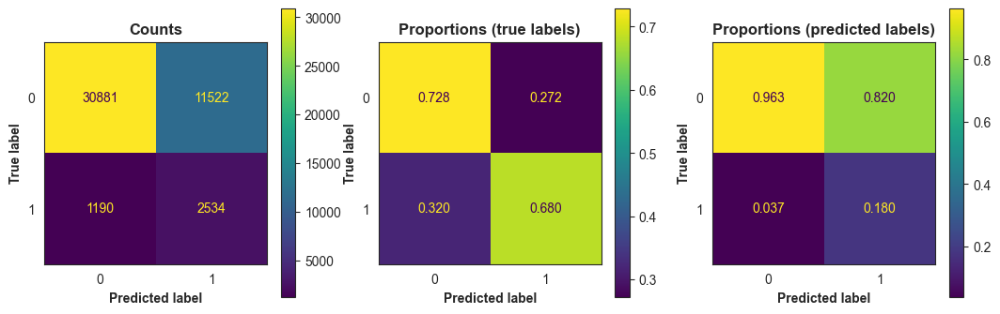

In [ ]:
sns.set_style("white")
y_pred_validation_lgbm = models["LGBM (FULL | 361 feat.)"].predict(X_credit_validation)
ml.plot_confusion_matrices(y_credit_validation, y_pred_validation_lgbm, figsize=(13, 4));

## Feature Importance

Feature importance analysis revealed that the 6 most important features are from or are based on the `application` table only. Nad only the 7th most important feature is based on historical data.


*Note.* Feature names in *CAPITALS* indicate the original features from the `application` table and feature names in *lowercase* indicate that these are derived or extracted features either from the original `application` table or from the credit history data tables.

Find the details below.


In [13]:
@my.cache_results(dir_interim + "task-2--shap_lgbm_k=all.pickle")
def get_shap_values_lgbm_extended():
    model = "LGBM (FULL | 361 feat.)"
    preproc = Pipeline(steps=models[model].steps[:-1])
    classifier = models[model]["classifier"]
    X_validation_preproc = preproc.transform(X_credit_validation)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_validation_preproc)
    return shap_values, X_validation_preproc


shap_values_lgbm_ext, data_for_lgbm_ext = get_shap_values_lgbm_extended()

In [14]:
vals = np.abs(shap_values_lgbm_ext).mean(0).mean(0)
feature_importance_ext = (
    pd.DataFrame(
        list(zip(data_for_lgbm_ext.columns, vals)),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

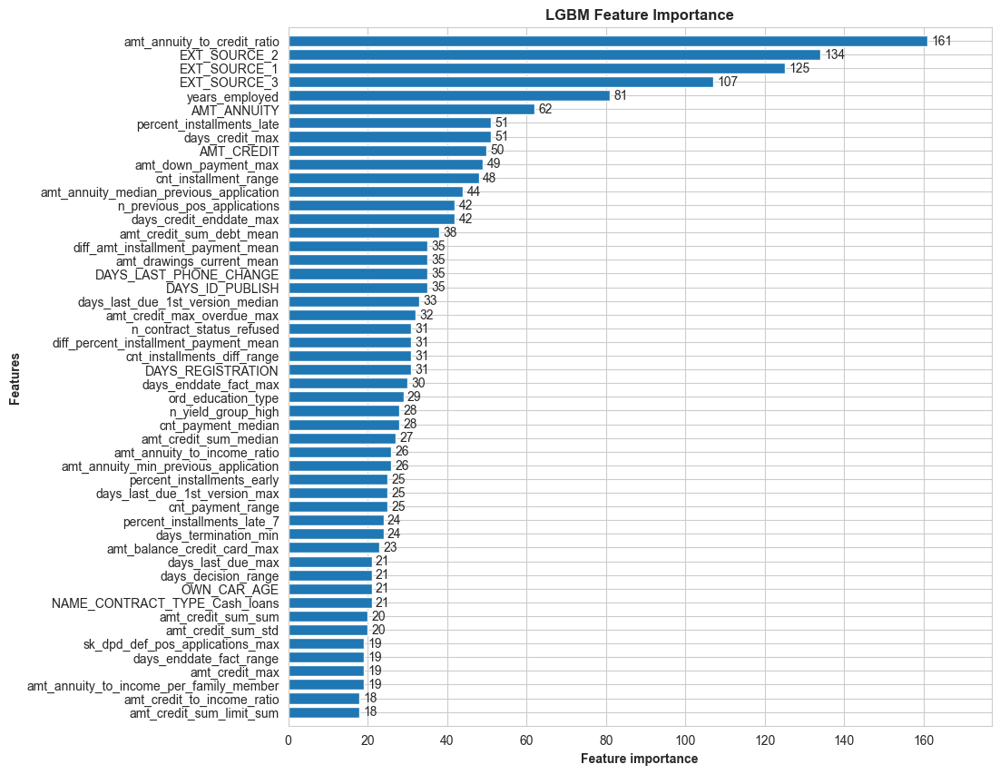

In [ ]:
sns.set_style("whitegrid")
lgb.plot_importance(
    models["LGBM (FULL | 361 feat.)"]["classifier"],
    max_num_features=50,
    figsize=(10, 10),
    height=0.8,
    title="LGBM Feature Importance",
);

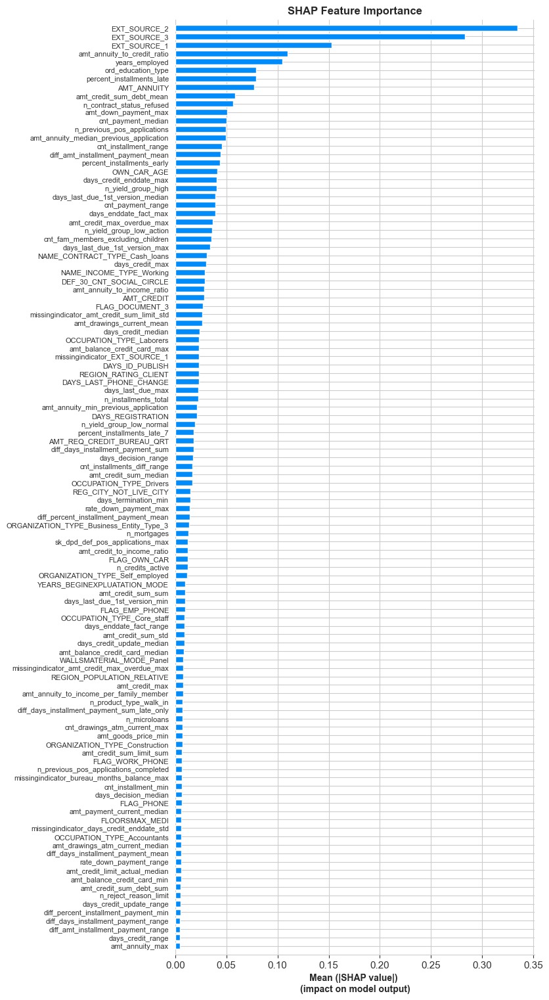

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_ext[1],
    data_for_lgbm_ext,
    plot_type="bar",
    max_display=110,
    plot_size=(10, 15),
    show=False,
)
plt.tick_params(axis="y", labelsize=8)
plt.title("SHAP Feature Importance", fontsize=12)
plt.xlabel("Mean (|SHAP value|) \n(impact on model output)", fontsize=10);

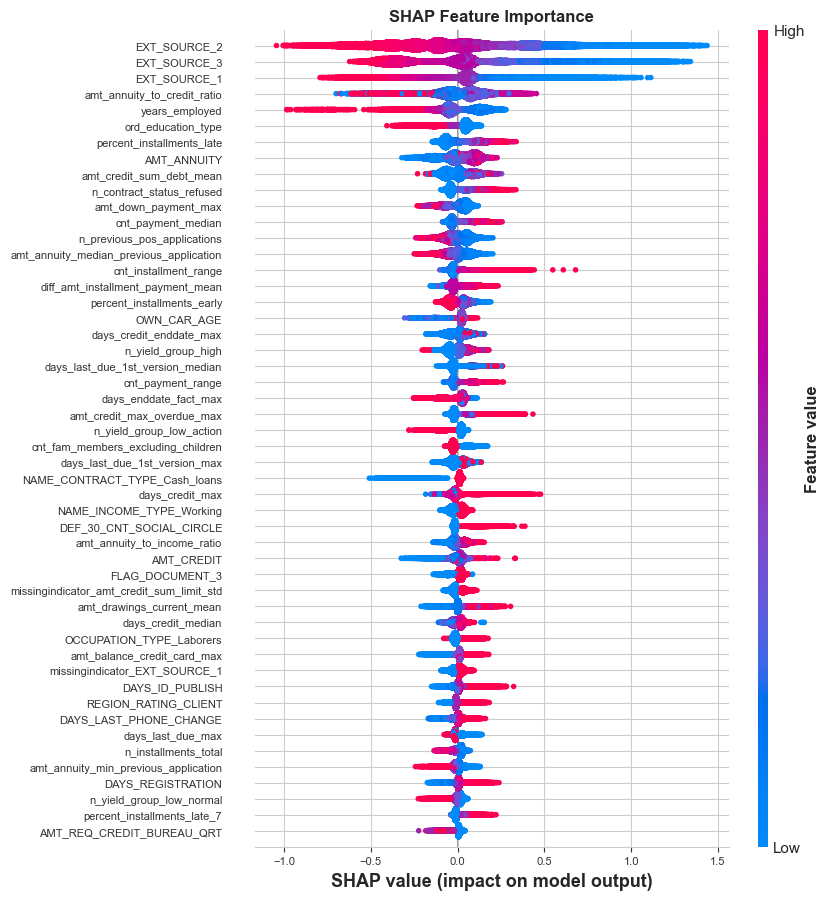

In [ ]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_ext[1],
    data_for_lgbm_ext,
    max_display=50,
    plot_size=(10, 9),
    show=False,
)
plt.title("SHAP Feature Importance", fontsize=12)
plt.tick_params(axis="y", labelsize=8)
plt.tick_params(axis="x", labelsize=8)

In [ ]:
# | label: tbl-shap-feature-importance-lgbm-2
# | tbl-cap: 'SHAP values of the features for the LGBM model.'
# | code-summary: Code of the table
# | code-fold: false

feature_importance_ext.style.format(precision=6)

,index,col_name,importance
0,19,EXT_SOURCE_2,0.334729
1,20,EXT_SOURCE_3,0.283458
2,18,EXT_SOURCE_1,0.152720
3,174,amt_annuity_to_credit_ratio,0.109900
4,360,years_employed,0.104907
5,346,ord_education_type,0.078970
6,348,percent_installments_late,0.078802
7,0,AMT_ANNUITY,0.076940
8,188,amt_credit_sum_debt_mean,0.058354
9,309,n_contract_status_refused,0.056706


## Training Models with Feature Selection {#sec-train-models-with-feature-selection-2}

The models are trained based on smaller subsets of features. These subsets are created based on the arbitrarily selected thresholds of SHAP values (the threshold values were selected to reduce the number of features by 20-40 in most cases).

The model with 216 features (SHAP > 0.0001) shows the best validation performance in terms of ROC AUC (0.779) and as well as some other metrics.

In [ ]:
def fit_lgbm_ext_on_features(features):
    """Template to fit a LGBM model with a smaller number of features."""
    pipeline = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(cols_to_include_in_preprocessing)),
            ("preprocessor_2", clone(pre_processing)),
            ("selector_2", ColumnSelector(features)),
            ("classifier", clone(lgbm_classifier)),
        ]
    )
    pipeline.fit(X_credit_train, y_credit_train)
    return pipeline


def get_feature_names_by_shap_thereshold(threshold):
    return feature_importance_ext.query(f"importance > {threshold}").col_name.to_list()


def n_features_by_shap_threshold(thresholds):
    [
        print(
            f"Threshold: {threshold} | "
            f"Number of features: {len(get_feature_names_by_shap_thereshold(threshold))}"
        )
        for threshold in thresholds
    ]


def fit_lgbm_ext_with_shap_threshold(threshold):
    """Function for feature selection based on SHAP values"""
    features = feature_importance_ext.query(
        f"importance > {threshold}"
    ).col_name.to_list()
    k = len(features)
    return f"LGBM ({k} features)", fit_lgbm_ext_on_features(features)

In [ ]:
thresholds = [
    0.0001,
    0.0005,
    0.0010,
    0.0020,
    0.0040,
    0.0050,
    0.0070,
    0.0100,
    0.0200,
    0.0300,
    0.0400,
    0.0500,
    0.1000,
]

In [ ]:
n_features_by_shap_threshold(thresholds)

Threshold: 0.0001 | Number of features: 216
Threshold: 0.0005 | Number of features: 183
Threshold: 0.001 | Number of features: 167
Threshold: 0.002 | Number of features: 140
Threshold: 0.004 | Number of features: 120
Threshold: 0.005 | Number of features: 105
Threshold: 0.007 | Number of features: 84
Threshold: 0.01 | Number of features: 66
Threshold: 0.02 | Number of features: 47
Threshold: 0.03 | Number of features: 29
Threshold: 0.04 | Number of features: 20
Threshold: 0.05 | Number of features: 12
Threshold: 0.1 | Number of features: 5


In [ ]:
# Restore from file or calculate
file = dir_interim + "task-2-w-credit-history--lgbm_molels_as_dict.pkl"

if os.path.exists(file):
    with open(file, "rb") as f:
        models = joblib.load(f)
else:
    for threshold in thresholds:
        model_name, model = fit_lgbm_ext_with_shap_threshold(threshold)
        models[model_name] = model

    with open(file, "wb") as f:
        joblib.dump(models, f)

del file
# Time: 5m 7.1s

In [ ]:
print("--- Train ---")
ml.classification_scores(
    models,
    X_credit_train,
    y_credit_train,
    sort_by="ROC_AUC",
    color="orange",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (216 features),215257,0.919,0.737,0.747,0.493,0.317,0.837,0.759,0.735,0.201,0.972,0.827
LGBM (167 features),215257,0.919,0.737,0.747,0.495,0.318,0.837,0.759,0.735,0.201,0.972,0.827
LGBM (FULL | 361 feat.),215257,0.919,0.737,0.748,0.495,0.318,0.837,0.760,0.735,0.201,0.972,0.827
LGBM (183 features),215257,0.919,0.737,0.748,0.496,0.318,0.837,0.761,0.735,0.201,0.972,0.827
LGBM (140 features),215257,0.919,0.737,0.748,0.496,0.319,0.837,0.761,0.735,0.201,0.972,0.827
LGBM (120 features),215257,0.919,0.737,0.746,0.492,0.317,0.837,0.757,0.735,0.201,0.972,0.826
LGBM (105 features),215257,0.919,0.736,0.746,0.493,0.317,0.836,0.759,0.734,0.200,0.972,0.826
LGBM (84 features),215257,0.919,0.734,0.744,0.488,0.315,0.835,0.755,0.733,0.199,0.971,0.824
LGBM (66 features),215257,0.919,0.733,0.743,0.486,0.313,0.834,0.756,0.731,0.198,0.971,0.823
LGBM (47 features),215257,0.919,0.730,0.741,0.481,0.311,0.832,0.753,0.728,0.196,0.971,0.819


In [ ]:
print("--- Validation ---")
ml.classification_scores(
    models,
    X_credit_validation,
    y_credit_validation,
    sort_by="ROC_AUC",
)

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (216 features),46127,0.919,0.726,0.709,0.419,0.289,0.830,0.689,0.730,0.183,0.964,0.779
LGBM (183 features),46127,0.919,0.724,0.705,0.411,0.286,0.829,0.682,0.728,0.181,0.963,0.779
LGBM (167 features),46127,0.919,0.727,0.706,0.412,0.287,0.831,0.681,0.731,0.182,0.963,0.778
LGBM (140 features),46127,0.919,0.724,0.706,0.411,0.286,0.829,0.684,0.728,0.181,0.963,0.778
LGBM (FULL | 361 feat.),46127,0.919,0.724,0.704,0.409,0.285,0.829,0.680,0.728,0.180,0.963,0.778
LGBM (120 features),46127,0.919,0.726,0.706,0.413,0.287,0.831,0.683,0.730,0.182,0.963,0.777
LGBM (105 features),46127,0.919,0.725,0.704,0.408,0.285,0.829,0.679,0.729,0.180,0.963,0.777
LGBM (66 features),46127,0.919,0.723,0.708,0.415,0.287,0.828,0.689,0.726,0.181,0.964,0.777
LGBM (84 features),46127,0.919,0.722,0.706,0.412,0.285,0.828,0.687,0.726,0.180,0.963,0.776
LGBM (47 features),46127,0.919,0.720,0.703,0.407,0.283,0.826,0.683,0.723,0.178,0.963,0.774


## Tune Hyperparameters {#sec-tune-hyperparameters-2}

In this section, the best-performing model based on 216 features will be tuned.
To tune hyperparameters, the Optuna package is used.

In [ ]:
# Use the subset of the selected features
file_path = dir_interim + "colnames--cols_to_include_in_preprocessing.csv"
cols_to_include_in_preprocessing = pd.read_csv(file_path).column.tolist()
features_to_tune = feature_importance_ext.query(
    f"importance > 0.0001"
).col_name.to_list()
del file_path

# Use 3-fold stratified CV
stratified_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=1)

NameError: name 'feature_importance_ext' is not defined

In [ ]:
# Define objective function for optuna
def objective(trial):
    "Objective fuction for hyperparameter tuning"
    # LGBM params
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 1000, step=50),
        "max_depth": trial.suggest_int("max_depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["gbdt"]),
        # Tree Structure and Complexity
        "num_leaves": trial.suggest_int("num_leaves", 2, 256),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        # Regularization
        "lambda_l1": trial.suggest_float("lambda_l1", 1e-8, 10.0, log=True),
        "lambda_l2": trial.suggest_float("lambda_l2", 1e-8, 10.0, log=True),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 1.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 1.0),
        # Learning Rate and Feature Selection
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "feature_fraction": trial.suggest_float("feature_fraction", 0.4, 1.0),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        # Other Parameters
        "bagging_fraction": trial.suggest_float("bagging_fraction", 0.4, 1.0),
        "bagging_freq": trial.suggest_int("bagging_freq", 1, 7),
        "min_child_weight": trial.suggest_float(
            "min_child_weight", 1e-3, 1e3, log=True
        ),
        "min_split_gain": trial.suggest_float("min_split_gain", 0.0, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 50),
        "max_delta_step": trial.suggest_int("max_delta_step", 0, 10),
    }

    model = LGBMClassifier(
        objective="binary",
        metric="auc",
        random_state=1,
        class_weight="balanced",
        n_jobs=-1,
        device="gpu",
        **params,
    )

    pipeline_to_tune = Pipeline(
        steps=[
            ("selector_1", ColumnSelector(cols_to_include_in_preprocessing)),
            ("preprocessor_2", clone(pre_processing)),
            ("selector_2", ColumnSelector(features_to_tune)),
            ("classifier", model),
        ]
    )

    scores = cross_val_score(
        pipeline_to_tune, X_credit_train, y_credit_train, n_jobs=-1, cv=stratified_kfold
    )

    return scores.mean()


study_name = "tune-w-credit-history"
storage_name = f"sqlite:///{dir_interim}/optuna--{study_name}.db"

study = optuna.create_study(
    study_name=study_name,
    storage=storage_name,
    load_if_exists=True,
    direction="maximize",
)
study.optimize(objective, n_trials=100, timeout=3600)
# Time 62m 20.0s

[I 2023-12-27 19:20:13,041] A new study created in RDB with name: tune-w-credit-history
[I 2023-12-27 19:21:14,358] Trial 0 finished with value: 0.7133844678540423 and parameters: {'n_estimators': 800, 'max_depth': 1, 'boosting_type': 'gbdt', 'num_leaves': 68, 'min_child_samples': 29, 'lambda_l1': 0.0001520382569789408, 'lambda_l2': 1.0837050089743732e-05, 'reg_alpha': 0.06205900866526515, 'reg_lambda': 0.9973509941432356, 'learning_rate': 0.17385115867266585, 'feature_fraction': 0.457613838544846, 'subsample': 0.7641858502243166, 'colsample_bytree': 0.4691247981564376, 'bagging_fraction': 0.9776044061943601, 'bagging_freq': 3, 'min_child_weight': 0.2632724059022625, 'min_split_gain': 0.3144179175251397, 'min_data_in_leaf': 20, 'max_delta_step': 6}. Best is trial 0 with value: 0.7133844678540423.
[I 2023-12-27 19:21:54,405] Trial 1 finished with value: 0.7188662922677773 and parameters: {'n_estimators': 300, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 111, 'min_child_samples

<!-- 

[I 2023-12-27 19:20:13,041] A new study created in RDB with name: tune-w-credit-history
[I 2023-12-27 19:21:14,358] Trial 0 finished with value: 0.7133844678540423 and parameters: {'n_estimators': 800, 'max_depth': 1, 'boosting_type': 'gbdt', 'num_leaves': 68, 'min_child_samples': 29, 'lambda_l1': 0.0001520382569789408, 'lambda_l2': 1.0837050089743732e-05, 'reg_alpha': 0.06205900866526515, 'reg_lambda': 0.9973509941432356, 'learning_rate': 0.17385115867266585, 'feature_fraction': 0.457613838544846, 'subsample': 0.7641858502243166, 'colsample_bytree': 0.4691247981564376, 'bagging_fraction': 0.9776044061943601, 'bagging_freq': 3, 'min_child_weight': 0.2632724059022625, 'min_split_gain': 0.3144179175251397, 'min_data_in_leaf': 20, 'max_delta_step': 6}. Best is trial 0 with value: 0.7133844678540423.
[I 2023-12-27 19:21:54,405] Trial 1 finished with value: 0.7188662922677773 and parameters: {'n_estimators': 300, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 111, 'min_child_samples': 72, 'lambda_l1': 0.0010433150020650284, 'lambda_l2': 0.000733681979055871, 'reg_alpha': 0.35178729517365503, 'reg_lambda': 0.03423976796711303, 'learning_rate': 0.2903376154019435, 'feature_fraction': 0.6147235927730519, 'subsample': 0.6121461820293557, 'colsample_bytree': 0.8644863075835109, 'bagging_fraction': 0.6308830635202857, 'bagging_freq': 2, 'min_child_weight': 0.2432421435462729, 'min_split_gain': 0.223990834897291, 'min_data_in_leaf': 40, 'max_delta_step': 2}. Best is trial 1 with value: 0.7188662922677773.
[I 2023-12-27 19:22:23,909] Trial 2 finished with value: 0.7126876338496727 and parameters: {'n_estimators': 150, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 139, 'min_child_samples': 39, 'lambda_l1': 0.4651706361118245, 'lambda_l2': 0.0113567650942596, 'reg_alpha': 0.28596868511468554, 'reg_lambda': 0.5617766235501069, 'learning_rate': 0.2862326501066601, 'feature_fraction': 0.7760128851639144, 'subsample': 0.48788054317390844, 'colsample_bytree': 0.2983688315154828, 'bagging_fraction': 0.7507872036234606, 'bagging_freq': 7, 'min_child_weight': 814.1423255572674, 'min_split_gain': 0.12315860127817202, 'min_data_in_leaf': 26, 'max_delta_step': 1}. Best is trial 1 with value: 0.7188662922677773.
[I 2023-12-27 19:23:52,349] Trial 3 finished with value: 0.8479259574144425 and parameters: {'n_estimators': 1000, 'max_depth': 5, 'boosting_type': 'gbdt', 'num_leaves': 112, 'min_child_samples': 96, 'lambda_l1': 0.00017306252387348225, 'lambda_l2': 1.977539005227824e-05, 'reg_alpha': 0.4283787945872213, 'reg_lambda': 0.9893280264194702, 'learning_rate': 0.17128861427623032, 'feature_fraction': 0.6845818343036181, 'subsample': 0.17203387975679538, 'colsample_bytree': 0.7980915047057495, 'bagging_fraction': 0.8435277923028028, 'bagging_freq': 4, 'min_child_weight': 0.004024480124332665, 'min_split_gain': 0.4465134798497602, 'min_data_in_leaf': 38, 'max_delta_step': 3}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:25:11,579] Trial 4 finished with value: 0.7387123283474638 and parameters: {'n_estimators': 500, 'max_depth': 6, 'boosting_type': 'gbdt', 'num_leaves': 223, 'min_child_samples': 21, 'lambda_l1': 1.036153287921386e-07, 'lambda_l2': 1.6295147516128015e-07, 'reg_alpha': 0.6652264420514161, 'reg_lambda': 0.18748862643684328, 'learning_rate': 0.01347760446234664, 'feature_fraction': 0.8228363548713917, 'subsample': 0.5904533867022965, 'colsample_bytree': 0.9358815070918077, 'bagging_fraction': 0.5846974106187401, 'bagging_freq': 5, 'min_child_weight': 0.7074335671273558, 'min_split_gain': 0.29439756447372956, 'min_data_in_leaf': 17, 'max_delta_step': 9}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:25:39,516] Trial 5 finished with value: 0.6993268474558821 and parameters: {'n_estimators': 150, 'max_depth': 2, 'boosting_type': 'gbdt', 'num_leaves': 216, 'min_child_samples': 14, 'lambda_l1': 9.750757318137843, 'lambda_l2': 0.34479627430862014, 'reg_alpha': 0.8213573723009959, 'reg_lambda': 0.9754288921619616, 'learning_rate': 0.08283760652331447, 'feature_fraction': 0.782639149015379, 'subsample': 0.43314082646508134, 'colsample_bytree': 0.2156419154071122, 'bagging_fraction': 0.9768194695171522, 'bagging_freq': 3, 'min_child_weight': 0.005020398733771443, 'min_split_gain': 0.710369095642509, 'min_data_in_leaf': 19, 'max_delta_step': 6}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:26:50,629] Trial 6 finished with value: 0.8316849025663076 and parameters: {'n_estimators': 200, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 120, 'min_child_samples': 100, 'lambda_l1': 4.911477023170647e-08, 'lambda_l2': 1.3489936875313564e-05, 'reg_alpha': 0.673138884928222, 'reg_lambda': 0.003695339233514061, 'learning_rate': 0.11318013505175774, 'feature_fraction': 0.9208947900557085, 'subsample': 0.27865211549049074, 'colsample_bytree': 0.7964060768332551, 'bagging_fraction': 0.6686535176120247, 'bagging_freq': 1, 'min_child_weight': 4.080570526996787, 'min_split_gain': 0.9121238054632345, 'min_data_in_leaf': 37, 'max_delta_step': 6}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:27:54,315] Trial 7 finished with value: 0.7522496444555378 and parameters: {'n_estimators': 600, 'max_depth': 5, 'boosting_type': 'gbdt', 'num_leaves': 244, 'min_child_samples': 43, 'lambda_l1': 2.534823760275499e-08, 'lambda_l2': 2.7995860787697047, 'reg_alpha': 0.28650632087067907, 'reg_lambda': 0.6249923343905277, 'learning_rate': 0.039342315509374066, 'feature_fraction': 0.7293660504039947, 'subsample': 0.6741250410202273, 'colsample_bytree': 0.16784925739666362, 'bagging_fraction': 0.5496868541785603, 'bagging_freq': 3, 'min_child_weight': 6.446646717695389, 'min_split_gain': 0.9250331900530822, 'min_data_in_leaf': 49, 'max_delta_step': 2}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:28:21,006] Trial 8 finished with value: 0.7072801486649237 and parameters: {'n_estimators': 50, 'max_depth': 3, 'boosting_type': 'gbdt', 'num_leaves': 59, 'min_child_samples': 6, 'lambda_l1': 2.05655116866198e-08, 'lambda_l2': 4.0069835388076785e-08, 'reg_alpha': 0.26041375594498495, 'reg_lambda': 0.38611463427103676, 'learning_rate': 0.2781185770603419, 'feature_fraction': 0.741937028506221, 'subsample': 0.4462685297259511, 'colsample_bytree': 0.5284777436645074, 'bagging_fraction': 0.9732383128478747, 'bagging_freq': 1, 'min_child_weight': 2.319742366056286, 'min_split_gain': 0.4202994519219667, 'min_data_in_leaf': 15, 'max_delta_step': 2}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:28:49,372] Trial 9 finished with value: 0.6756110093515885 and parameters: {'n_estimators': 50, 'max_depth': 4, 'boosting_type': 'gbdt', 'num_leaves': 11, 'min_child_samples': 41, 'lambda_l1': 7.36483774066561e-07, 'lambda_l2': 0.0004694219095532689, 'reg_alpha': 0.8791483544217241, 'reg_lambda': 0.42223959207093187, 'learning_rate': 0.013380954064159494, 'feature_fraction': 0.48647182501042135, 'subsample': 0.33239085856469064, 'colsample_bytree': 0.4521145383014534, 'bagging_fraction': 0.6908504039445515, 'bagging_freq': 6, 'min_child_weight': 82.2433055046293, 'min_split_gain': 0.28892951590992133, 'min_data_in_leaf': 25, 'max_delta_step': 1}. Best is trial 3 with value: 0.8479259574144425.
[I 2023-12-27 19:36:23,915] Trial 10 finished with value: 0.9043887034768833 and parameters: {'n_estimators': 1000, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 171, 'min_child_samples': 71, 'lambda_l1': 1.6894405269684752e-05, 'lambda_l2': 2.5479861382375376e-06, 'reg_alpha': 0.5305753243887574, 'reg_lambda': 0.7834468951359224, 'learning_rate': 0.05897985586531902, 'feature_fraction': 0.608096917733464, 'subsample': 0.0823584299376674, 'colsample_bytree': 0.6951910076532127, 'bagging_fraction': 0.4298117967213491, 'bagging_freq': 5, 'min_child_weight': 0.0011663326986012653, 'min_split_gain': 0.553012365836588, 'min_data_in_leaf': 1, 'max_delta_step': 4}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 19:44:20,709] Trial 11 finished with value: 0.9002541073988085 and parameters: {'n_estimators': 1000, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 173, 'min_child_samples': 78, 'lambda_l1': 1.0708866586763564e-05, 'lambda_l2': 2.4683340848716906e-06, 'reg_alpha': 0.5302837150243924, 'reg_lambda': 0.8033717158930774, 'learning_rate': 0.05047074984874552, 'feature_fraction': 0.6196066363480937, 'subsample': 0.08527296183385108, 'colsample_bytree': 0.7184725298338295, 'bagging_fraction': 0.43735780133140306, 'bagging_freq': 5, 'min_child_weight': 0.0010552040603009237, 'min_split_gain': 0.5642018881288399, 'min_data_in_leaf': 2, 'max_delta_step': 4}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 19:53:01,431] Trial 12 finished with value: 0.9002541115424737 and parameters: {'n_estimators': 1000, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 173, 'min_child_samples': 70, 'lambda_l1': 1.165530319451606e-05, 'lambda_l2': 6.557722320701904e-07, 'reg_alpha': 0.55443498043106, 'reg_lambda': 0.750406064876292, 'learning_rate': 0.04803394354033783, 'feature_fraction': 0.5418748467431972, 'subsample': 0.0527277396464233, 'colsample_bytree': 0.6409664835561325, 'bagging_fraction': 0.4057583105199048, 'bagging_freq': 5, 'min_child_weight': 0.0012744723872042992, 'min_split_gain': 0.6235370931106026, 'min_data_in_leaf': 1, 'max_delta_step': 4}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 19:57:59,299] Trial 13 finished with value: 0.8785080092391984 and parameters: {'n_estimators': 800, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 179, 'min_child_samples': 59, 'lambda_l1': 3.870504370488863e-06, 'lambda_l2': 3.5632798838577234e-07, 'reg_alpha': 0.5552302283068307, 'reg_lambda': 0.7441647781250288, 'learning_rate': 0.0331882192882924, 'feature_fraction': 0.5379323013978335, 'subsample': 0.05782808696150672, 'colsample_bytree': 0.6668916697472603, 'bagging_fraction': 0.4042138039242215, 'bagging_freq': 5, 'min_child_weight': 0.02749957725080116, 'min_split_gain': 0.6358682934280196, 'min_data_in_leaf': 2, 'max_delta_step': 8}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:02:08,027] Trial 14 finished with value: 0.8543276011471223 and parameters: {'n_estimators': 850, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 197, 'min_child_samples': 65, 'lambda_l1': 5.857325396819327e-06, 'lambda_l2': 1.1540765814883997e-08, 'reg_alpha': 0.9449558716340772, 'reg_lambda': 0.7643735518759827, 'learning_rate': 0.0264377319047264, 'feature_fraction': 0.4138809416134508, 'subsample': 0.9785014763384117, 'colsample_bytree': 0.6217631862933801, 'bagging_fraction': 0.5004604633571963, 'bagging_freq': 7, 'min_child_weight': 0.029231874860064476, 'min_split_gain': 0.7346524444201824, 'min_data_in_leaf': 9, 'max_delta_step': 4}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:05:28,515] Trial 15 finished with value: 0.8773558974807143 and parameters: {'n_estimators': 650, 'max_depth': 9, 'boosting_type': 'gbdt', 'num_leaves': 159, 'min_child_samples': 84, 'lambda_l1': 0.0010947979254749935, 'lambda_l2': 6.566180247402054e-07, 'reg_alpha': 0.700542554170593, 'reg_lambda': 0.6367861929705528, 'learning_rate': 0.06963364500865421, 'feature_fraction': 0.5454571723060675, 'subsample': 0.21789311730283067, 'colsample_bytree': 0.9417867015781536, 'bagging_fraction': 0.4613056213776964, 'bagging_freq': 6, 'min_child_weight': 0.0010050650360104857, 'min_split_gain': 0.4781261442568392, 'min_data_in_leaf': 8, 'max_delta_step': 5}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:09:52,587] Trial 16 finished with value: 0.8996594719728325 and parameters: {'n_estimators': 900, 'max_depth': 11, 'boosting_type': 'gbdt', 'num_leaves': 150, 'min_child_samples': 56, 'lambda_l1': 5.2101850657853695e-05, 'lambda_l2': 1.0270011883222986e-08, 'reg_alpha': 0.47817116755622174, 'reg_lambda': 0.8455458639986815, 'learning_rate': 0.05796270751653336, 'feature_fraction': 0.6127662875632117, 'subsample': 0.1571666236334549, 'colsample_bytree': 0.5457412302228843, 'bagging_fraction': 0.5123096232048837, 'bagging_freq': 4, 'min_child_weight': 0.03226715486140934, 'min_split_gain': 0.5688182774542483, 'min_data_in_leaf': 9, 'max_delta_step': 0}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:11:43,889] Trial 17 finished with value: 0.7970983517618615 and parameters: {'n_estimators': 400, 'max_depth': 8, 'boosting_type': 'gbdt', 'num_leaves': 249, 'min_child_samples': 88, 'lambda_l1': 8.485857943906983e-07, 'lambda_l2': 2.332740208848319e-06, 'reg_alpha': 0.9978838168722097, 'reg_lambda': 0.6798468844976686, 'learning_rate': 0.028667289635909032, 'feature_fraction': 0.40793738816795067, 'subsample': 0.0673086918921274, 'colsample_bytree': 0.9946989885817998, 'bagging_fraction': 0.4246976859779345, 'bagging_freq': 6, 'min_child_weight': 0.004197888784056201, 'min_split_gain': 0.7772416365414636, 'min_data_in_leaf': 1, 'max_delta_step': 8}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:14:34,560] Trial 18 finished with value: 0.8411340787793012 and parameters: {'n_estimators': 700, 'max_depth': 12, 'boosting_type': 'gbdt', 'num_leaves': 79, 'min_child_samples': 70, 'lambda_l1': 0.0064640587661589505, 'lambda_l2': 7.546095424976181e-05, 'reg_alpha': 0.6179256374168793, 'reg_lambda': 0.8653554387092988, 'learning_rate': 0.04692359560723053, 'feature_fraction': 0.540231361055241, 'subsample': 0.3039159708340914, 'colsample_bytree': 0.7111036760812757, 'bagging_fraction': 0.4943364397262184, 'bagging_freq': 5, 'min_child_weight': 0.012808373527934225, 'min_split_gain': 0.6459614317370587, 'min_data_in_leaf': 11, 'max_delta_step': 4}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:18:39,592] Trial 19 finished with value: 0.9003656058507529 and parameters: {'n_estimators': 950, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 195, 'min_child_samples': 51, 'lambda_l1': 1.9740443034087055e-05, 'lambda_l2': 1.538492352140492e-07, 'reg_alpha': 0.7820676589881548, 'reg_lambda': 0.485391596878385, 'learning_rate': 0.08338420033598173, 'feature_fraction': 0.6750014906044565, 'subsample': 0.18379862862364665, 'colsample_bytree': 0.3922667871442633, 'bagging_fraction': 0.4002258795457228, 'bagging_freq': 4, 'min_child_weight': 0.0929726219315795, 'min_split_gain': 0.8462828519856542, 'min_data_in_leaf': 30, 'max_delta_step': 7}. Best is trial 10 with value: 0.9043887034768833.
[I 2023-12-27 20:22:31,723] Trial 20 finished with value: 0.9029578514479404 and parameters: {'n_estimators': 900, 'max_depth': 10, 'boosting_type': 'gbdt', 'num_leaves': 209, 'min_child_samples': 47, 'lambda_l1': 3.351553254308848e-07, 'lambda_l2': 6.380193421921823e-08, 'reg_alpha': 0.7908982979418974, 'reg_lambda': 0.4871542957987469, 'learning_rate': 0.08670301703025042, 'feature_fraction': 0.6613735657699136, 'subsample': 0.3683340397111962, 'colsample_bytree': 0.3697916753974209, 'bagging_fraction': 0.5700116779255459, 'bagging_freq': 4, 'min_child_weight': 0.09342824353373518, 'min_split_gain': 0.8503928290277616, 'min_data_in_leaf': 27, 'max_delta_step': 10}. Best is trial 10 with value: 0.9043887034768833.

 -->

Best is trial 10 with CV AUC value: 0.9044
<!-- Best is trial 10 with value: 0.9043887034768833. -->

Trial 10 finished with value: 0.9043887034768833 and parameters: 

  -  'n_estimators': 1000, 
  -  'max_depth': 12, 
  -  'boosting_type': 'gbdt', 
  -  'num_leaves': 171, 
  -  'min_child_samples': 71,
  -  'lambda_l1': 1.6894405269684752e-05, 
  -  'lambda_l2': 2.5479861382375376e-06,
  -  'reg_alpha': 0.5305753243887574,
  -  'reg_lambda': 0.7834468951359224,
  -  'learning_rate': 0.05897985586531902, 
  -  'feature_fraction': 0.608096917733464, 
  -  'subsample': 0.0823584299376674, 
  -  'colsample_bytree': 0.6951910076532127, 
  -  'bagging_fraction': 0.4298117967213491, 
  -  'bagging_freq': 5, 
  -  'min_child_weight': 0.0011663326986012653, 
  -  'min_split_gain': 0.553012365836588, 
  -  'min_data_in_leaf': 1,
  -  'max_delta_step': 4
    
    

## Evaluate Tuned Model {#sec-evaluate-tuned-model-2}

This time the tuned model faces the same issues related to **overfitting** as the tuned model in @sec-evaluate-tuned-model-2. This should be addressed by limiting model complexity. Unfortunately, this time there is not enough time to do this.

In [ ]:
params_tuned_2 = {
    "n_estimators": 1000,
    "max_depth": 12,
    "boosting_type": "gbdt",
    "num_leaves": 171,
    "min_child_samples": 71,
    "lambda_l1": 1.6894405269684752e-05,
    "lambda_l2": 2.5479861382375376e-06,
    "reg_alpha": 0.5305753243887574,
    "reg_lambda": 0.7834468951359224,
    "learning_rate": 0.05897985586531902,
    "feature_fraction": 0.608096917733464,
    "subsample": 0.0823584299376674,
    "colsample_bytree": 0.6951910076532127,
    "bagging_fraction": 0.4298117967213491,
    "bagging_freq": 5,
    "min_child_weight": 0.0011663326986012653,
    "min_split_gain": 0.553012365836588,
    "min_data_in_leaf": 1,
    "max_delta_step": 4,
}

model_tuned_2 = LGBMClassifier(
    objective="binary",
    metric="auc",
    random_state=1,
    class_weight="balanced",
    n_jobs=-1,
    device="gpu",
    **params_tuned_2
)

pipeline_tuned_2 = Pipeline(
    steps=[
        ("selector_1", ColumnSelector(cols_to_include_in_preprocessing)),
        ("preprocessor_2", clone(pre_processing)),
        ("selector_2", ColumnSelector(features_to_tune)),
        ("classifier", model_tuned_2),
    ]
)

pipeline_tuned_2.fit(X_credit_train, y_credit_train)

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.608096917733464, colsample_bytree=0.6951910076532127 will be ignored. Current value: feature_fraction=0.608096917733464
[LightGBM] [Warning] lambda_l1 is set=1.6894405269684752e-05, reg_alpha=0.5305753243887574 will be ignored. Current value: lambda_l1=1.6894405269684752e-05
[LightGBM] [Warning] lambda_l2 is set=2.5479861382375376e-06, reg_lambda=0.7834468951359224 will be ignored. Current value: lambda_l2=2.5479861382375376e-06
[LightGBM] [Warning] bagging_fraction is set=0.4298117967213491, subsample=0.0823584299376674 will be ignored. Current value: bagging_fraction=0.4298117967213491
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM]

Pipeline(steps=[('selector_1',
                 ColumnSelector(keep=['AMT_ANNUITY', 'AMT_CREDIT',
                                      'AMT_INCOME_TOTAL',
                                      'AMT_REQ_CREDIT_BUREAU_DAY',
                                      'AMT_REQ_CREDIT_BUREAU_HOUR',
                                      'AMT_REQ_CREDIT_BUREAU_MON',
                                      'AMT_REQ_CREDIT_BUREAU_QRT',
                                      'AMT_REQ_CREDIT_BUREAU_WEEK',
                                      'AMT_REQ_CREDIT_BUREAU_YEAR',
                                      'BASEMENTAREA_MODE', 'CNT_FAM_MEMBERS',
                                      'COMMONAREA_MEDI', 'DAYS_ID_PUBLISH',
                                      'DAYS_LA...
                                learning_rate=0.05897985586531902,
                                max_delta_step=4, max_depth=12, metric='auc',
                                min_child_samples=71,
                                min_child_weight=0.0011663326986012653,
                                min_data_in_leaf=1,
                                min_split_gain=0.553012365836588,
                                n_estimators=1000, n_jobs=-1, num_leaves=171,
                                objective='binary', random_state=1,
                                reg_alpha=0.5305753243887574,
                                reg_lambda=0.7834468951359224,
                                subsample=0.0823584299376674))])

In [ ]:
models["LGBM (216 feat. | tuned)"] = pipeline_tuned_2

In [ ]:
performance_train_2 = ml.classification_scores(
    models,
    X_credit_train,
    y_credit_train,
    color="orange",
    sort_by="ROC_AUC",
)

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.608096917733464, colsample_bytree=0.6951910076532127 will be ignored. Current value: feature_fraction=0.608096917733464
[LightGBM] [Warning] lambda_l1 is set=1.6894405269684752e-05, reg_alpha=0.5305753243887574 will be ignored. Current value: lambda_l1=1.6894405269684752e-05
[LightGBM] [Warning] lambda_l2 is set=2.5479861382375376e-06, reg_lambda=0.7834468951359224 will be ignored. Current value: lambda_l2=2.5479861382375376e-06
[LightGBM] [Warning] bagging_fraction is set=0.4298117967213491, subsample=0.0823584299376674 will be ignored. Current value: bagging_fraction=0.4298117967213491
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM]

In [ ]:
performance_validation_2 = ml.classification_scores(
    models,
    X_credit_validation,
    y_credit_validation,
    sort_by="ROC_AUC",
)

[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] feature_fraction is set=0.608096917733464, colsample_bytree=0.6951910076532127 will be ignored. Current value: feature_fraction=0.608096917733464
[LightGBM] [Warning] lambda_l1 is set=1.6894405269684752e-05, reg_alpha=0.5305753243887574 will be ignored. Current value: lambda_l1=1.6894405269684752e-05
[LightGBM] [Warning] lambda_l2 is set=2.5479861382375376e-06, reg_lambda=0.7834468951359224 will be ignored. Current value: lambda_l2=2.5479861382375376e-06
[LightGBM] [Warning] bagging_fraction is set=0.4298117967213491, subsample=0.0823584299376674 will be ignored. Current value: bagging_fraction=0.4298117967213491
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=1
[LightGBM]

In [ ]:
print("--- Train ---")
performance_train_2

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (216 feat. | tuned),215257,0.919,0.991,0.995,0.990,0.947,0.995,1.000,0.990,0.900,1.000,1.000
LGBM (216 features),215257,0.919,0.737,0.747,0.493,0.317,0.837,0.759,0.735,0.201,0.972,0.827
LGBM (167 features),215257,0.919,0.737,0.747,0.495,0.318,0.837,0.759,0.735,0.201,0.972,0.827
LGBM (FULL | 361 feat.),215257,0.919,0.737,0.748,0.495,0.318,0.837,0.760,0.735,0.201,0.972,0.827
LGBM (183 features),215257,0.919,0.737,0.748,0.496,0.318,0.837,0.761,0.735,0.201,0.972,0.827
LGBM (140 features),215257,0.919,0.737,0.748,0.496,0.319,0.837,0.761,0.735,0.201,0.972,0.827
LGBM (120 features),215257,0.919,0.737,0.746,0.492,0.317,0.837,0.757,0.735,0.201,0.972,0.826
LGBM (105 features),215257,0.919,0.736,0.746,0.493,0.317,0.836,0.759,0.734,0.200,0.972,0.826
LGBM (84 features),215257,0.919,0.734,0.744,0.488,0.315,0.835,0.755,0.733,0.199,0.971,0.824
LGBM (66 features),215257,0.919,0.733,0.743,0.486,0.313,0.834,0.756,0.731,0.198,0.971,0.823


In [ ]:
print("--- Validation ---")
performance_validation_2

--- Validation ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (216 features),46127,0.919,0.726,0.709,0.419,0.289,0.830,0.689,0.730,0.183,0.964,0.779
LGBM (183 features),46127,0.919,0.724,0.705,0.411,0.286,0.829,0.682,0.728,0.181,0.963,0.779
LGBM (167 features),46127,0.919,0.727,0.706,0.412,0.287,0.831,0.681,0.731,0.182,0.963,0.778
LGBM (140 features),46127,0.919,0.724,0.706,0.411,0.286,0.829,0.684,0.728,0.181,0.963,0.778
LGBM (FULL | 361 feat.),46127,0.919,0.724,0.704,0.409,0.285,0.829,0.680,0.728,0.180,0.963,0.778
LGBM (120 features),46127,0.919,0.726,0.706,0.413,0.287,0.831,0.683,0.730,0.182,0.963,0.777
LGBM (105 features),46127,0.919,0.725,0.704,0.408,0.285,0.829,0.679,0.729,0.180,0.963,0.777
LGBM (66 features),46127,0.919,0.723,0.708,0.415,0.287,0.828,0.689,0.726,0.181,0.964,0.777
LGBM (84 features),46127,0.919,0.722,0.706,0.412,0.285,0.828,0.687,0.726,0.180,0.963,0.776
LGBM (47 features),46127,0.919,0.720,0.703,0.407,0.283,0.826,0.683,0.723,0.178,0.963,0.774


## Final Evaluation {#sec-final-evaluation-2}

After hyperparameter tuning, the trade-off between model complexity and accuracy was re-considered. Instead of the best-performing model based on 216 features, a much less complex model based on **47 features** with comparable performance (**AUC = 0.774** which is only smaller by 0.005) was chosen as the final model to be deployed.


The **final performance** of the model based on these 47 features is **AUC = 0.777**. 
In the case, where no credit history data was used, the best model had AUC = 0.763, so the improvement by this type of data is not huge (only 0.014).

In [15]:
features_47 = feature_importance_ext.head(47).col_name.to_list()

pipeline_final_2_with_47_feat = Pipeline(
    steps=[
        ("selector_1", ColumnSelector(cols_to_include_in_preprocessing)),
        ("preprocessor_2", clone(pre_processing)),
        ("selector_2", ColumnSelector(features_47)),
        ("classifier", clone(lgbm_classifier)),
    ]
)

In [16]:
# For evaluation
X_credit_train_validation = pd.concat([X_credit_train, X_credit_validation])
y_credit_train_validation = pd.concat([y_credit_train, y_credit_validation])

models_final_2 = {}
models_final_2["LGBM (47 feat. | final)"] = pipeline_final_2_with_47_feat.fit(
    X_credit_train_validation, y_credit_train_validation
)

[LightGBM] [Info] Number of positive: 21101, number of negative: 240283
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 7853
[LightGBM] [Info] Number of data points in the train set: 261384, number of used features: 47
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce GTX 950M, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 34 dense feature groups (8.97 MB) transferred to GPU in 0.026298 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=-0.000000
[LightGBM] [Info] Start training from score -0.000000


In [ ]:
print("--- Train ---")

ml.classification_scores(
    models_final_2,
    X_credit_train_validation,
    y_credit_train_validation,
    color="orange",
    sort_by="ROC_AUC",
)

--- Train ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (47 feat. | final),261384,0.919,0.726,0.734,0.469,0.305,0.829,0.744,0.724,0.192,0.970,0.813


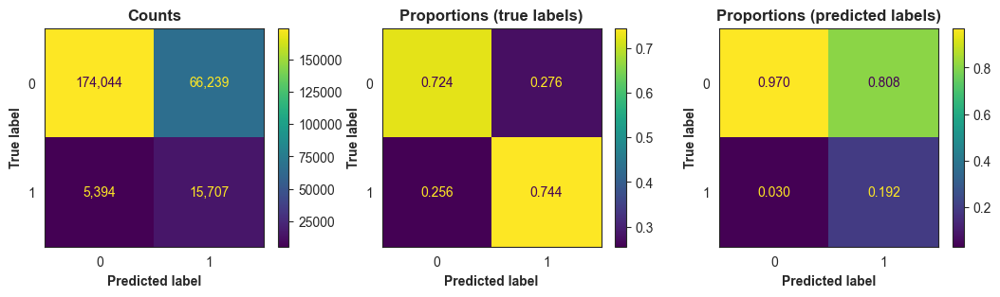

In [17]:
# | label: fig-confusion-matrices-train-val-21
# | fig-cap: 'Confusion matrices for the joint **train and validation set**.'
# | code-summary: Code of the figure
# | code-fold: true

sns.set_style("white")
y_pred_train_val_2 = models_final_2["LGBM (47 feat. | final)"].predict(
    X_credit_train_validation
)
ml.plot_confusion_matrices(y_credit_train_validation, y_pred_train_val_2, figsize=(13, 3));

In [18]:
print("--- Test ---")

ml.classification_scores(
    models_final_2,
    X_credit_test,
    y_credit_test,
    sort_by="ROC_AUC",
)

--- Test ---


,n,No_info_rate,Accuracy,BAcc,BAcc_01,F1,F1_neg,TPR,TNR,PPV,NPV,ROC_AUC
LGBM (47 feat. | final),46127,0.919,0.722,0.710,0.420,0.288,0.827,0.697,0.724,0.181,0.964,0.777


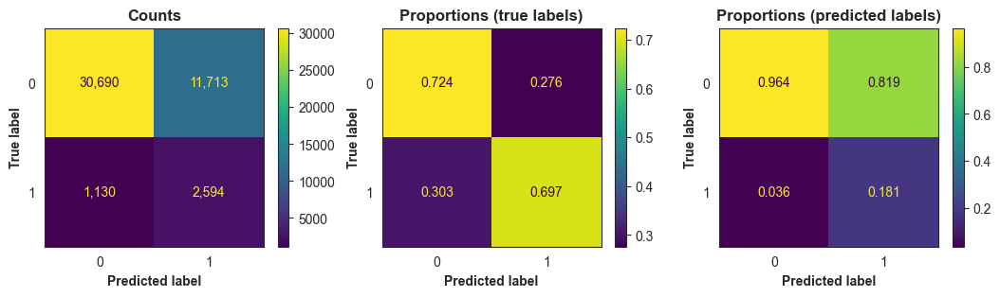

In [19]:
# | label: fig-confusion-matrices-2
# | fig-cap: 'Confusion matrices for the **test set**.'
# | code-summary: Code of the figure
# | code-fold: true

sns.set_style("white")
y_pred_test_2 = models_final_2["LGBM (47 feat. | final)"].predict(X_credit_test)
ml.plot_confusion_matrices(y_credit_test, y_pred_test_2, figsize=(13, 3));

In [20]:
# SHAP values for the final model
@my.cache_results(dir_interim + "task-2--shap_lgbm_k=47-final.pickle")
def get_shap_values_lgbm_final_2():
    model = "LGBM (47 feat. | final)"
    preproc = Pipeline(steps=models_final_2[model].steps[:-1])
    classifier = models_final_2[model]["classifier"]
    X_test_preproc = preproc.transform(X_credit_test)

    tree_explainer = shap.TreeExplainer(classifier)
    shap_values = tree_explainer.shap_values(X_test_preproc)
    return shap_values, X_test_preproc


shap_values_lgbm_test_2, data_for_lgbm_test_2 = get_shap_values_lgbm_final_2()

feature_importance_test_2 = (
    pd.DataFrame(
        list(
            zip(
                data_for_lgbm_test_2.columns,
                np.abs(shap_values_lgbm_test_2).mean(0).mean(0),
            )
        ),
        columns=["col_name", "importance"],
    )
    .sort_values(by=["importance"], ascending=False)
    .reset_index()
)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


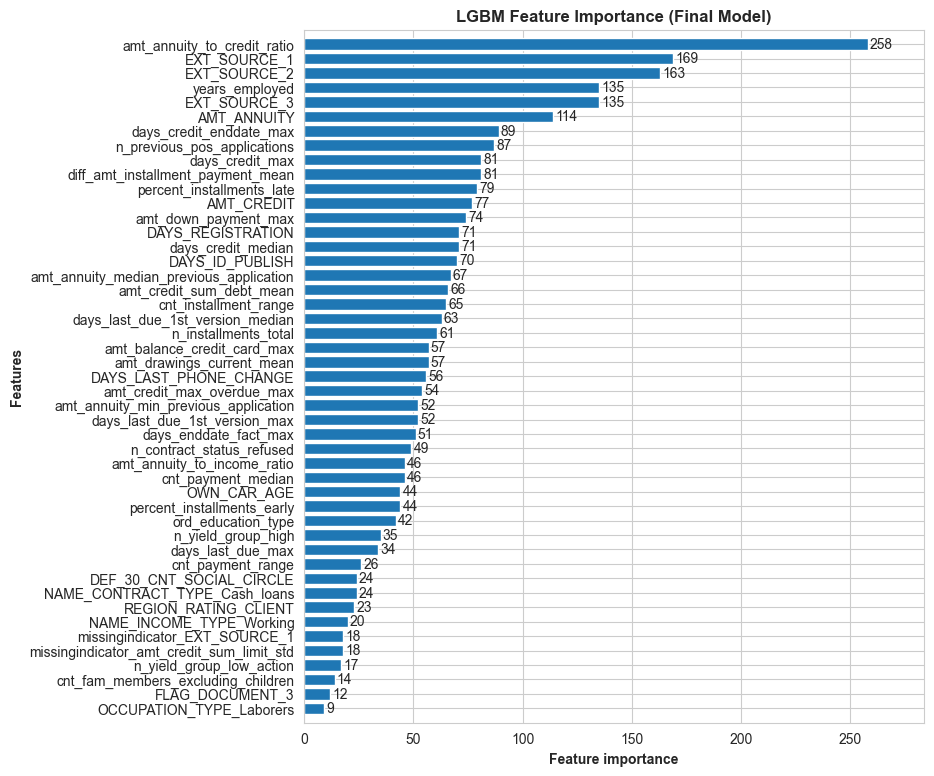

In [27]:
sns.set_style("whitegrid")
lgb.plot_importance(
    models_final_2["LGBM (47 feat. | final)"]["classifier"],
    max_num_features=50,
    figsize=(8, 9),
    height=0.8,
    title="LGBM Feature Importance (Final Model)",
);

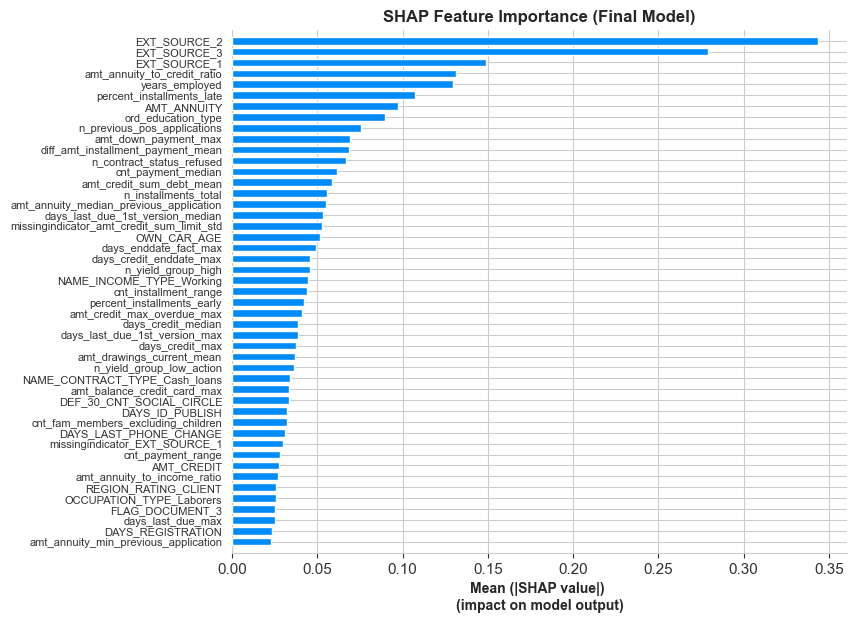

In [23]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_test_2[1],
    data_for_lgbm_test_2,
    plot_type="bar",
    max_display=50,
    plot_size=(10, 6),
    show=False,
)
plt.tick_params(axis="y", labelsize=8)
plt.title("SHAP Feature Importance (Final Model)", fontsize=12)
plt.xlabel("Mean (|SHAP value|) \n(impact on model output)", fontsize=10);

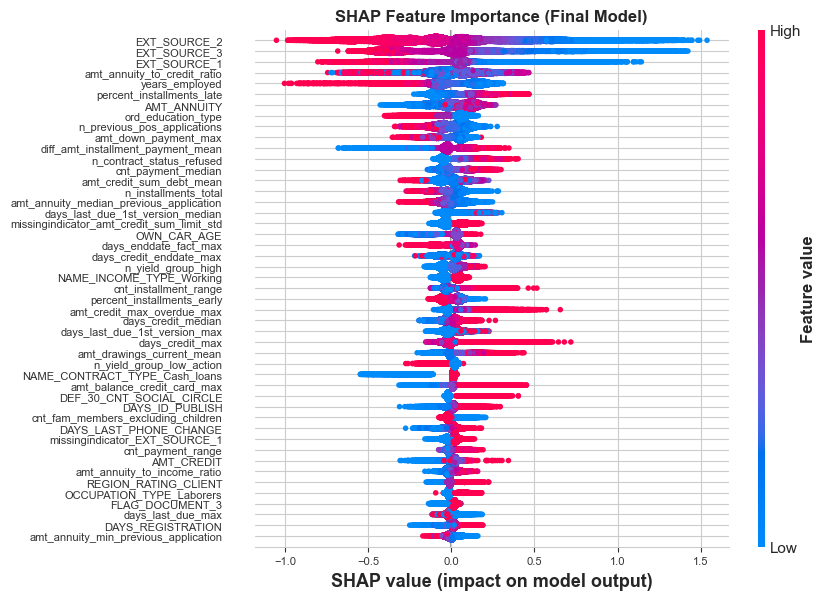

In [25]:
sns.set_style("whitegrid")
shap.summary_plot(
    shap_values_lgbm_test_2[1],
    data_for_lgbm_test_2,
    max_display=50,
    plot_size=(10, 6),
    show=False,
)
plt.title("SHAP Feature Importance (Final Model)", fontsize=12)
plt.tick_params(axis="y", labelsize=8)
plt.tick_params(axis="x", labelsize=8)

## Model for Deployment (w/ Historical Data) {#sec-model-for-deployment-2}

Merge all data to train the final model:

In [ ]:
# For deployment
X_credit_all = pd.concat([X_credit_train, X_credit_validation, X_credit_test], axis=0)
y_credit_all = pd.concat([y_credit_train, y_credit_validation, y_credit_test], axis=0)

pipeline_to_deploy_2 = clone(pipeline_final_2_with_47_feat)
pipeline_to_deploy_2 = pipeline_to_deploy_2.fit(X_credit_all, y_credit_all)

[LightGBM] [Info] Number of positive: 24825, number of negative: 282686
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 7851
[LightGBM] [Info] Number of data points in the train set: 307511, number of used features: 47
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce GTX 950M, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 34 dense feature groups (10.56 MB) transferred to GPU in 0.029807 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


For simplicity, the model will be deployed without pre-processing pipeline.

In [ ]:
# Extract and save classifier
classifier_to_deploy_2 = pipeline_to_deploy_2.named_steps["classifier"]

with open("models/classifier-2--with_credit_history.pickle", "wb") as f:
    joblib.dump(classifier_to_deploy_2, f)

<!--

# Make data to test deployment

classifier_to_deploy_2 = pipeline_to_deploy_2.named_steps["classifier"]

preproc = Pipeline(steps=pipeline_to_deploy_2.steps[:-1])
preproc.transform(X_credit_all.head(2)).to_dict(orient="list")

-->

# Final Remarks {#sec-final-remarks}

1) In binary classification, the default threshold of 0.5 was used.  
Threshold adjustment (e.g., via ROC curve analysis) might be beneficial.

1) Hyperparameter tuning was not efficient in this analysis. The issue of overfitting should be addressed by limiting model complexity. Unfortunately, there was not enough time to do this.

1) Only LGBM model was used. To try other architectures (e.g., logistic regression, Naive Bayes, or neural networks) might be beneficial too.

1) In some cases, more self-explanatory variable names could be used.

2) There is a lot of repeated code between the parts of modeling with and without historical data. This could be improved. Unfortunately, this would have required much more time.

3) Some results and lines of code could be described in more detail.

4) Not all functions from `functions` subfolder were used. They should be treated as a separate module.

5)  The `requirements.txt` file was created by using `pip freeze > requirements.txt` command. This is not the best way to create this file as there are more packages than it is needed.

6) A consultation with a field expert would be beneficial to understand the data better and to improve the model.